# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

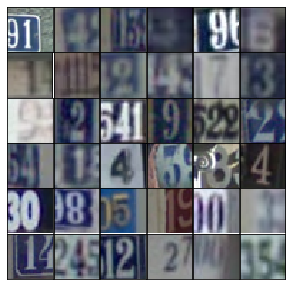

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [ ]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, [-1, 4, 4, 512])
        x1 = tf.maximum(alpha*x1, x1)
        # 4x4x512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha*x2, x2)
        # 8x8x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha*x3, x3)
        # 16x16x128

        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha*x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha*x2, x2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha*x3, x3)
        # 4x4x256
        
        flat = tf.reshape(x3, [-1, 4*4*256])        
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2346... Generator Loss: 0.8412
Epoch 1/25... Discriminator Loss: 0.7025... Generator Loss: 1.0775
Epoch 1/25... Discriminator Loss: 0.1938... Generator Loss: 2.2540
Epoch 1/25... Discriminator Loss: 0.1399... Generator Loss: 2.8375
Epoch 1/25... Discriminator Loss: 0.1639... Generator Loss: 2.5988
Epoch 1/25... Discriminator Loss: 0.0909... Generator Loss: 3.1918
Epoch 1/25... Discriminator Loss: 0.2705... Generator Loss: 2.0344
Epoch 1/25... Discriminator Loss: 1.1622... Generator Loss: 0.8634
Epoch 1/25... Discriminator Loss: 1.1892... Generator Loss: 0.6628
Epoch 1/25... Discriminator Loss: 0.7969... Generator Loss: 1.2868


/home/skywalker/.virtualenvs/py3ml/lib/python3.6/site-packages/matplotlib/axes/_base.py:1324: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


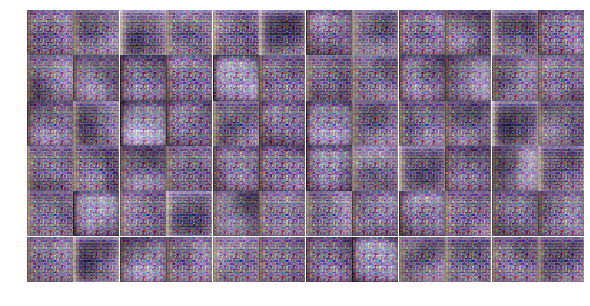

Epoch 1/25... Discriminator Loss: 0.6046... Generator Loss: 2.1470
Epoch 1/25... Discriminator Loss: 0.3866... Generator Loss: 1.9891
Epoch 1/25... Discriminator Loss: 0.4691... Generator Loss: 1.7122
Epoch 1/25... Discriminator Loss: 0.4030... Generator Loss: 1.6769
Epoch 1/25... Discriminator Loss: 0.5120... Generator Loss: 1.3802
Epoch 1/25... Discriminator Loss: 1.0550... Generator Loss: 0.6620
Epoch 1/25... Discriminator Loss: 0.4708... Generator Loss: 1.2630
Epoch 1/25... Discriminator Loss: 0.6348... Generator Loss: 3.0053
Epoch 1/25... Discriminator Loss: 1.1063... Generator Loss: 3.3966
Epoch 1/25... Discriminator Loss: 0.4596... Generator Loss: 3.3322


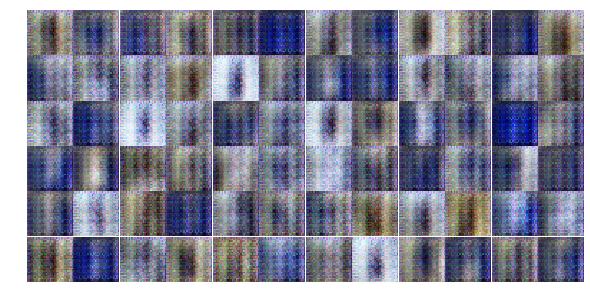

Epoch 1/25... Discriminator Loss: 2.0765... Generator Loss: 0.1695
Epoch 1/25... Discriminator Loss: 0.6216... Generator Loss: 3.8353
Epoch 1/25... Discriminator Loss: 0.8703... Generator Loss: 4.8956
Epoch 1/25... Discriminator Loss: 0.4368... Generator Loss: 1.5932
Epoch 1/25... Discriminator Loss: 0.1568... Generator Loss: 3.3318
Epoch 1/25... Discriminator Loss: 0.9053... Generator Loss: 1.7230
Epoch 1/25... Discriminator Loss: 0.9605... Generator Loss: 0.9907
Epoch 1/25... Discriminator Loss: 0.4268... Generator Loss: 1.9397
Epoch 1/25... Discriminator Loss: 1.2454... Generator Loss: 3.0633
Epoch 1/25... Discriminator Loss: 0.9078... Generator Loss: 1.4647


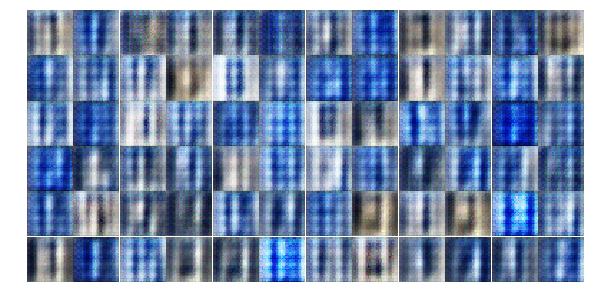

Epoch 1/25... Discriminator Loss: 0.8461... Generator Loss: 1.0698
Epoch 1/25... Discriminator Loss: 0.9321... Generator Loss: 1.0729
Epoch 1/25... Discriminator Loss: 0.4969... Generator Loss: 1.5895
Epoch 1/25... Discriminator Loss: 0.8276... Generator Loss: 1.1334
Epoch 1/25... Discriminator Loss: 0.6813... Generator Loss: 1.3052
Epoch 1/25... Discriminator Loss: 0.6678... Generator Loss: 1.3517
Epoch 1/25... Discriminator Loss: 0.5307... Generator Loss: 1.3704
Epoch 1/25... Discriminator Loss: 0.3822... Generator Loss: 2.3812
Epoch 1/25... Discriminator Loss: 0.3572... Generator Loss: 1.9836
Epoch 1/25... Discriminator Loss: 0.8524... Generator Loss: 1.3596


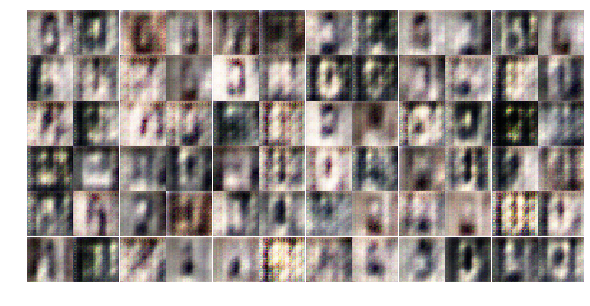

Epoch 1/25... Discriminator Loss: 1.1117... Generator Loss: 0.9514
Epoch 1/25... Discriminator Loss: 0.7954... Generator Loss: 1.3033
Epoch 1/25... Discriminator Loss: 0.8166... Generator Loss: 1.1202
Epoch 1/25... Discriminator Loss: 0.9689... Generator Loss: 0.9989
Epoch 1/25... Discriminator Loss: 1.0982... Generator Loss: 0.8169
Epoch 1/25... Discriminator Loss: 0.7226... Generator Loss: 1.3065
Epoch 1/25... Discriminator Loss: 0.6798... Generator Loss: 1.3470
Epoch 1/25... Discriminator Loss: 1.1480... Generator Loss: 0.8797
Epoch 1/25... Discriminator Loss: 0.9577... Generator Loss: 1.1061
Epoch 1/25... Discriminator Loss: 0.9179... Generator Loss: 0.9743


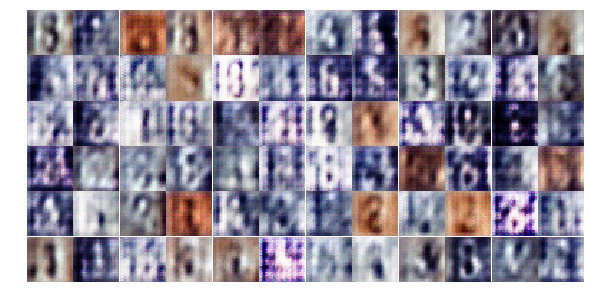

Epoch 1/25... Discriminator Loss: 0.7485... Generator Loss: 1.2534
Epoch 1/25... Discriminator Loss: 0.8275... Generator Loss: 1.0130
Epoch 1/25... Discriminator Loss: 0.6909... Generator Loss: 1.7406
Epoch 1/25... Discriminator Loss: 1.0417... Generator Loss: 1.0071
Epoch 1/25... Discriminator Loss: 0.9099... Generator Loss: 1.2828
Epoch 1/25... Discriminator Loss: 0.8054... Generator Loss: 1.4034
Epoch 1/25... Discriminator Loss: 1.1086... Generator Loss: 1.1533
Epoch 2/25... Discriminator Loss: 0.9991... Generator Loss: 1.2715
Epoch 2/25... Discriminator Loss: 0.4942... Generator Loss: 2.2804
Epoch 2/25... Discriminator Loss: 0.6991... Generator Loss: 1.2726


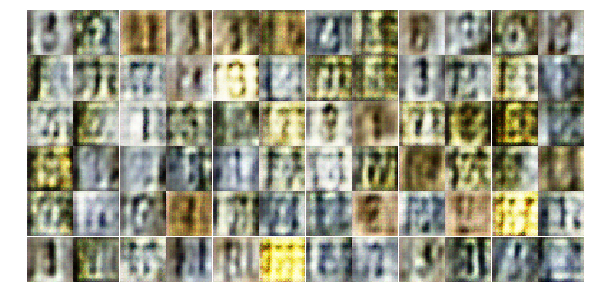

Epoch 2/25... Discriminator Loss: 0.6429... Generator Loss: 1.2499
Epoch 2/25... Discriminator Loss: 0.8796... Generator Loss: 0.9977
Epoch 2/25... Discriminator Loss: 0.9133... Generator Loss: 0.9296
Epoch 2/25... Discriminator Loss: 0.9607... Generator Loss: 1.1197
Epoch 2/25... Discriminator Loss: 0.9689... Generator Loss: 1.0970
Epoch 2/25... Discriminator Loss: 1.0523... Generator Loss: 0.9741
Epoch 2/25... Discriminator Loss: 0.8646... Generator Loss: 1.0708
Epoch 2/25... Discriminator Loss: 1.1360... Generator Loss: 1.0046
Epoch 2/25... Discriminator Loss: 1.0675... Generator Loss: 0.6905
Epoch 2/25... Discriminator Loss: 0.9403... Generator Loss: 1.1365


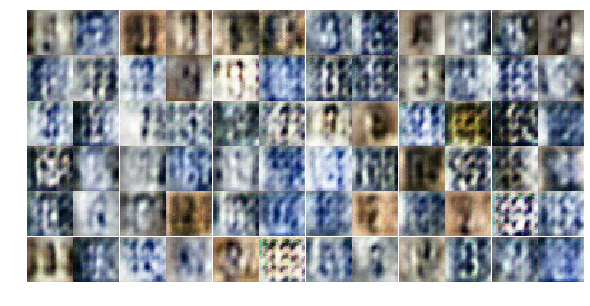

Epoch 2/25... Discriminator Loss: 0.8005... Generator Loss: 1.2567
Epoch 2/25... Discriminator Loss: 1.2294... Generator Loss: 0.6629
Epoch 2/25... Discriminator Loss: 0.8567... Generator Loss: 1.1371
Epoch 2/25... Discriminator Loss: 0.7461... Generator Loss: 1.3360
Epoch 2/25... Discriminator Loss: 0.9232... Generator Loss: 1.3133
Epoch 2/25... Discriminator Loss: 1.0840... Generator Loss: 1.4360
Epoch 2/25... Discriminator Loss: 1.3791... Generator Loss: 0.7424
Epoch 2/25... Discriminator Loss: 1.3559... Generator Loss: 0.5517
Epoch 2/25... Discriminator Loss: 1.2120... Generator Loss: 0.8996
Epoch 2/25... Discriminator Loss: 1.3627... Generator Loss: 0.6544


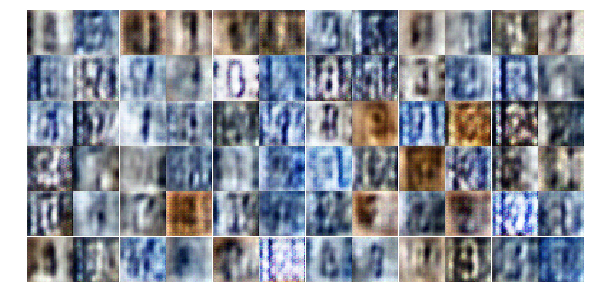

Epoch 2/25... Discriminator Loss: 1.1116... Generator Loss: 0.8209
Epoch 2/25... Discriminator Loss: 1.1112... Generator Loss: 1.0788
Epoch 2/25... Discriminator Loss: 1.0071... Generator Loss: 1.1468
Epoch 2/25... Discriminator Loss: 1.0766... Generator Loss: 0.9619
Epoch 2/25... Discriminator Loss: 1.0032... Generator Loss: 1.2180
Epoch 2/25... Discriminator Loss: 1.1059... Generator Loss: 0.7728
Epoch 2/25... Discriminator Loss: 1.1396... Generator Loss: 0.6730
Epoch 2/25... Discriminator Loss: 1.1828... Generator Loss: 0.7129
Epoch 2/25... Discriminator Loss: 1.1394... Generator Loss: 0.8889
Epoch 2/25... Discriminator Loss: 0.9213... Generator Loss: 1.4347


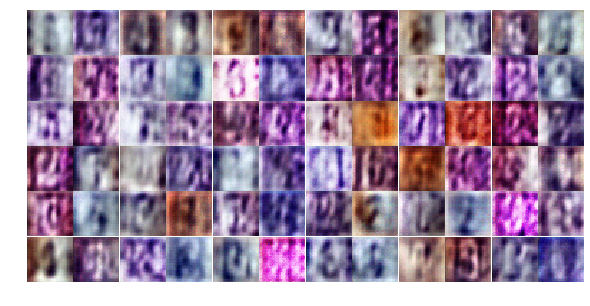

Epoch 2/25... Discriminator Loss: 1.1492... Generator Loss: 0.9650
Epoch 2/25... Discriminator Loss: 1.2470... Generator Loss: 0.7673
Epoch 2/25... Discriminator Loss: 1.3970... Generator Loss: 0.6661
Epoch 2/25... Discriminator Loss: 1.2235... Generator Loss: 0.7416
Epoch 2/25... Discriminator Loss: 0.9820... Generator Loss: 0.9734
Epoch 2/25... Discriminator Loss: 1.1150... Generator Loss: 0.9645
Epoch 2/25... Discriminator Loss: 1.3970... Generator Loss: 0.7571
Epoch 2/25... Discriminator Loss: 1.2578... Generator Loss: 0.8888
Epoch 2/25... Discriminator Loss: 1.1695... Generator Loss: 1.0158
Epoch 2/25... Discriminator Loss: 1.0652... Generator Loss: 1.0828


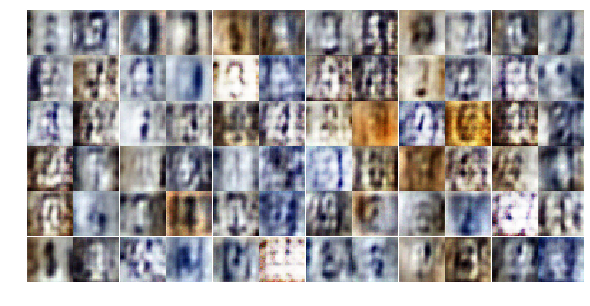

Epoch 2/25... Discriminator Loss: 0.9986... Generator Loss: 1.0120
Epoch 2/25... Discriminator Loss: 0.9372... Generator Loss: 1.3886
Epoch 2/25... Discriminator Loss: 1.1945... Generator Loss: 0.6812
Epoch 2/25... Discriminator Loss: 1.2610... Generator Loss: 0.6722
Epoch 2/25... Discriminator Loss: 1.0325... Generator Loss: 0.8462
Epoch 2/25... Discriminator Loss: 1.0277... Generator Loss: 0.8262
Epoch 2/25... Discriminator Loss: 1.3433... Generator Loss: 2.0768
Epoch 2/25... Discriminator Loss: 0.9485... Generator Loss: 1.5451
Epoch 2/25... Discriminator Loss: 0.9721... Generator Loss: 0.7869
Epoch 2/25... Discriminator Loss: 1.1326... Generator Loss: 0.7290


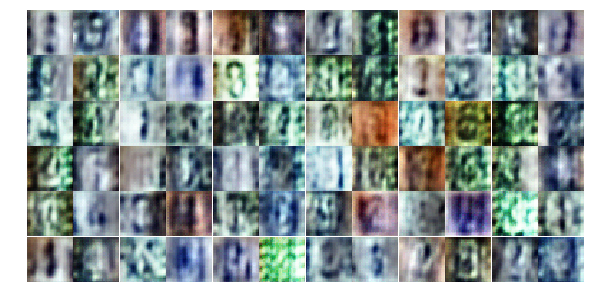

Epoch 2/25... Discriminator Loss: 1.0247... Generator Loss: 1.4314
Epoch 2/25... Discriminator Loss: 1.1359... Generator Loss: 0.8049
Epoch 2/25... Discriminator Loss: 1.3868... Generator Loss: 0.5004
Epoch 2/25... Discriminator Loss: 0.9759... Generator Loss: 0.8530
Epoch 3/25... Discriminator Loss: 1.1456... Generator Loss: 2.2311
Epoch 3/25... Discriminator Loss: 0.8248... Generator Loss: 1.3033
Epoch 3/25... Discriminator Loss: 0.8354... Generator Loss: 1.2383
Epoch 3/25... Discriminator Loss: 0.9724... Generator Loss: 1.0154
Epoch 3/25... Discriminator Loss: 0.7431... Generator Loss: 1.4918
Epoch 3/25... Discriminator Loss: 0.8426... Generator Loss: 1.2615


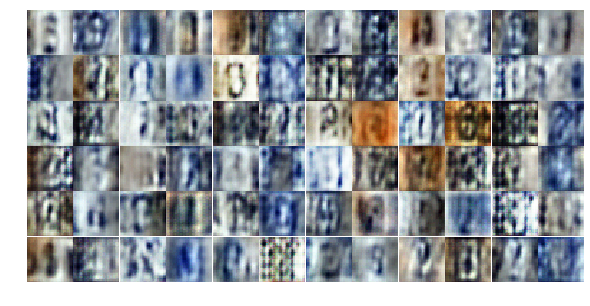

Epoch 3/25... Discriminator Loss: 0.6578... Generator Loss: 1.3823
Epoch 3/25... Discriminator Loss: 0.8614... Generator Loss: 1.2814
Epoch 3/25... Discriminator Loss: 0.6985... Generator Loss: 1.4160
Epoch 3/25... Discriminator Loss: 0.7269... Generator Loss: 1.3549
Epoch 3/25... Discriminator Loss: 0.6494... Generator Loss: 1.5813
Epoch 3/25... Discriminator Loss: 1.2532... Generator Loss: 0.4838
Epoch 3/25... Discriminator Loss: 0.8833... Generator Loss: 1.2457
Epoch 3/25... Discriminator Loss: 0.6316... Generator Loss: 1.4022
Epoch 3/25... Discriminator Loss: 0.7373... Generator Loss: 0.9798
Epoch 3/25... Discriminator Loss: 1.0293... Generator Loss: 0.6797


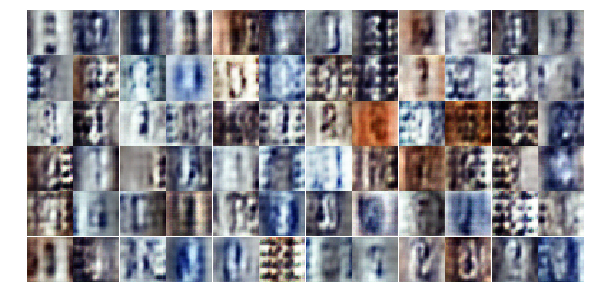

Epoch 3/25... Discriminator Loss: 0.7640... Generator Loss: 1.3320
Epoch 3/25... Discriminator Loss: 0.7881... Generator Loss: 1.0693
Epoch 3/25... Discriminator Loss: 0.8507... Generator Loss: 0.9377
Epoch 3/25... Discriminator Loss: 0.7789... Generator Loss: 1.5308
Epoch 3/25... Discriminator Loss: 0.6961... Generator Loss: 1.1311
Epoch 3/25... Discriminator Loss: 0.3672... Generator Loss: 2.6267
Epoch 3/25... Discriminator Loss: 0.4892... Generator Loss: 1.7241
Epoch 3/25... Discriminator Loss: 0.5602... Generator Loss: 1.5401
Epoch 3/25... Discriminator Loss: 0.4707... Generator Loss: 1.7498
Epoch 3/25... Discriminator Loss: 1.4971... Generator Loss: 0.3364


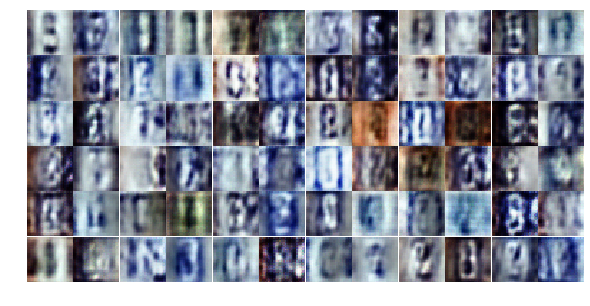

Epoch 3/25... Discriminator Loss: 0.8634... Generator Loss: 1.1231
Epoch 3/25... Discriminator Loss: 0.9310... Generator Loss: 1.2732
Epoch 3/25... Discriminator Loss: 0.8443... Generator Loss: 1.4847
Epoch 3/25... Discriminator Loss: 0.4695... Generator Loss: 1.4230
Epoch 3/25... Discriminator Loss: 1.1746... Generator Loss: 0.5135
Epoch 3/25... Discriminator Loss: 1.2204... Generator Loss: 0.5557
Epoch 3/25... Discriminator Loss: 0.7698... Generator Loss: 1.0871
Epoch 3/25... Discriminator Loss: 0.6713... Generator Loss: 1.4983
Epoch 3/25... Discriminator Loss: 0.6676... Generator Loss: 1.5497
Epoch 3/25... Discriminator Loss: 0.5445... Generator Loss: 1.3574


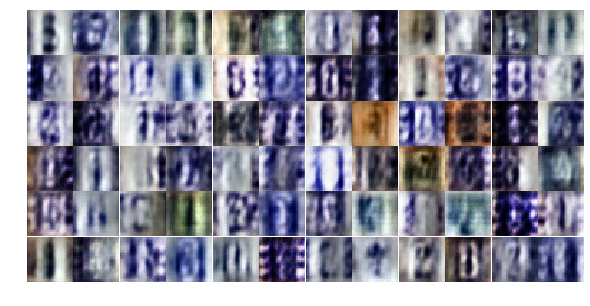

Epoch 3/25... Discriminator Loss: 0.5206... Generator Loss: 1.8702
Epoch 3/25... Discriminator Loss: 0.4726... Generator Loss: 1.6952
Epoch 3/25... Discriminator Loss: 1.2519... Generator Loss: 3.1020
Epoch 3/25... Discriminator Loss: 0.9865... Generator Loss: 0.7422
Epoch 3/25... Discriminator Loss: 0.6364... Generator Loss: 1.1995
Epoch 3/25... Discriminator Loss: 0.5108... Generator Loss: 1.4522
Epoch 3/25... Discriminator Loss: 0.6575... Generator Loss: 1.2549
Epoch 3/25... Discriminator Loss: 0.5538... Generator Loss: 2.3249
Epoch 3/25... Discriminator Loss: 0.5250... Generator Loss: 2.4910
Epoch 3/25... Discriminator Loss: 0.8664... Generator Loss: 0.9687


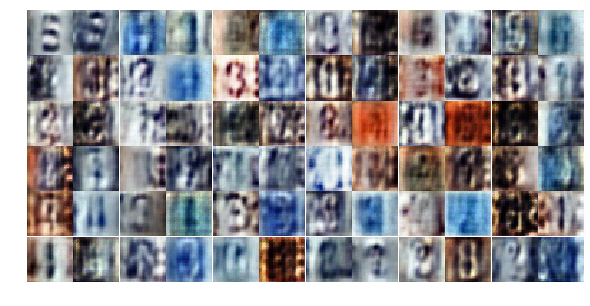

Epoch 3/25... Discriminator Loss: 1.0784... Generator Loss: 0.5885
Epoch 3/25... Discriminator Loss: 1.0691... Generator Loss: 0.6528
Epoch 3/25... Discriminator Loss: 0.8835... Generator Loss: 0.8394
Epoch 3/25... Discriminator Loss: 0.4063... Generator Loss: 2.3481
Epoch 3/25... Discriminator Loss: 0.9262... Generator Loss: 1.1455
Epoch 3/25... Discriminator Loss: 0.5471... Generator Loss: 1.3895
Epoch 3/25... Discriminator Loss: 0.5425... Generator Loss: 1.5685
Epoch 3/25... Discriminator Loss: 0.5697... Generator Loss: 1.5708
Epoch 3/25... Discriminator Loss: 0.5768... Generator Loss: 2.3653
Epoch 3/25... Discriminator Loss: 0.5946... Generator Loss: 1.3913


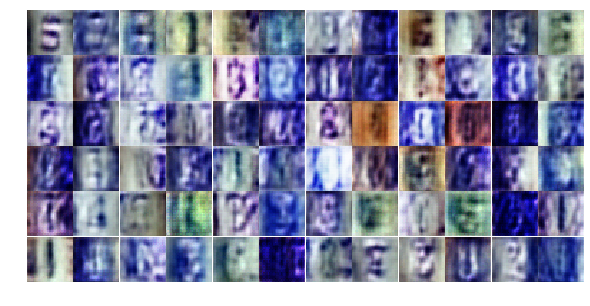

Epoch 3/25... Discriminator Loss: 1.0903... Generator Loss: 1.0504
Epoch 4/25... Discriminator Loss: 0.7863... Generator Loss: 1.4949
Epoch 4/25... Discriminator Loss: 0.8645... Generator Loss: 1.5074
Epoch 4/25... Discriminator Loss: 0.7859... Generator Loss: 1.0950
Epoch 4/25... Discriminator Loss: 0.5977... Generator Loss: 1.7628
Epoch 4/25... Discriminator Loss: 0.5969... Generator Loss: 1.3058
Epoch 4/25... Discriminator Loss: 0.5712... Generator Loss: 1.9180
Epoch 4/25... Discriminator Loss: 0.6337... Generator Loss: 1.2788
Epoch 4/25... Discriminator Loss: 0.4101... Generator Loss: 2.2984
Epoch 4/25... Discriminator Loss: 0.9209... Generator Loss: 0.7908


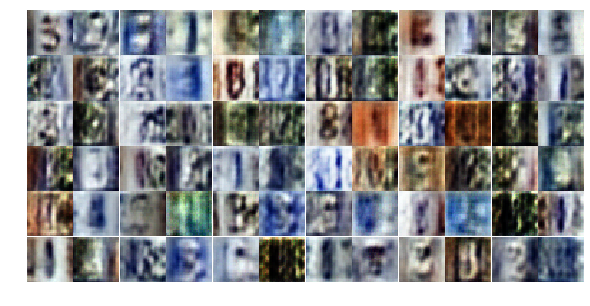

Epoch 4/25... Discriminator Loss: 0.6995... Generator Loss: 1.5632
Epoch 4/25... Discriminator Loss: 0.6312... Generator Loss: 1.3290
Epoch 4/25... Discriminator Loss: 1.0656... Generator Loss: 0.6842
Epoch 4/25... Discriminator Loss: 0.4656... Generator Loss: 1.8659
Epoch 4/25... Discriminator Loss: 1.3011... Generator Loss: 2.3965
Epoch 4/25... Discriminator Loss: 1.1277... Generator Loss: 0.5584
Epoch 4/25... Discriminator Loss: 1.2426... Generator Loss: 0.6142
Epoch 4/25... Discriminator Loss: 1.1156... Generator Loss: 0.8320
Epoch 4/25... Discriminator Loss: 0.8149... Generator Loss: 0.8583
Epoch 4/25... Discriminator Loss: 0.6413... Generator Loss: 1.3719


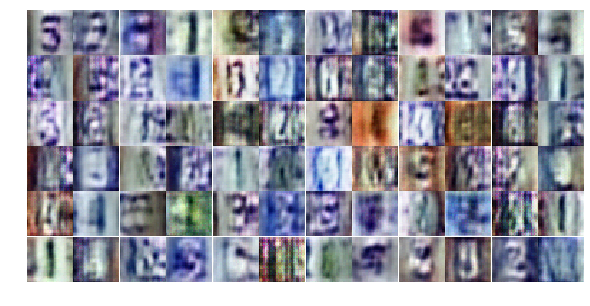

Epoch 4/25... Discriminator Loss: 0.5984... Generator Loss: 1.7611
Epoch 4/25... Discriminator Loss: 0.6196... Generator Loss: 1.4101
Epoch 4/25... Discriminator Loss: 0.9726... Generator Loss: 2.3903
Epoch 4/25... Discriminator Loss: 0.7242... Generator Loss: 1.2829
Epoch 4/25... Discriminator Loss: 0.4273... Generator Loss: 2.3386
Epoch 4/25... Discriminator Loss: 1.0920... Generator Loss: 3.6827
Epoch 4/25... Discriminator Loss: 0.6757... Generator Loss: 1.0369
Epoch 4/25... Discriminator Loss: 0.8770... Generator Loss: 0.8141
Epoch 4/25... Discriminator Loss: 0.5788... Generator Loss: 1.9932
Epoch 4/25... Discriminator Loss: 0.7929... Generator Loss: 0.8346


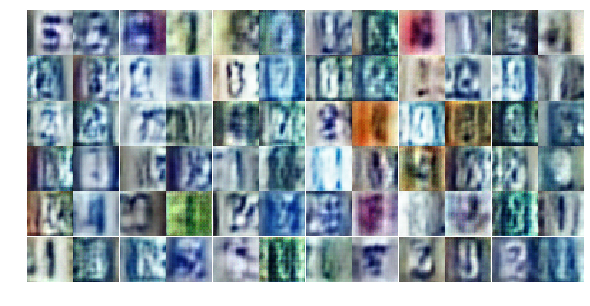

Epoch 4/25... Discriminator Loss: 0.4630... Generator Loss: 3.7647
Epoch 4/25... Discriminator Loss: 1.0123... Generator Loss: 3.6219
Epoch 4/25... Discriminator Loss: 0.8709... Generator Loss: 0.9117
Epoch 4/25... Discriminator Loss: 0.5666... Generator Loss: 2.0481
Epoch 4/25... Discriminator Loss: 0.3720... Generator Loss: 2.2237
Epoch 4/25... Discriminator Loss: 0.3972... Generator Loss: 2.6241
Epoch 4/25... Discriminator Loss: 0.7324... Generator Loss: 1.0982
Epoch 4/25... Discriminator Loss: 0.8014... Generator Loss: 1.0003
Epoch 4/25... Discriminator Loss: 0.9760... Generator Loss: 0.6485
Epoch 4/25... Discriminator Loss: 1.6423... Generator Loss: 0.3317


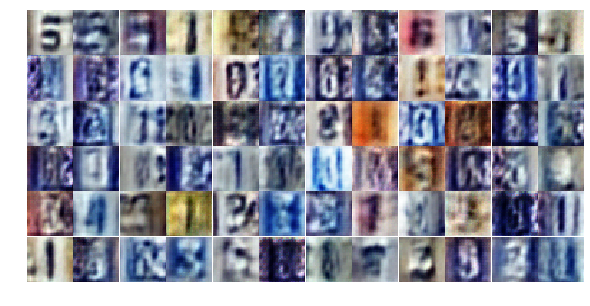

Epoch 4/25... Discriminator Loss: 0.9852... Generator Loss: 0.7049
Epoch 4/25... Discriminator Loss: 0.5847... Generator Loss: 2.0169
Epoch 4/25... Discriminator Loss: 0.7206... Generator Loss: 1.1057
Epoch 4/25... Discriminator Loss: 0.5550... Generator Loss: 1.3639
Epoch 4/25... Discriminator Loss: 0.6850... Generator Loss: 1.0358
Epoch 4/25... Discriminator Loss: 0.5707... Generator Loss: 1.4187
Epoch 4/25... Discriminator Loss: 0.3445... Generator Loss: 2.8018
Epoch 4/25... Discriminator Loss: 0.5118... Generator Loss: 1.6895
Epoch 4/25... Discriminator Loss: 0.6030... Generator Loss: 1.9988
Epoch 4/25... Discriminator Loss: 0.8874... Generator Loss: 1.2392


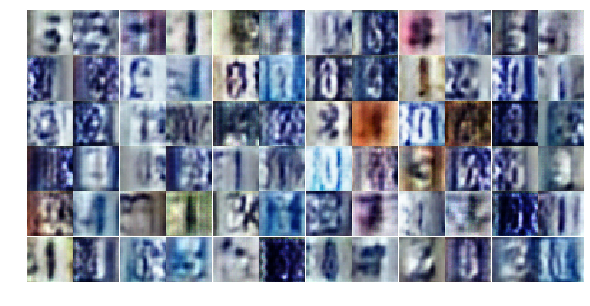

Epoch 4/25... Discriminator Loss: 1.1670... Generator Loss: 0.5687
Epoch 4/25... Discriminator Loss: 0.4857... Generator Loss: 1.9691
Epoch 4/25... Discriminator Loss: 0.5017... Generator Loss: 1.4617
Epoch 4/25... Discriminator Loss: 0.5281... Generator Loss: 1.4106
Epoch 4/25... Discriminator Loss: 0.5788... Generator Loss: 1.2763
Epoch 4/25... Discriminator Loss: 0.9039... Generator Loss: 1.1418
Epoch 4/25... Discriminator Loss: 0.2617... Generator Loss: 2.4851
Epoch 4/25... Discriminator Loss: 0.3454... Generator Loss: 1.8339
Epoch 4/25... Discriminator Loss: 0.6388... Generator Loss: 1.3155
Epoch 5/25... Discriminator Loss: 0.4662... Generator Loss: 1.7105


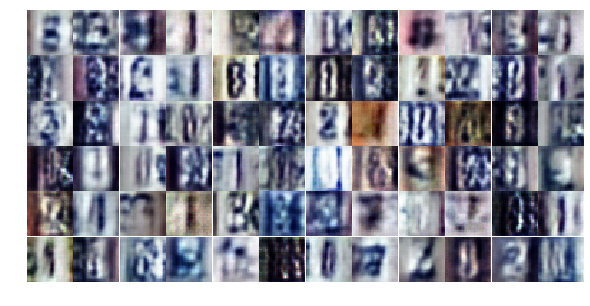

Epoch 5/25... Discriminator Loss: 0.5692... Generator Loss: 1.3437
Epoch 5/25... Discriminator Loss: 0.4630... Generator Loss: 1.7167
Epoch 5/25... Discriminator Loss: 1.0142... Generator Loss: 0.6317
Epoch 5/25... Discriminator Loss: 0.4639... Generator Loss: 1.4278
Epoch 5/25... Discriminator Loss: 0.3117... Generator Loss: 2.3979
Epoch 5/25... Discriminator Loss: 0.5127... Generator Loss: 1.4780
Epoch 5/25... Discriminator Loss: 0.2638... Generator Loss: 2.1573
Epoch 5/25... Discriminator Loss: 0.4409... Generator Loss: 1.7723
Epoch 5/25... Discriminator Loss: 0.8307... Generator Loss: 0.9716
Epoch 5/25... Discriminator Loss: 0.7418... Generator Loss: 1.1536


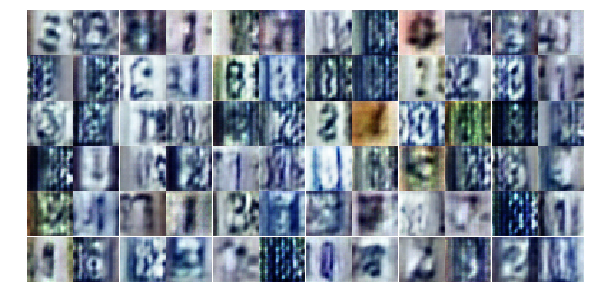

Epoch 5/25... Discriminator Loss: 0.6714... Generator Loss: 1.7006
Epoch 5/25... Discriminator Loss: 0.3932... Generator Loss: 1.7058
Epoch 5/25... Discriminator Loss: 0.5893... Generator Loss: 1.1742
Epoch 5/25... Discriminator Loss: 0.8584... Generator Loss: 0.7726
Epoch 5/25... Discriminator Loss: 1.2594... Generator Loss: 3.8337
Epoch 5/25... Discriminator Loss: 0.7859... Generator Loss: 1.0182
Epoch 5/25... Discriminator Loss: 0.6921... Generator Loss: 1.1419
Epoch 5/25... Discriminator Loss: 0.6267... Generator Loss: 1.2778
Epoch 5/25... Discriminator Loss: 0.3558... Generator Loss: 1.7977
Epoch 5/25... Discriminator Loss: 0.7124... Generator Loss: 1.0866


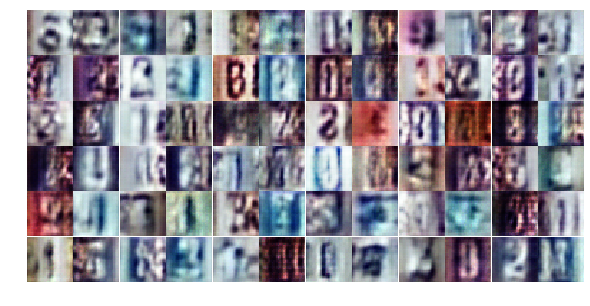

Epoch 5/25... Discriminator Loss: 0.5317... Generator Loss: 1.3952
Epoch 5/25... Discriminator Loss: 0.6885... Generator Loss: 1.6117
Epoch 5/25... Discriminator Loss: 0.5106... Generator Loss: 1.6221
Epoch 5/25... Discriminator Loss: 0.6040... Generator Loss: 1.1606
Epoch 5/25... Discriminator Loss: 0.4955... Generator Loss: 1.5272
Epoch 5/25... Discriminator Loss: 0.8464... Generator Loss: 2.2162
Epoch 5/25... Discriminator Loss: 0.8379... Generator Loss: 1.7081
Epoch 5/25... Discriminator Loss: 0.5045... Generator Loss: 1.9320
Epoch 5/25... Discriminator Loss: 0.8183... Generator Loss: 0.8566
Epoch 5/25... Discriminator Loss: 0.4599... Generator Loss: 1.5711


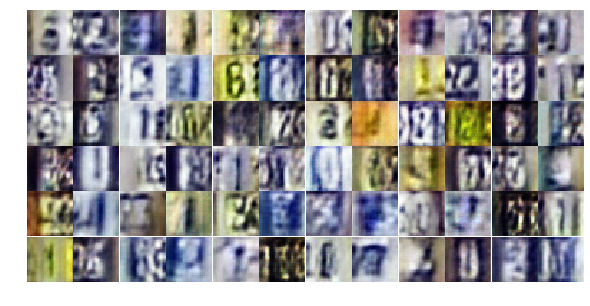

Epoch 5/25... Discriminator Loss: 0.6433... Generator Loss: 1.2087
Epoch 5/25... Discriminator Loss: 0.4587... Generator Loss: 1.6794
Epoch 5/25... Discriminator Loss: 0.4863... Generator Loss: 1.5119
Epoch 5/25... Discriminator Loss: 0.4387... Generator Loss: 1.7736
Epoch 5/25... Discriminator Loss: 0.5332... Generator Loss: 2.4390
Epoch 5/25... Discriminator Loss: 0.7840... Generator Loss: 3.1402
Epoch 5/25... Discriminator Loss: 0.8685... Generator Loss: 0.7911
Epoch 5/25... Discriminator Loss: 0.5930... Generator Loss: 1.1476
Epoch 5/25... Discriminator Loss: 0.7369... Generator Loss: 0.9293
Epoch 5/25... Discriminator Loss: 0.8023... Generator Loss: 0.8487


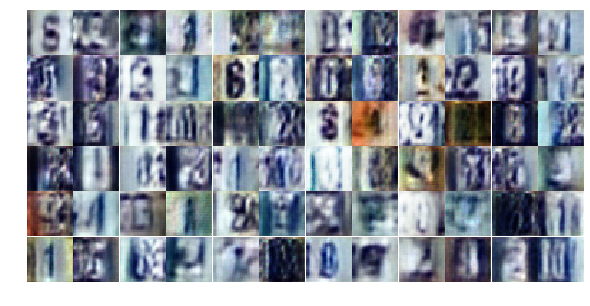

Epoch 5/25... Discriminator Loss: 0.4773... Generator Loss: 1.6979
Epoch 5/25... Discriminator Loss: 0.5700... Generator Loss: 1.3488
Epoch 5/25... Discriminator Loss: 0.6640... Generator Loss: 1.0902
Epoch 5/25... Discriminator Loss: 0.3840... Generator Loss: 2.0817
Epoch 5/25... Discriminator Loss: 2.1185... Generator Loss: 2.8083
Epoch 5/25... Discriminator Loss: 0.7308... Generator Loss: 1.2215
Epoch 5/25... Discriminator Loss: 0.7124... Generator Loss: 1.1349
Epoch 5/25... Discriminator Loss: 0.5332... Generator Loss: 1.8761
Epoch 5/25... Discriminator Loss: 0.6793... Generator Loss: 1.1789
Epoch 5/25... Discriminator Loss: 0.6182... Generator Loss: 1.2134


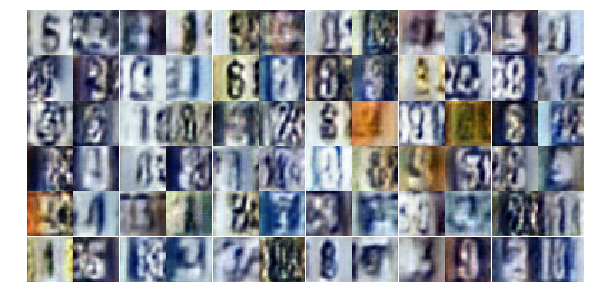

Epoch 5/25... Discriminator Loss: 1.1396... Generator Loss: 0.5298
Epoch 5/25... Discriminator Loss: 0.7364... Generator Loss: 1.0006
Epoch 5/25... Discriminator Loss: 0.9505... Generator Loss: 0.6805
Epoch 5/25... Discriminator Loss: 0.5042... Generator Loss: 1.3375
Epoch 5/25... Discriminator Loss: 0.6645... Generator Loss: 1.0323
Epoch 5/25... Discriminator Loss: 0.9753... Generator Loss: 0.7992
Epoch 6/25... Discriminator Loss: 0.7003... Generator Loss: 1.0045
Epoch 6/25... Discriminator Loss: 0.4592... Generator Loss: 1.2905
Epoch 6/25... Discriminator Loss: 1.6433... Generator Loss: 0.4346
Epoch 6/25... Discriminator Loss: 1.3084... Generator Loss: 0.4543


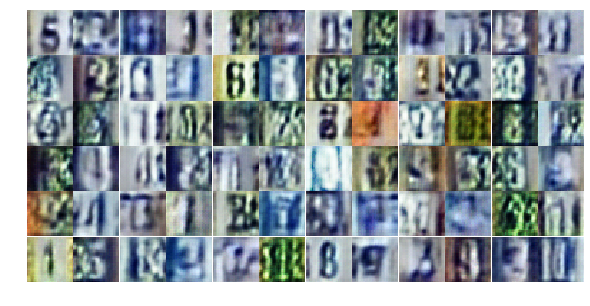

Epoch 6/25... Discriminator Loss: 0.6530... Generator Loss: 1.2496
Epoch 6/25... Discriminator Loss: 0.6580... Generator Loss: 1.5338
Epoch 6/25... Discriminator Loss: 0.8561... Generator Loss: 0.8070
Epoch 6/25... Discriminator Loss: 1.2018... Generator Loss: 0.5546
Epoch 6/25... Discriminator Loss: 0.7866... Generator Loss: 0.9063
Epoch 6/25... Discriminator Loss: 0.3445... Generator Loss: 1.7278
Epoch 6/25... Discriminator Loss: 0.5249... Generator Loss: 1.5505
Epoch 6/25... Discriminator Loss: 1.6342... Generator Loss: 0.3021
Epoch 6/25... Discriminator Loss: 0.8639... Generator Loss: 0.7247
Epoch 6/25... Discriminator Loss: 0.6928... Generator Loss: 1.0973


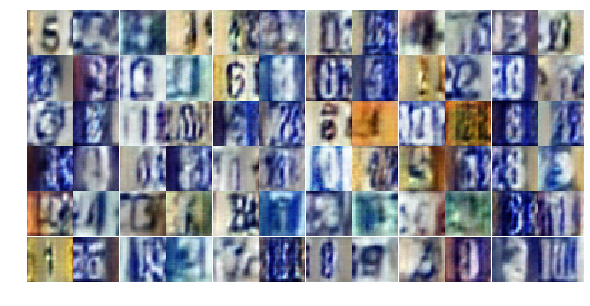

Epoch 6/25... Discriminator Loss: 0.5662... Generator Loss: 1.5665
Epoch 6/25... Discriminator Loss: 1.1690... Generator Loss: 0.5574
Epoch 6/25... Discriminator Loss: 0.9661... Generator Loss: 0.6965
Epoch 6/25... Discriminator Loss: 0.4716... Generator Loss: 1.3943
Epoch 6/25... Discriminator Loss: 0.5529... Generator Loss: 1.3391
Epoch 6/25... Discriminator Loss: 0.4718... Generator Loss: 1.5143
Epoch 6/25... Discriminator Loss: 0.6203... Generator Loss: 1.4204
Epoch 6/25... Discriminator Loss: 0.7021... Generator Loss: 1.0283
Epoch 6/25... Discriminator Loss: 0.5666... Generator Loss: 1.6351
Epoch 6/25... Discriminator Loss: 1.0616... Generator Loss: 0.7215


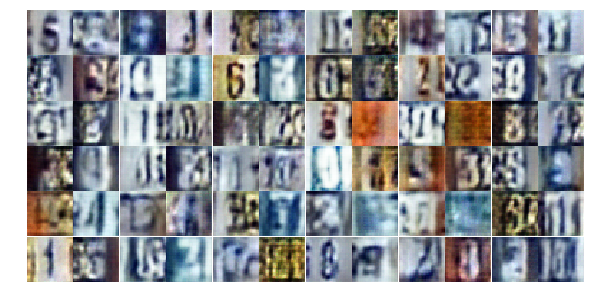

Epoch 6/25... Discriminator Loss: 0.9103... Generator Loss: 0.7108
Epoch 6/25... Discriminator Loss: 0.8398... Generator Loss: 0.7908
Epoch 6/25... Discriminator Loss: 1.1924... Generator Loss: 0.5557
Epoch 6/25... Discriminator Loss: 0.8351... Generator Loss: 1.0696
Epoch 6/25... Discriminator Loss: 0.6216... Generator Loss: 1.8748
Epoch 6/25... Discriminator Loss: 1.1685... Generator Loss: 0.6019
Epoch 6/25... Discriminator Loss: 0.9905... Generator Loss: 0.6770
Epoch 6/25... Discriminator Loss: 0.4037... Generator Loss: 1.5095
Epoch 6/25... Discriminator Loss: 0.5229... Generator Loss: 1.5304
Epoch 6/25... Discriminator Loss: 0.3760... Generator Loss: 1.8480


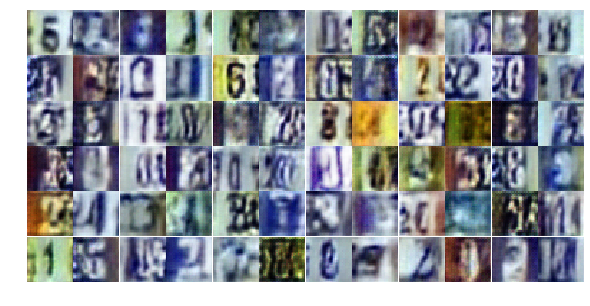

Epoch 6/25... Discriminator Loss: 0.8536... Generator Loss: 0.8577
Epoch 6/25... Discriminator Loss: 0.6773... Generator Loss: 1.4523
Epoch 6/25... Discriminator Loss: 0.7624... Generator Loss: 0.8818
Epoch 6/25... Discriminator Loss: 0.7291... Generator Loss: 0.9684
Epoch 6/25... Discriminator Loss: 0.5390... Generator Loss: 1.3315
Epoch 6/25... Discriminator Loss: 0.6811... Generator Loss: 1.0182
Epoch 6/25... Discriminator Loss: 0.5918... Generator Loss: 1.4590
Epoch 6/25... Discriminator Loss: 0.6238... Generator Loss: 1.0728
Epoch 6/25... Discriminator Loss: 0.6745... Generator Loss: 1.9812
Epoch 6/25... Discriminator Loss: 0.4854... Generator Loss: 1.2859


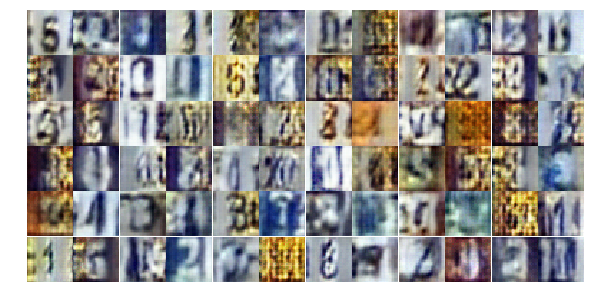

Epoch 6/25... Discriminator Loss: 0.6864... Generator Loss: 1.1722
Epoch 6/25... Discriminator Loss: 1.4414... Generator Loss: 0.3742
Epoch 6/25... Discriminator Loss: 0.9768... Generator Loss: 0.8083
Epoch 6/25... Discriminator Loss: 0.6598... Generator Loss: 1.2707
Epoch 6/25... Discriminator Loss: 0.5426... Generator Loss: 1.6483
Epoch 6/25... Discriminator Loss: 0.5631... Generator Loss: 1.2547
Epoch 6/25... Discriminator Loss: 1.1872... Generator Loss: 0.5115
Epoch 6/25... Discriminator Loss: 1.1902... Generator Loss: 0.4902
Epoch 6/25... Discriminator Loss: 0.8120... Generator Loss: 0.8743
Epoch 6/25... Discriminator Loss: 1.5634... Generator Loss: 0.3310


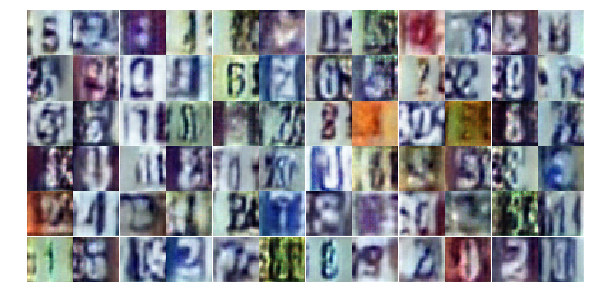

Epoch 6/25... Discriminator Loss: 0.6352... Generator Loss: 2.1517
Epoch 6/25... Discriminator Loss: 0.7421... Generator Loss: 0.9362
Epoch 6/25... Discriminator Loss: 0.5991... Generator Loss: 1.4207
Epoch 7/25... Discriminator Loss: 0.6537... Generator Loss: 1.0848
Epoch 7/25... Discriminator Loss: 0.6444... Generator Loss: 1.5073
Epoch 7/25... Discriminator Loss: 0.6239... Generator Loss: 1.0532
Epoch 7/25... Discriminator Loss: 0.9558... Generator Loss: 0.6402
Epoch 7/25... Discriminator Loss: 0.5830... Generator Loss: 1.3895
Epoch 7/25... Discriminator Loss: 0.6162... Generator Loss: 1.1056
Epoch 7/25... Discriminator Loss: 0.9159... Generator Loss: 0.7434


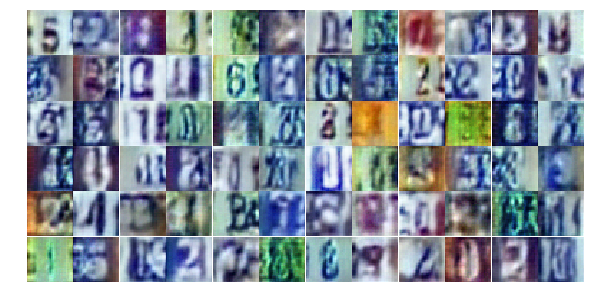

Epoch 7/25... Discriminator Loss: 0.6007... Generator Loss: 1.2489
Epoch 7/25... Discriminator Loss: 0.8934... Generator Loss: 0.7249
Epoch 7/25... Discriminator Loss: 0.9306... Generator Loss: 0.7574
Epoch 7/25... Discriminator Loss: 0.8744... Generator Loss: 2.1010
Epoch 7/25... Discriminator Loss: 0.6138... Generator Loss: 1.0433
Epoch 7/25... Discriminator Loss: 0.6078... Generator Loss: 1.0626
Epoch 7/25... Discriminator Loss: 0.7800... Generator Loss: 2.0058
Epoch 7/25... Discriminator Loss: 1.1167... Generator Loss: 2.9783
Epoch 7/25... Discriminator Loss: 1.5515... Generator Loss: 3.7990
Epoch 7/25... Discriminator Loss: 0.9176... Generator Loss: 0.7464


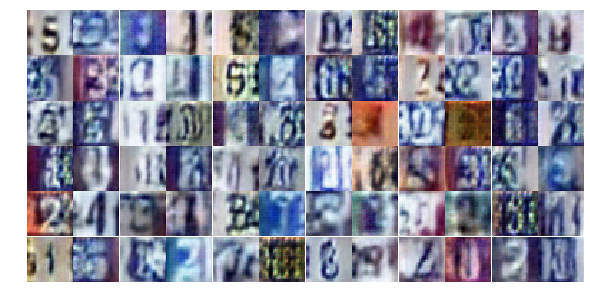

Epoch 7/25... Discriminator Loss: 0.5107... Generator Loss: 1.6197
Epoch 7/25... Discriminator Loss: 0.4246... Generator Loss: 1.5548
Epoch 7/25... Discriminator Loss: 0.6455... Generator Loss: 1.2946
Epoch 7/25... Discriminator Loss: 0.9166... Generator Loss: 0.7806
Epoch 7/25... Discriminator Loss: 0.6439... Generator Loss: 1.2511
Epoch 7/25... Discriminator Loss: 0.4346... Generator Loss: 1.6247
Epoch 7/25... Discriminator Loss: 0.5979... Generator Loss: 1.2144
Epoch 7/25... Discriminator Loss: 1.1712... Generator Loss: 0.6307
Epoch 7/25... Discriminator Loss: 0.7298... Generator Loss: 0.9807
Epoch 7/25... Discriminator Loss: 0.7618... Generator Loss: 3.0705


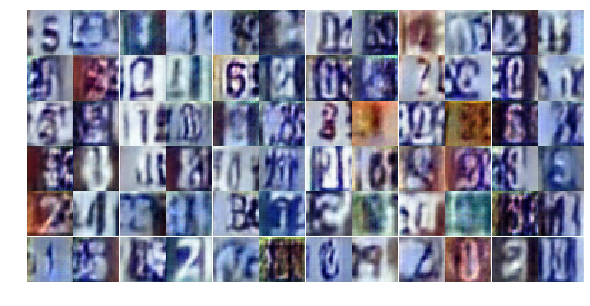

Epoch 7/25... Discriminator Loss: 1.0195... Generator Loss: 0.6108
Epoch 7/25... Discriminator Loss: 0.6760... Generator Loss: 1.5226
Epoch 7/25... Discriminator Loss: 0.9100... Generator Loss: 1.2984
Epoch 7/25... Discriminator Loss: 0.8254... Generator Loss: 0.9429
Epoch 7/25... Discriminator Loss: 0.8550... Generator Loss: 0.7450
Epoch 7/25... Discriminator Loss: 0.8305... Generator Loss: 0.9296
Epoch 7/25... Discriminator Loss: 0.5737... Generator Loss: 1.4619
Epoch 7/25... Discriminator Loss: 0.8328... Generator Loss: 0.9757
Epoch 7/25... Discriminator Loss: 1.0403... Generator Loss: 0.6018
Epoch 7/25... Discriminator Loss: 0.6019... Generator Loss: 2.1665


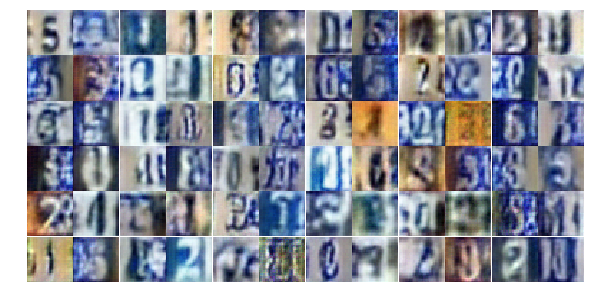

Epoch 7/25... Discriminator Loss: 0.9493... Generator Loss: 0.7838
Epoch 7/25... Discriminator Loss: 0.5494... Generator Loss: 1.4745
Epoch 7/25... Discriminator Loss: 0.4399... Generator Loss: 2.1473
Epoch 7/25... Discriminator Loss: 1.1546... Generator Loss: 0.5189
Epoch 7/25... Discriminator Loss: 0.6278... Generator Loss: 1.2654
Epoch 7/25... Discriminator Loss: 0.5496... Generator Loss: 1.2614
Epoch 7/25... Discriminator Loss: 0.5302... Generator Loss: 1.2940
Epoch 7/25... Discriminator Loss: 0.9169... Generator Loss: 0.7544
Epoch 7/25... Discriminator Loss: 0.3144... Generator Loss: 2.1562
Epoch 7/25... Discriminator Loss: 0.9127... Generator Loss: 1.0550


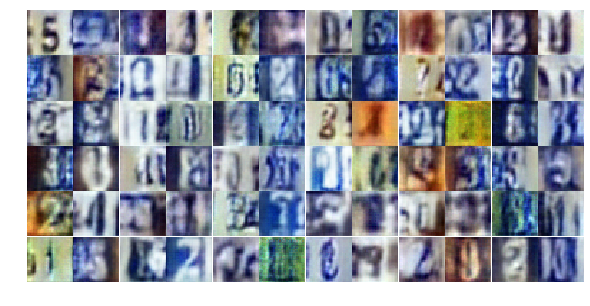

Epoch 7/25... Discriminator Loss: 0.3987... Generator Loss: 2.3237
Epoch 7/25... Discriminator Loss: 0.9187... Generator Loss: 1.0676
Epoch 7/25... Discriminator Loss: 0.7957... Generator Loss: 1.0631
Epoch 7/25... Discriminator Loss: 0.8416... Generator Loss: 0.7363
Epoch 7/25... Discriminator Loss: 0.6751... Generator Loss: 1.3741
Epoch 7/25... Discriminator Loss: 0.8344... Generator Loss: 0.9011
Epoch 7/25... Discriminator Loss: 1.1885... Generator Loss: 0.4896
Epoch 7/25... Discriminator Loss: 0.6733... Generator Loss: 2.0103
Epoch 7/25... Discriminator Loss: 0.5470... Generator Loss: 1.5382
Epoch 7/25... Discriminator Loss: 0.4787... Generator Loss: 1.5112


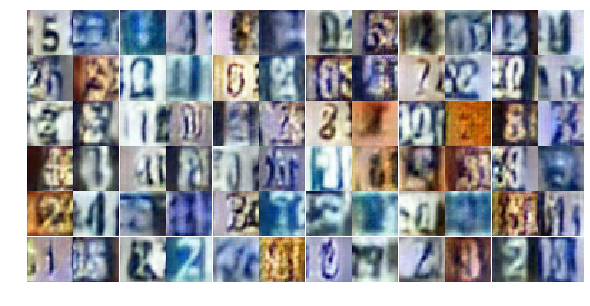

Epoch 7/25... Discriminator Loss: 0.7224... Generator Loss: 1.3276
Epoch 8/25... Discriminator Loss: 1.1867... Generator Loss: 0.5188
Epoch 8/25... Discriminator Loss: 0.6626... Generator Loss: 0.9560
Epoch 8/25... Discriminator Loss: 0.6773... Generator Loss: 1.0000
Epoch 8/25... Discriminator Loss: 0.6111... Generator Loss: 1.2071
Epoch 8/25... Discriminator Loss: 0.9751... Generator Loss: 0.6437
Epoch 8/25... Discriminator Loss: 0.6315... Generator Loss: 1.1481
Epoch 8/25... Discriminator Loss: 0.7033... Generator Loss: 2.2714
Epoch 8/25... Discriminator Loss: 0.7795... Generator Loss: 1.0148
Epoch 8/25... Discriminator Loss: 0.7916... Generator Loss: 0.8399


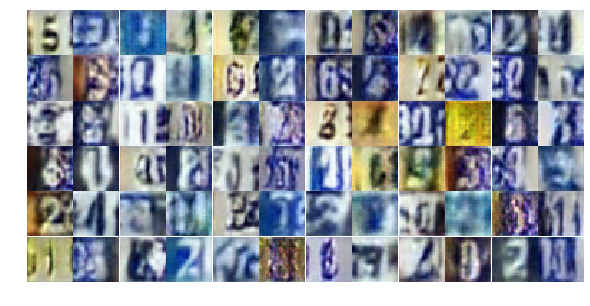

Epoch 8/25... Discriminator Loss: 0.4939... Generator Loss: 1.6558
Epoch 8/25... Discriminator Loss: 0.5324... Generator Loss: 1.5076
Epoch 8/25... Discriminator Loss: 0.5589... Generator Loss: 1.5437
Epoch 8/25... Discriminator Loss: 0.4136... Generator Loss: 1.8008
Epoch 8/25... Discriminator Loss: 1.0740... Generator Loss: 0.6747
Epoch 8/25... Discriminator Loss: 0.9475... Generator Loss: 1.3092
Epoch 8/25... Discriminator Loss: 0.6184... Generator Loss: 1.1394
Epoch 8/25... Discriminator Loss: 0.6943... Generator Loss: 1.2227
Epoch 8/25... Discriminator Loss: 0.6902... Generator Loss: 1.1113
Epoch 8/25... Discriminator Loss: 1.3449... Generator Loss: 0.4270


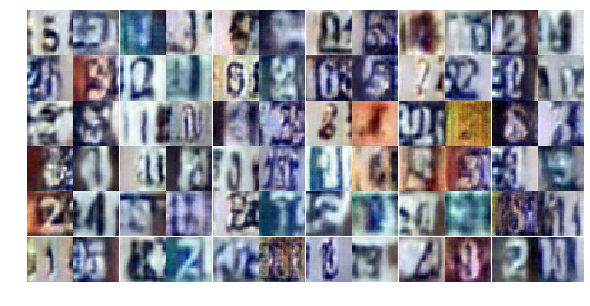

Epoch 8/25... Discriminator Loss: 0.5406... Generator Loss: 1.5564
Epoch 8/25... Discriminator Loss: 0.5905... Generator Loss: 1.1580
Epoch 8/25... Discriminator Loss: 0.7898... Generator Loss: 0.9081
Epoch 8/25... Discriminator Loss: 0.6395... Generator Loss: 1.3747
Epoch 8/25... Discriminator Loss: 0.4918... Generator Loss: 1.7076
Epoch 8/25... Discriminator Loss: 0.7803... Generator Loss: 0.9034
Epoch 8/25... Discriminator Loss: 0.6584... Generator Loss: 1.4715
Epoch 8/25... Discriminator Loss: 0.5082... Generator Loss: 1.7272
Epoch 8/25... Discriminator Loss: 0.8443... Generator Loss: 1.9602
Epoch 8/25... Discriminator Loss: 1.2357... Generator Loss: 1.0248


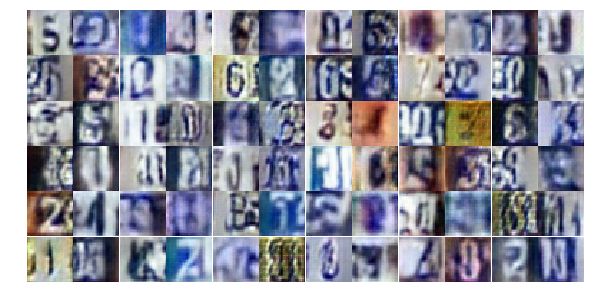

Epoch 8/25... Discriminator Loss: 0.8003... Generator Loss: 0.9649
Epoch 8/25... Discriminator Loss: 1.2194... Generator Loss: 0.5044
Epoch 8/25... Discriminator Loss: 0.7316... Generator Loss: 0.9700
Epoch 8/25... Discriminator Loss: 0.9017... Generator Loss: 0.6844
Epoch 8/25... Discriminator Loss: 0.8449... Generator Loss: 0.7533
Epoch 8/25... Discriminator Loss: 0.5840... Generator Loss: 1.1726
Epoch 8/25... Discriminator Loss: 0.7613... Generator Loss: 1.1413
Epoch 8/25... Discriminator Loss: 0.5880... Generator Loss: 1.4503
Epoch 8/25... Discriminator Loss: 0.7961... Generator Loss: 1.0469
Epoch 8/25... Discriminator Loss: 0.5503... Generator Loss: 1.2243


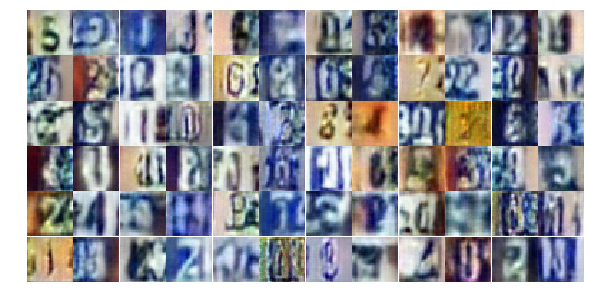

Epoch 8/25... Discriminator Loss: 0.4951... Generator Loss: 2.0452
Epoch 8/25... Discriminator Loss: 0.8619... Generator Loss: 0.8358
Epoch 8/25... Discriminator Loss: 0.9131... Generator Loss: 0.6769
Epoch 8/25... Discriminator Loss: 0.6753... Generator Loss: 1.1330
Epoch 8/25... Discriminator Loss: 1.5112... Generator Loss: 2.6925
Epoch 8/25... Discriminator Loss: 1.0503... Generator Loss: 0.5910
Epoch 8/25... Discriminator Loss: 0.3505... Generator Loss: 1.7732
Epoch 8/25... Discriminator Loss: 0.4864... Generator Loss: 1.5685
Epoch 8/25... Discriminator Loss: 0.5678... Generator Loss: 1.5642
Epoch 8/25... Discriminator Loss: 0.8448... Generator Loss: 1.5918


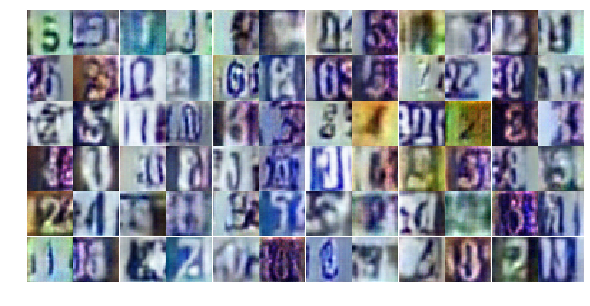

Epoch 8/25... Discriminator Loss: 0.6918... Generator Loss: 0.9452
Epoch 8/25... Discriminator Loss: 0.8763... Generator Loss: 0.7393
Epoch 8/25... Discriminator Loss: 0.6439... Generator Loss: 1.2613
Epoch 8/25... Discriminator Loss: 0.7721... Generator Loss: 0.8203
Epoch 8/25... Discriminator Loss: 0.3742... Generator Loss: 2.5598
Epoch 8/25... Discriminator Loss: 1.2401... Generator Loss: 0.4575
Epoch 8/25... Discriminator Loss: 0.6816... Generator Loss: 1.1858
Epoch 8/25... Discriminator Loss: 0.6185... Generator Loss: 1.3987
Epoch 9/25... Discriminator Loss: 0.8231... Generator Loss: 0.8269
Epoch 9/25... Discriminator Loss: 0.8630... Generator Loss: 0.7872


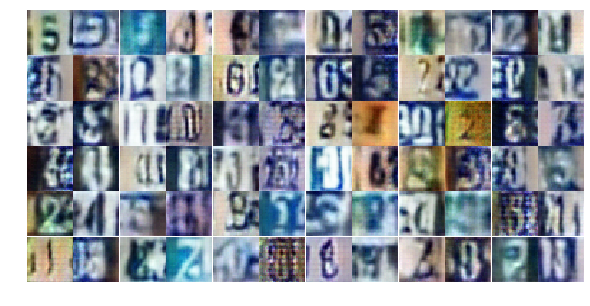

Epoch 9/25... Discriminator Loss: 0.8325... Generator Loss: 0.7861
Epoch 9/25... Discriminator Loss: 0.6818... Generator Loss: 0.9995
Epoch 9/25... Discriminator Loss: 1.3201... Generator Loss: 0.4276
Epoch 9/25... Discriminator Loss: 0.4523... Generator Loss: 1.6527
Epoch 9/25... Discriminator Loss: 0.8969... Generator Loss: 0.7208
Epoch 9/25... Discriminator Loss: 0.8673... Generator Loss: 3.4734
Epoch 9/25... Discriminator Loss: 0.8617... Generator Loss: 0.8342
Epoch 9/25... Discriminator Loss: 0.6432... Generator Loss: 1.0694
Epoch 9/25... Discriminator Loss: 0.8108... Generator Loss: 0.8850
Epoch 9/25... Discriminator Loss: 0.6629... Generator Loss: 1.1161


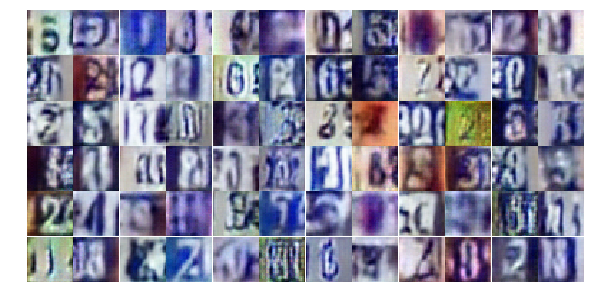

Epoch 9/25... Discriminator Loss: 0.7934... Generator Loss: 0.8716
Epoch 9/25... Discriminator Loss: 0.8342... Generator Loss: 1.0886
Epoch 9/25... Discriminator Loss: 0.7295... Generator Loss: 1.1836
Epoch 9/25... Discriminator Loss: 1.0093... Generator Loss: 0.6455
Epoch 9/25... Discriminator Loss: 0.5224... Generator Loss: 1.4018
Epoch 9/25... Discriminator Loss: 0.8258... Generator Loss: 0.9830
Epoch 9/25... Discriminator Loss: 1.3708... Generator Loss: 0.4182
Epoch 9/25... Discriminator Loss: 0.8916... Generator Loss: 0.7515
Epoch 9/25... Discriminator Loss: 1.1004... Generator Loss: 0.6024
Epoch 9/25... Discriminator Loss: 1.1230... Generator Loss: 0.4993


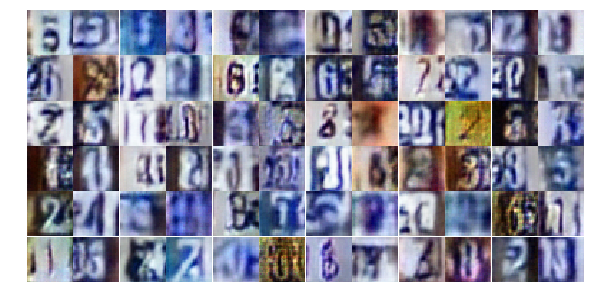

Epoch 9/25... Discriminator Loss: 1.1005... Generator Loss: 0.5519
Epoch 9/25... Discriminator Loss: 0.9600... Generator Loss: 0.7166
Epoch 9/25... Discriminator Loss: 0.6239... Generator Loss: 1.0656
Epoch 9/25... Discriminator Loss: 0.8295... Generator Loss: 0.9531
Epoch 9/25... Discriminator Loss: 0.8042... Generator Loss: 1.6447
Epoch 9/25... Discriminator Loss: 0.5958... Generator Loss: 1.3627
Epoch 9/25... Discriminator Loss: 0.7875... Generator Loss: 0.9175
Epoch 9/25... Discriminator Loss: 0.6097... Generator Loss: 1.4054
Epoch 9/25... Discriminator Loss: 0.6318... Generator Loss: 0.9923
Epoch 9/25... Discriminator Loss: 0.8017... Generator Loss: 0.8295


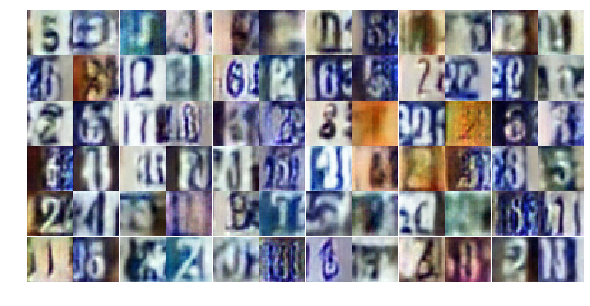

Epoch 9/25... Discriminator Loss: 0.6321... Generator Loss: 0.9908
Epoch 9/25... Discriminator Loss: 0.9746... Generator Loss: 0.6488
Epoch 9/25... Discriminator Loss: 0.7275... Generator Loss: 0.8601
Epoch 9/25... Discriminator Loss: 0.9576... Generator Loss: 0.6955
Epoch 9/25... Discriminator Loss: 0.7010... Generator Loss: 1.5574
Epoch 9/25... Discriminator Loss: 1.1237... Generator Loss: 0.6117
Epoch 9/25... Discriminator Loss: 0.6383... Generator Loss: 1.1073
Epoch 9/25... Discriminator Loss: 0.3441... Generator Loss: 1.9173
Epoch 9/25... Discriminator Loss: 1.4712... Generator Loss: 0.4027
Epoch 9/25... Discriminator Loss: 1.1872... Generator Loss: 0.5205


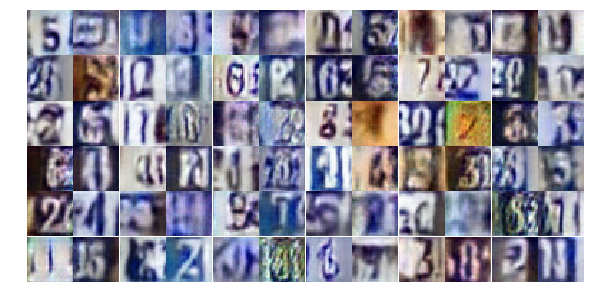

Epoch 9/25... Discriminator Loss: 0.8766... Generator Loss: 0.8878
Epoch 9/25... Discriminator Loss: 0.6247... Generator Loss: 1.2264
Epoch 9/25... Discriminator Loss: 1.5152... Generator Loss: 0.3410
Epoch 9/25... Discriminator Loss: 1.0844... Generator Loss: 0.8059
Epoch 9/25... Discriminator Loss: 0.5328... Generator Loss: 1.4295
Epoch 9/25... Discriminator Loss: 0.9842... Generator Loss: 0.6530
Epoch 9/25... Discriminator Loss: 0.6074... Generator Loss: 1.3121
Epoch 9/25... Discriminator Loss: 1.0496... Generator Loss: 0.5689
Epoch 9/25... Discriminator Loss: 0.7683... Generator Loss: 0.9701
Epoch 9/25... Discriminator Loss: 0.7666... Generator Loss: 2.3199


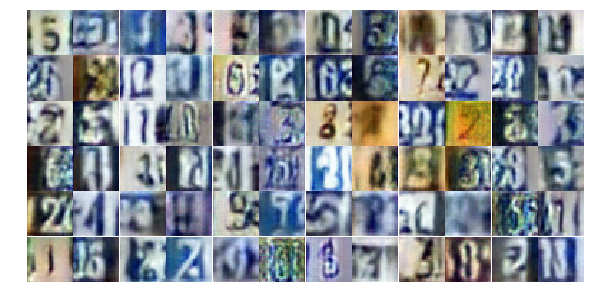

Epoch 9/25... Discriminator Loss: 0.7508... Generator Loss: 0.9069
Epoch 9/25... Discriminator Loss: 1.0792... Generator Loss: 2.2437
Epoch 9/25... Discriminator Loss: 0.7131... Generator Loss: 1.0362
Epoch 9/25... Discriminator Loss: 1.5063... Generator Loss: 0.3374
Epoch 9/25... Discriminator Loss: 0.6914... Generator Loss: 1.0688
Epoch 10/25... Discriminator Loss: 0.5391... Generator Loss: 1.1316
Epoch 10/25... Discriminator Loss: 0.7038... Generator Loss: 1.1162
Epoch 10/25... Discriminator Loss: 0.8483... Generator Loss: 0.7265
Epoch 10/25... Discriminator Loss: 0.7757... Generator Loss: 0.9914
Epoch 10/25... Discriminator Loss: 1.5051... Generator Loss: 0.3335


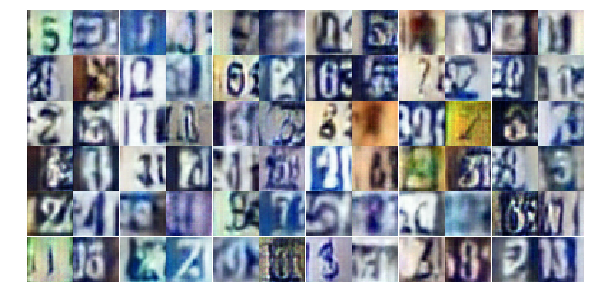

Epoch 10/25... Discriminator Loss: 1.3960... Generator Loss: 0.4285
Epoch 10/25... Discriminator Loss: 0.6512... Generator Loss: 3.2258
Epoch 10/25... Discriminator Loss: 1.0696... Generator Loss: 0.6319
Epoch 10/25... Discriminator Loss: 0.8309... Generator Loss: 0.8322
Epoch 10/25... Discriminator Loss: 0.7118... Generator Loss: 1.2117
Epoch 10/25... Discriminator Loss: 0.6487... Generator Loss: 1.3361
Epoch 10/25... Discriminator Loss: 0.5637... Generator Loss: 1.1766
Epoch 10/25... Discriminator Loss: 0.9687... Generator Loss: 0.5957
Epoch 10/25... Discriminator Loss: 0.8818... Generator Loss: 0.8470
Epoch 10/25... Discriminator Loss: 0.8428... Generator Loss: 0.8277


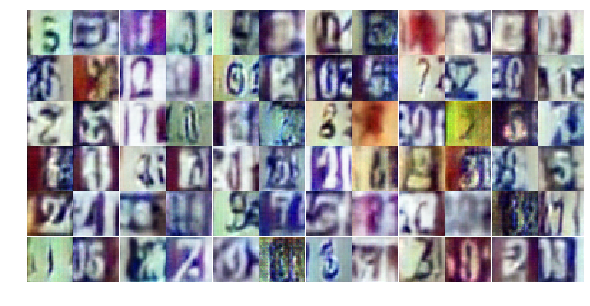

Epoch 10/25... Discriminator Loss: 0.6566... Generator Loss: 1.3856
Epoch 10/25... Discriminator Loss: 1.2261... Generator Loss: 0.4642
Epoch 10/25... Discriminator Loss: 0.8315... Generator Loss: 1.8686
Epoch 10/25... Discriminator Loss: 1.7502... Generator Loss: 0.2933
Epoch 10/25... Discriminator Loss: 0.7602... Generator Loss: 0.9446
Epoch 10/25... Discriminator Loss: 0.6989... Generator Loss: 0.9866
Epoch 10/25... Discriminator Loss: 0.7615... Generator Loss: 0.9180
Epoch 10/25... Discriminator Loss: 0.6803... Generator Loss: 0.9712
Epoch 10/25... Discriminator Loss: 0.6637... Generator Loss: 1.0344
Epoch 10/25... Discriminator Loss: 0.6508... Generator Loss: 2.2804


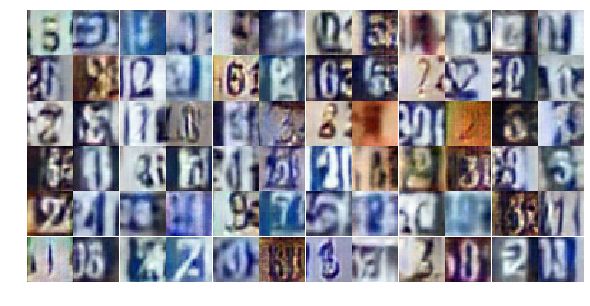

Epoch 10/25... Discriminator Loss: 1.2758... Generator Loss: 0.4684
Epoch 10/25... Discriminator Loss: 0.9753... Generator Loss: 0.7209
Epoch 10/25... Discriminator Loss: 0.4290... Generator Loss: 1.8513
Epoch 10/25... Discriminator Loss: 0.7206... Generator Loss: 1.4680
Epoch 10/25... Discriminator Loss: 1.5633... Generator Loss: 0.3582
Epoch 10/25... Discriminator Loss: 0.8097... Generator Loss: 0.9671
Epoch 10/25... Discriminator Loss: 0.4683... Generator Loss: 1.5079
Epoch 10/25... Discriminator Loss: 0.8203... Generator Loss: 1.0556
Epoch 10/25... Discriminator Loss: 0.8394... Generator Loss: 0.7646
Epoch 10/25... Discriminator Loss: 0.8440... Generator Loss: 0.7596


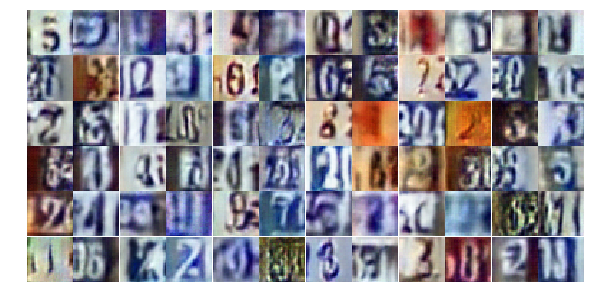

Epoch 10/25... Discriminator Loss: 0.7319... Generator Loss: 1.2122
Epoch 10/25... Discriminator Loss: 0.7239... Generator Loss: 1.1219
Epoch 10/25... Discriminator Loss: 0.6275... Generator Loss: 2.1592
Epoch 10/25... Discriminator Loss: 0.4582... Generator Loss: 1.7120
Epoch 10/25... Discriminator Loss: 0.9744... Generator Loss: 0.6821
Epoch 10/25... Discriminator Loss: 0.7211... Generator Loss: 1.1402
Epoch 10/25... Discriminator Loss: 0.8412... Generator Loss: 0.8259
Epoch 10/25... Discriminator Loss: 1.1742... Generator Loss: 0.5635
Epoch 10/25... Discriminator Loss: 0.4726... Generator Loss: 1.3997
Epoch 10/25... Discriminator Loss: 0.6830... Generator Loss: 1.0243


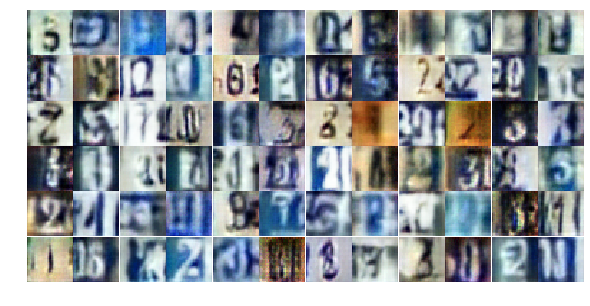

Epoch 10/25... Discriminator Loss: 0.5315... Generator Loss: 1.2885
Epoch 10/25... Discriminator Loss: 0.6691... Generator Loss: 1.2480
Epoch 10/25... Discriminator Loss: 0.9298... Generator Loss: 0.7282
Epoch 10/25... Discriminator Loss: 1.2206... Generator Loss: 0.4725
Epoch 10/25... Discriminator Loss: 0.6841... Generator Loss: 1.3057
Epoch 10/25... Discriminator Loss: 0.8284... Generator Loss: 2.4629
Epoch 10/25... Discriminator Loss: 0.7055... Generator Loss: 1.0915
Epoch 10/25... Discriminator Loss: 0.6466... Generator Loss: 1.2838
Epoch 10/25... Discriminator Loss: 0.8037... Generator Loss: 2.3214
Epoch 10/25... Discriminator Loss: 0.6712... Generator Loss: 1.0106


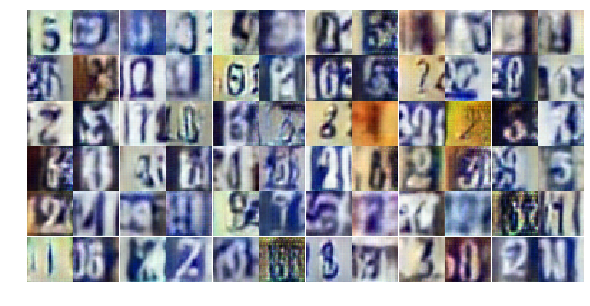

Epoch 10/25... Discriminator Loss: 0.8571... Generator Loss: 1.9434
Epoch 10/25... Discriminator Loss: 0.5417... Generator Loss: 1.4437
Epoch 10/25... Discriminator Loss: 0.8491... Generator Loss: 0.8323
Epoch 11/25... Discriminator Loss: 1.1249... Generator Loss: 0.6002
Epoch 11/25... Discriminator Loss: 0.5905... Generator Loss: 1.6314
Epoch 11/25... Discriminator Loss: 1.5329... Generator Loss: 0.3209
Epoch 11/25... Discriminator Loss: 1.0260... Generator Loss: 0.6198
Epoch 11/25... Discriminator Loss: 1.1507... Generator Loss: 0.5737
Epoch 11/25... Discriminator Loss: 1.9123... Generator Loss: 0.2785
Epoch 11/25... Discriminator Loss: 0.5825... Generator Loss: 1.2754


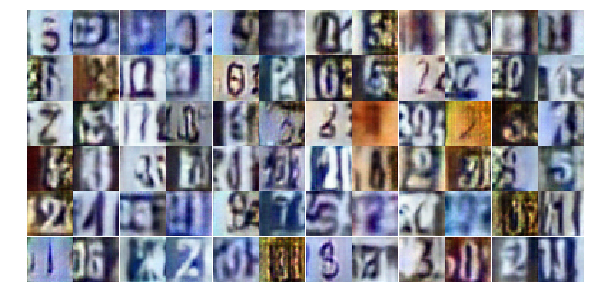

Epoch 11/25... Discriminator Loss: 0.5240... Generator Loss: 1.7357
Epoch 11/25... Discriminator Loss: 0.6147... Generator Loss: 1.5117
Epoch 11/25... Discriminator Loss: 0.4466... Generator Loss: 1.6682
Epoch 11/25... Discriminator Loss: 0.6221... Generator Loss: 1.2766
Epoch 11/25... Discriminator Loss: 1.2433... Generator Loss: 0.4937
Epoch 11/25... Discriminator Loss: 0.5061... Generator Loss: 1.4838
Epoch 11/25... Discriminator Loss: 0.7296... Generator Loss: 1.2503
Epoch 11/25... Discriminator Loss: 0.3963... Generator Loss: 1.7973
Epoch 11/25... Discriminator Loss: 0.6797... Generator Loss: 1.0837
Epoch 11/25... Discriminator Loss: 2.0062... Generator Loss: 3.6193


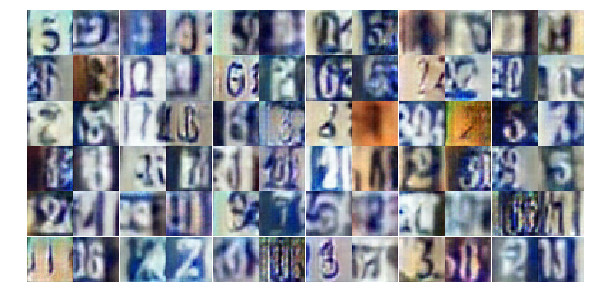

Epoch 11/25... Discriminator Loss: 1.5057... Generator Loss: 0.3286
Epoch 11/25... Discriminator Loss: 0.6616... Generator Loss: 1.3580
Epoch 11/25... Discriminator Loss: 0.8048... Generator Loss: 0.8126
Epoch 11/25... Discriminator Loss: 0.7251... Generator Loss: 0.8883
Epoch 11/25... Discriminator Loss: 0.5608... Generator Loss: 1.2974
Epoch 11/25... Discriminator Loss: 0.5421... Generator Loss: 1.3246
Epoch 11/25... Discriminator Loss: 0.5614... Generator Loss: 1.1435
Epoch 11/25... Discriminator Loss: 2.1399... Generator Loss: 0.1661
Epoch 11/25... Discriminator Loss: 0.4090... Generator Loss: 1.8837
Epoch 11/25... Discriminator Loss: 0.9342... Generator Loss: 0.7172


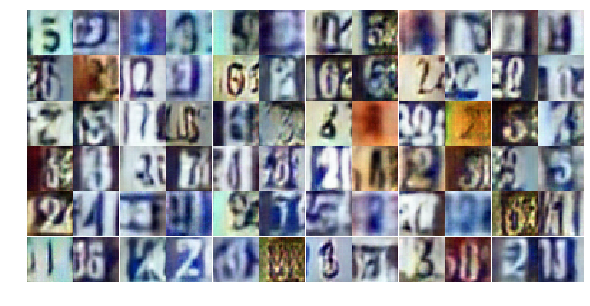

Epoch 11/25... Discriminator Loss: 0.8986... Generator Loss: 0.8077
Epoch 11/25... Discriminator Loss: 0.8598... Generator Loss: 0.8205
Epoch 11/25... Discriminator Loss: 1.0104... Generator Loss: 0.6606
Epoch 11/25... Discriminator Loss: 0.5468... Generator Loss: 1.2871
Epoch 11/25... Discriminator Loss: 0.8107... Generator Loss: 0.7971
Epoch 11/25... Discriminator Loss: 0.9737... Generator Loss: 0.6962
Epoch 11/25... Discriminator Loss: 1.4615... Generator Loss: 0.4302
Epoch 11/25... Discriminator Loss: 1.2258... Generator Loss: 0.4693
Epoch 11/25... Discriminator Loss: 0.6268... Generator Loss: 1.0702
Epoch 11/25... Discriminator Loss: 1.2094... Generator Loss: 0.4979


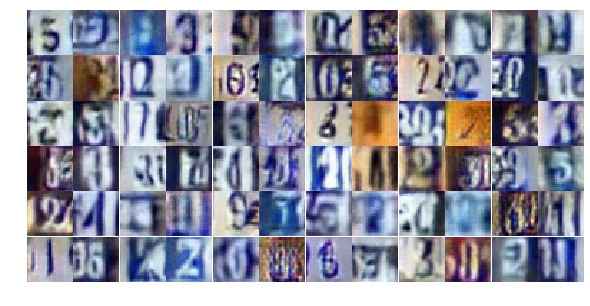

Epoch 11/25... Discriminator Loss: 0.4253... Generator Loss: 1.8207
Epoch 11/25... Discriminator Loss: 0.6292... Generator Loss: 1.2013
Epoch 11/25... Discriminator Loss: 1.3863... Generator Loss: 0.4165
Epoch 11/25... Discriminator Loss: 0.8420... Generator Loss: 1.0909
Epoch 11/25... Discriminator Loss: 0.9846... Generator Loss: 0.6956
Epoch 11/25... Discriminator Loss: 1.8813... Generator Loss: 0.2297
Epoch 11/25... Discriminator Loss: 0.3575... Generator Loss: 2.4416
Epoch 11/25... Discriminator Loss: 0.8496... Generator Loss: 0.7822
Epoch 11/25... Discriminator Loss: 1.4242... Generator Loss: 0.3805
Epoch 11/25... Discriminator Loss: 0.8854... Generator Loss: 0.7517


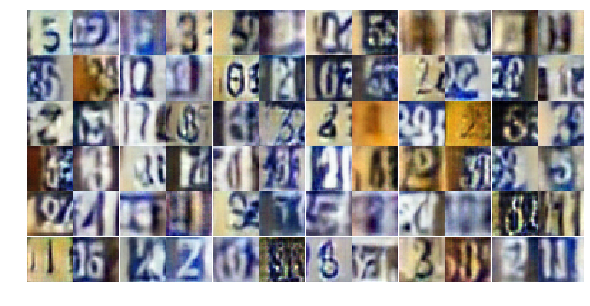

Epoch 11/25... Discriminator Loss: 1.1534... Generator Loss: 0.5720
Epoch 11/25... Discriminator Loss: 0.5433... Generator Loss: 1.7692
Epoch 11/25... Discriminator Loss: 0.7047... Generator Loss: 1.0534
Epoch 11/25... Discriminator Loss: 0.6218... Generator Loss: 1.0844
Epoch 11/25... Discriminator Loss: 1.4243... Generator Loss: 0.4519
Epoch 11/25... Discriminator Loss: 1.0156... Generator Loss: 0.6688
Epoch 11/25... Discriminator Loss: 1.3883... Generator Loss: 0.4750
Epoch 11/25... Discriminator Loss: 0.5665... Generator Loss: 1.5320
Epoch 11/25... Discriminator Loss: 0.8029... Generator Loss: 0.8477
Epoch 11/25... Discriminator Loss: 1.0017... Generator Loss: 0.7193


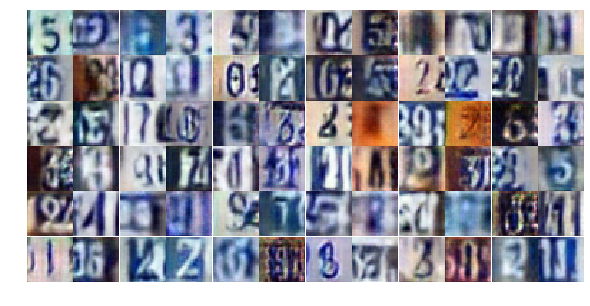

Epoch 12/25... Discriminator Loss: 0.8834... Generator Loss: 1.4620
Epoch 12/25... Discriminator Loss: 0.7458... Generator Loss: 1.7259
Epoch 12/25... Discriminator Loss: 0.8621... Generator Loss: 1.0098
Epoch 12/25... Discriminator Loss: 0.6726... Generator Loss: 1.1483
Epoch 12/25... Discriminator Loss: 0.7560... Generator Loss: 2.7609
Epoch 12/25... Discriminator Loss: 1.2138... Generator Loss: 0.5127
Epoch 12/25... Discriminator Loss: 0.7844... Generator Loss: 1.0975
Epoch 12/25... Discriminator Loss: 0.7096... Generator Loss: 1.6825
Epoch 12/25... Discriminator Loss: 0.7583... Generator Loss: 1.3034
Epoch 12/25... Discriminator Loss: 1.1345... Generator Loss: 0.5909


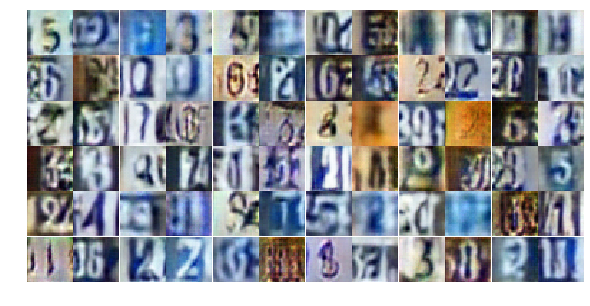

Epoch 12/25... Discriminator Loss: 0.5961... Generator Loss: 1.2786
Epoch 12/25... Discriminator Loss: 0.8872... Generator Loss: 0.7285
Epoch 12/25... Discriminator Loss: 0.5264... Generator Loss: 1.3436
Epoch 12/25... Discriminator Loss: 0.7849... Generator Loss: 1.3432
Epoch 12/25... Discriminator Loss: 0.6672... Generator Loss: 2.1896
Epoch 12/25... Discriminator Loss: 1.0209... Generator Loss: 0.6593
Epoch 12/25... Discriminator Loss: 1.1267... Generator Loss: 0.5164
Epoch 12/25... Discriminator Loss: 0.4969... Generator Loss: 1.8073
Epoch 12/25... Discriminator Loss: 0.6217... Generator Loss: 1.0808
Epoch 12/25... Discriminator Loss: 0.8199... Generator Loss: 0.8250


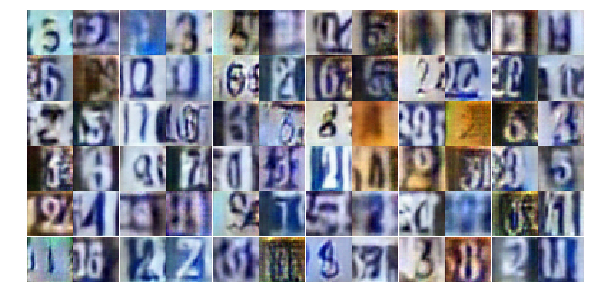

Epoch 12/25... Discriminator Loss: 0.4365... Generator Loss: 1.5533
Epoch 12/25... Discriminator Loss: 0.5450... Generator Loss: 1.5071
Epoch 12/25... Discriminator Loss: 0.6411... Generator Loss: 1.3219
Epoch 12/25... Discriminator Loss: 0.5667... Generator Loss: 1.3396
Epoch 12/25... Discriminator Loss: 0.4270... Generator Loss: 1.5758
Epoch 12/25... Discriminator Loss: 0.7265... Generator Loss: 1.0677
Epoch 12/25... Discriminator Loss: 0.9153... Generator Loss: 0.7197
Epoch 12/25... Discriminator Loss: 0.4293... Generator Loss: 1.7392
Epoch 12/25... Discriminator Loss: 0.5877... Generator Loss: 2.9042
Epoch 12/25... Discriminator Loss: 0.9049... Generator Loss: 0.7187


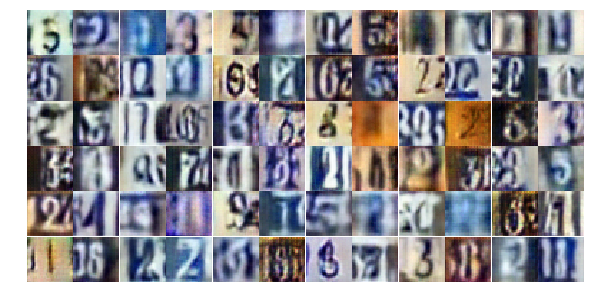

Epoch 12/25... Discriminator Loss: 1.0170... Generator Loss: 0.6237
Epoch 12/25... Discriminator Loss: 0.9572... Generator Loss: 0.7724
Epoch 12/25... Discriminator Loss: 0.8528... Generator Loss: 0.9347
Epoch 12/25... Discriminator Loss: 1.8154... Generator Loss: 0.2414
Epoch 12/25... Discriminator Loss: 0.8865... Generator Loss: 2.6766
Epoch 12/25... Discriminator Loss: 0.8902... Generator Loss: 0.8724
Epoch 12/25... Discriminator Loss: 0.8730... Generator Loss: 0.8708
Epoch 12/25... Discriminator Loss: 0.8755... Generator Loss: 0.7555
Epoch 12/25... Discriminator Loss: 0.5491... Generator Loss: 1.5900
Epoch 12/25... Discriminator Loss: 0.3244... Generator Loss: 1.7708


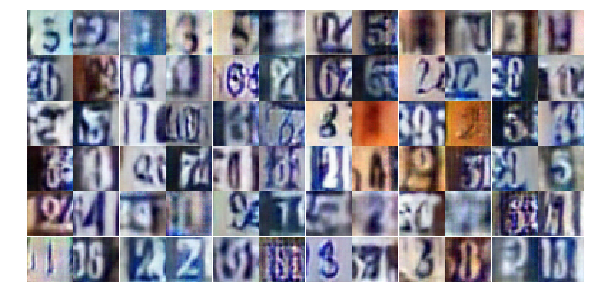

Epoch 12/25... Discriminator Loss: 0.5914... Generator Loss: 1.2767
Epoch 12/25... Discriminator Loss: 0.5424... Generator Loss: 1.1681
Epoch 12/25... Discriminator Loss: 0.3722... Generator Loss: 1.9923
Epoch 12/25... Discriminator Loss: 1.0790... Generator Loss: 0.6339
Epoch 12/25... Discriminator Loss: 1.0895... Generator Loss: 0.6543
Epoch 12/25... Discriminator Loss: 1.1216... Generator Loss: 0.5571
Epoch 12/25... Discriminator Loss: 1.2931... Generator Loss: 0.4455
Epoch 12/25... Discriminator Loss: 0.8238... Generator Loss: 0.9241
Epoch 12/25... Discriminator Loss: 0.8439... Generator Loss: 0.9487
Epoch 12/25... Discriminator Loss: 0.7486... Generator Loss: 0.8385


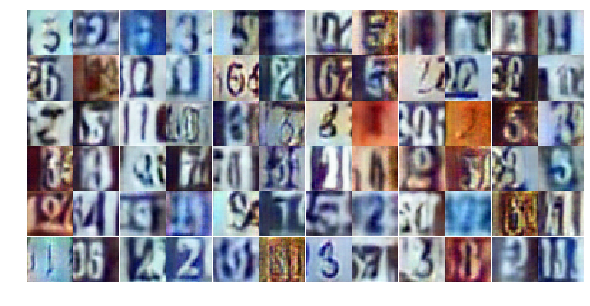

Epoch 12/25... Discriminator Loss: 0.8639... Generator Loss: 0.9307
Epoch 12/25... Discriminator Loss: 1.0544... Generator Loss: 0.6585
Epoch 12/25... Discriminator Loss: 0.6604... Generator Loss: 1.5614
Epoch 12/25... Discriminator Loss: 1.2403... Generator Loss: 0.5085
Epoch 12/25... Discriminator Loss: 0.5881... Generator Loss: 1.0462
Epoch 12/25... Discriminator Loss: 0.8962... Generator Loss: 1.4114
Epoch 12/25... Discriminator Loss: 1.2723... Generator Loss: 0.4808
Epoch 13/25... Discriminator Loss: 0.6268... Generator Loss: 1.1042
Epoch 13/25... Discriminator Loss: 0.4278... Generator Loss: 1.6693
Epoch 13/25... Discriminator Loss: 1.3975... Generator Loss: 0.4269


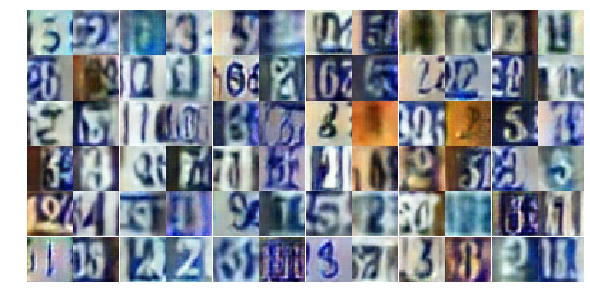

Epoch 13/25... Discriminator Loss: 0.5898... Generator Loss: 1.2027
Epoch 13/25... Discriminator Loss: 0.6733... Generator Loss: 1.4052
Epoch 13/25... Discriminator Loss: 1.1844... Generator Loss: 0.6630
Epoch 13/25... Discriminator Loss: 0.8947... Generator Loss: 0.7660
Epoch 13/25... Discriminator Loss: 0.5882... Generator Loss: 2.6902
Epoch 13/25... Discriminator Loss: 0.7513... Generator Loss: 1.4001
Epoch 13/25... Discriminator Loss: 0.6995... Generator Loss: 1.4022
Epoch 13/25... Discriminator Loss: 0.7050... Generator Loss: 0.9805
Epoch 13/25... Discriminator Loss: 0.5174... Generator Loss: 1.3962
Epoch 13/25... Discriminator Loss: 0.7072... Generator Loss: 1.8796


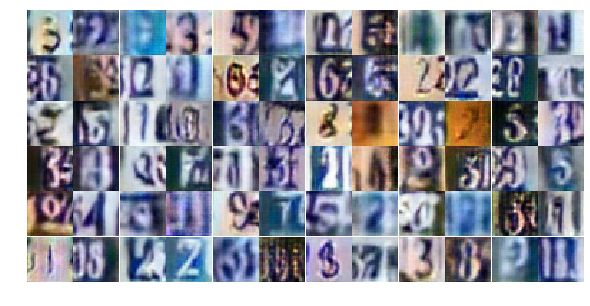

Epoch 13/25... Discriminator Loss: 0.9072... Generator Loss: 0.7751
Epoch 13/25... Discriminator Loss: 0.6736... Generator Loss: 1.1288
Epoch 13/25... Discriminator Loss: 1.1074... Generator Loss: 0.5589
Epoch 13/25... Discriminator Loss: 0.8138... Generator Loss: 0.9183
Epoch 13/25... Discriminator Loss: 0.5308... Generator Loss: 1.5108
Epoch 13/25... Discriminator Loss: 0.6626... Generator Loss: 1.1644
Epoch 13/25... Discriminator Loss: 0.7666... Generator Loss: 0.8077
Epoch 13/25... Discriminator Loss: 1.0324... Generator Loss: 0.6653
Epoch 13/25... Discriminator Loss: 0.7899... Generator Loss: 0.8620
Epoch 13/25... Discriminator Loss: 1.3464... Generator Loss: 0.4164


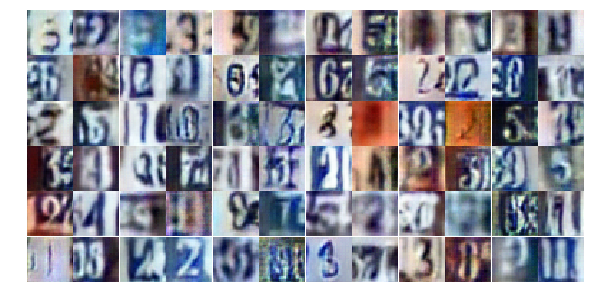

Epoch 13/25... Discriminator Loss: 0.7902... Generator Loss: 0.8584
Epoch 13/25... Discriminator Loss: 0.5179... Generator Loss: 1.5773
Epoch 13/25... Discriminator Loss: 0.6666... Generator Loss: 1.6438
Epoch 13/25... Discriminator Loss: 0.6922... Generator Loss: 1.0047
Epoch 13/25... Discriminator Loss: 0.8147... Generator Loss: 0.7968
Epoch 13/25... Discriminator Loss: 1.4671... Generator Loss: 0.4425
Epoch 13/25... Discriminator Loss: 1.1970... Generator Loss: 1.9711
Epoch 13/25... Discriminator Loss: 0.5772... Generator Loss: 1.4013
Epoch 13/25... Discriminator Loss: 0.5446... Generator Loss: 1.3901
Epoch 13/25... Discriminator Loss: 0.5913... Generator Loss: 1.4152


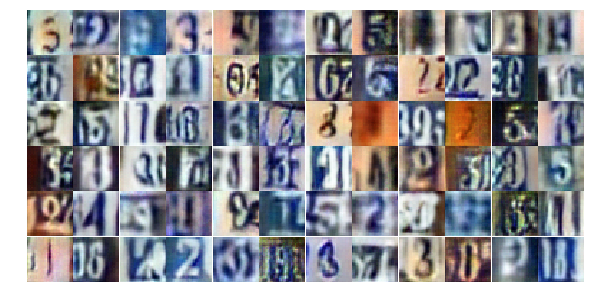

Epoch 13/25... Discriminator Loss: 1.0652... Generator Loss: 0.5908
Epoch 13/25... Discriminator Loss: 1.1698... Generator Loss: 2.1508
Epoch 13/25... Discriminator Loss: 1.3112... Generator Loss: 0.6814
Epoch 13/25... Discriminator Loss: 1.1245... Generator Loss: 0.5932
Epoch 13/25... Discriminator Loss: 0.6866... Generator Loss: 0.9742
Epoch 13/25... Discriminator Loss: 0.4641... Generator Loss: 1.6594
Epoch 13/25... Discriminator Loss: 0.6072... Generator Loss: 1.3468
Epoch 13/25... Discriminator Loss: 0.8627... Generator Loss: 0.8579
Epoch 13/25... Discriminator Loss: 0.7405... Generator Loss: 0.8882
Epoch 13/25... Discriminator Loss: 0.9072... Generator Loss: 0.7810


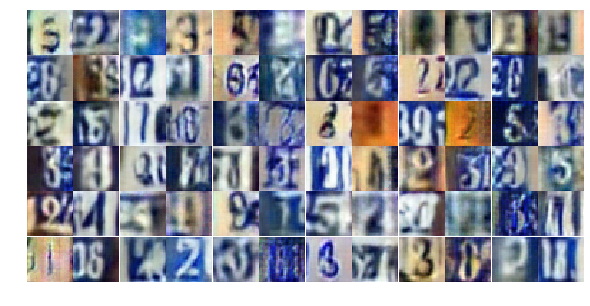

Epoch 13/25... Discriminator Loss: 0.7624... Generator Loss: 1.2720
Epoch 13/25... Discriminator Loss: 1.1333... Generator Loss: 0.7749
Epoch 13/25... Discriminator Loss: 0.8635... Generator Loss: 0.8314
Epoch 13/25... Discriminator Loss: 0.6747... Generator Loss: 1.0868
Epoch 13/25... Discriminator Loss: 0.8898... Generator Loss: 0.7472
Epoch 13/25... Discriminator Loss: 0.7883... Generator Loss: 1.0685
Epoch 13/25... Discriminator Loss: 0.6426... Generator Loss: 1.2795
Epoch 13/25... Discriminator Loss: 0.7547... Generator Loss: 0.8680
Epoch 13/25... Discriminator Loss: 1.3504... Generator Loss: 0.4019
Epoch 13/25... Discriminator Loss: 0.9413... Generator Loss: 0.6808


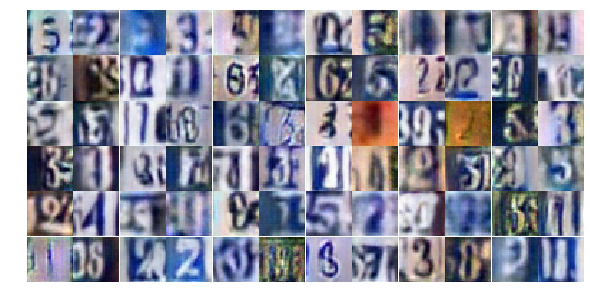

Epoch 13/25... Discriminator Loss: 0.4916... Generator Loss: 2.4858
Epoch 13/25... Discriminator Loss: 1.1625... Generator Loss: 0.6232
Epoch 13/25... Discriminator Loss: 0.7947... Generator Loss: 0.8600
Epoch 13/25... Discriminator Loss: 0.9614... Generator Loss: 0.6552
Epoch 14/25... Discriminator Loss: 0.9367... Generator Loss: 0.7354
Epoch 14/25... Discriminator Loss: 0.8016... Generator Loss: 0.8991
Epoch 14/25... Discriminator Loss: 0.9224... Generator Loss: 0.7797
Epoch 14/25... Discriminator Loss: 0.6397... Generator Loss: 1.5120
Epoch 14/25... Discriminator Loss: 0.7113... Generator Loss: 1.0873
Epoch 14/25... Discriminator Loss: 0.6060... Generator Loss: 1.1556


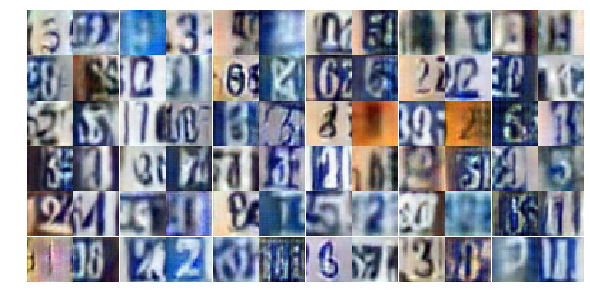

Epoch 14/25... Discriminator Loss: 0.8042... Generator Loss: 1.6207
Epoch 14/25... Discriminator Loss: 1.1609... Generator Loss: 0.5426
Epoch 14/25... Discriminator Loss: 0.7086... Generator Loss: 0.9443
Epoch 14/25... Discriminator Loss: 0.9502... Generator Loss: 0.7852
Epoch 14/25... Discriminator Loss: 1.3804... Generator Loss: 0.3883
Epoch 14/25... Discriminator Loss: 0.4818... Generator Loss: 1.3519
Epoch 14/25... Discriminator Loss: 0.4810... Generator Loss: 1.3134
Epoch 14/25... Discriminator Loss: 1.9101... Generator Loss: 0.2279
Epoch 14/25... Discriminator Loss: 1.4610... Generator Loss: 0.3749
Epoch 14/25... Discriminator Loss: 2.1742... Generator Loss: 0.1787


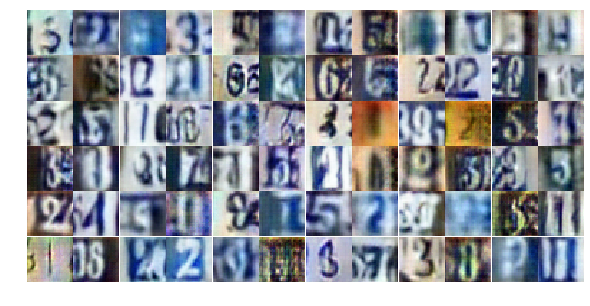

Epoch 14/25... Discriminator Loss: 0.7336... Generator Loss: 0.8720
Epoch 14/25... Discriminator Loss: 0.7734... Generator Loss: 0.9944
Epoch 14/25... Discriminator Loss: 1.1140... Generator Loss: 0.6180
Epoch 14/25... Discriminator Loss: 0.4944... Generator Loss: 1.6016
Epoch 14/25... Discriminator Loss: 0.6276... Generator Loss: 1.4335
Epoch 14/25... Discriminator Loss: 1.3889... Generator Loss: 0.3925
Epoch 14/25... Discriminator Loss: 0.8414... Generator Loss: 0.9273
Epoch 14/25... Discriminator Loss: 0.9366... Generator Loss: 0.6698
Epoch 14/25... Discriminator Loss: 0.7813... Generator Loss: 0.8864
Epoch 14/25... Discriminator Loss: 0.6330... Generator Loss: 1.1254


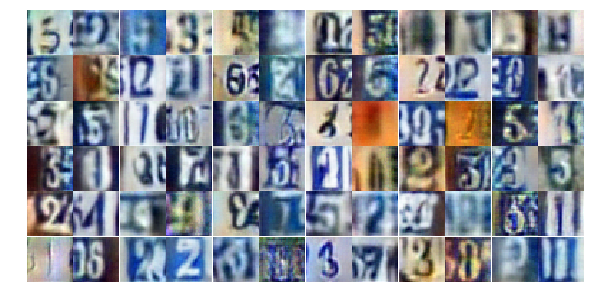

Epoch 14/25... Discriminator Loss: 1.2840... Generator Loss: 0.4577
Epoch 14/25... Discriminator Loss: 0.6512... Generator Loss: 0.9889
Epoch 14/25... Discriminator Loss: 0.5168... Generator Loss: 1.2460
Epoch 14/25... Discriminator Loss: 0.4814... Generator Loss: 1.4217
Epoch 14/25... Discriminator Loss: 0.8581... Generator Loss: 0.9365
Epoch 14/25... Discriminator Loss: 0.5887... Generator Loss: 1.2470
Epoch 14/25... Discriminator Loss: 0.8370... Generator Loss: 1.3768
Epoch 14/25... Discriminator Loss: 0.5857... Generator Loss: 2.2480
Epoch 14/25... Discriminator Loss: 0.5971... Generator Loss: 3.0851
Epoch 14/25... Discriminator Loss: 0.9336... Generator Loss: 0.8064


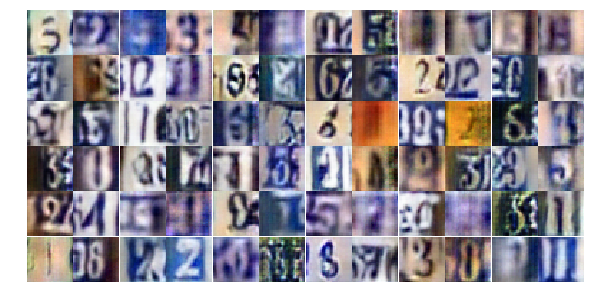

Epoch 14/25... Discriminator Loss: 0.8386... Generator Loss: 0.8417
Epoch 14/25... Discriminator Loss: 0.8390... Generator Loss: 1.0385
Epoch 14/25... Discriminator Loss: 0.9143... Generator Loss: 0.6961
Epoch 14/25... Discriminator Loss: 0.9268... Generator Loss: 0.6840
Epoch 14/25... Discriminator Loss: 1.1996... Generator Loss: 0.5018
Epoch 14/25... Discriminator Loss: 0.7567... Generator Loss: 1.4183
Epoch 14/25... Discriminator Loss: 0.8789... Generator Loss: 2.2841
Epoch 14/25... Discriminator Loss: 0.6017... Generator Loss: 1.2506
Epoch 14/25... Discriminator Loss: 1.7521... Generator Loss: 0.3419
Epoch 14/25... Discriminator Loss: 1.5152... Generator Loss: 0.3353


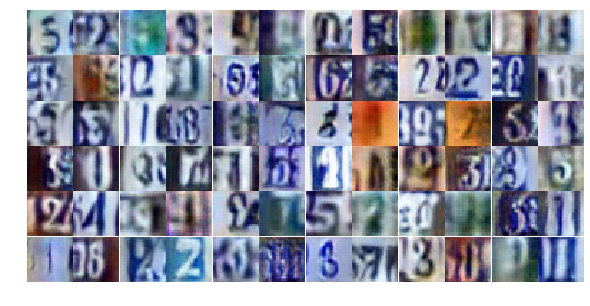

Epoch 14/25... Discriminator Loss: 1.1341... Generator Loss: 1.2375
Epoch 14/25... Discriminator Loss: 1.4965... Generator Loss: 0.3783
Epoch 14/25... Discriminator Loss: 0.7299... Generator Loss: 1.1285
Epoch 14/25... Discriminator Loss: 0.6344... Generator Loss: 1.1468
Epoch 14/25... Discriminator Loss: 1.0377... Generator Loss: 0.6687
Epoch 14/25... Discriminator Loss: 0.9259... Generator Loss: 0.7186
Epoch 14/25... Discriminator Loss: 1.0634... Generator Loss: 1.8324
Epoch 14/25... Discriminator Loss: 0.8174... Generator Loss: 0.8356
Epoch 14/25... Discriminator Loss: 1.2927... Generator Loss: 0.4493
Epoch 14/25... Discriminator Loss: 1.2945... Generator Loss: 0.4207


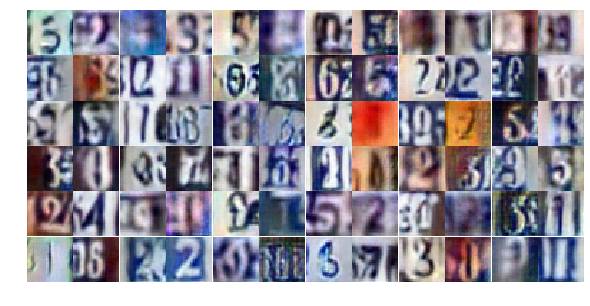

Epoch 14/25... Discriminator Loss: 0.6798... Generator Loss: 1.8730
Epoch 14/25... Discriminator Loss: 0.9317... Generator Loss: 0.7722
Epoch 15/25... Discriminator Loss: 0.6565... Generator Loss: 1.0341
Epoch 15/25... Discriminator Loss: 0.4977... Generator Loss: 1.5781
Epoch 15/25... Discriminator Loss: 0.5518... Generator Loss: 1.1097
Epoch 15/25... Discriminator Loss: 1.0401... Generator Loss: 0.6059
Epoch 15/25... Discriminator Loss: 0.5811... Generator Loss: 1.2916
Epoch 15/25... Discriminator Loss: 0.9100... Generator Loss: 1.2700
Epoch 15/25... Discriminator Loss: 1.6671... Generator Loss: 0.3230
Epoch 15/25... Discriminator Loss: 0.7745... Generator Loss: 0.9004


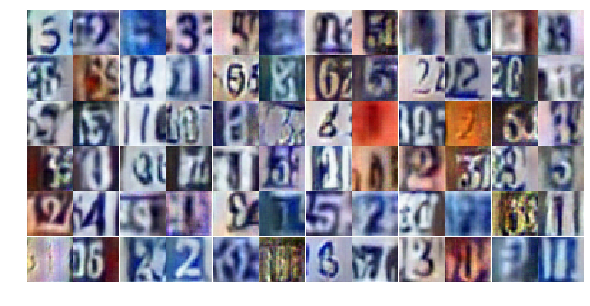

Epoch 15/25... Discriminator Loss: 0.7380... Generator Loss: 1.1740
Epoch 15/25... Discriminator Loss: 0.8103... Generator Loss: 1.0344
Epoch 15/25... Discriminator Loss: 1.2216... Generator Loss: 0.5304
Epoch 15/25... Discriminator Loss: 0.5248... Generator Loss: 1.3605
Epoch 15/25... Discriminator Loss: 1.1109... Generator Loss: 0.5698
Epoch 15/25... Discriminator Loss: 0.5821... Generator Loss: 1.2612
Epoch 15/25... Discriminator Loss: 1.3050... Generator Loss: 0.4618
Epoch 15/25... Discriminator Loss: 0.9161... Generator Loss: 0.7831
Epoch 15/25... Discriminator Loss: 0.4517... Generator Loss: 2.4068
Epoch 15/25... Discriminator Loss: 1.0548... Generator Loss: 0.6628


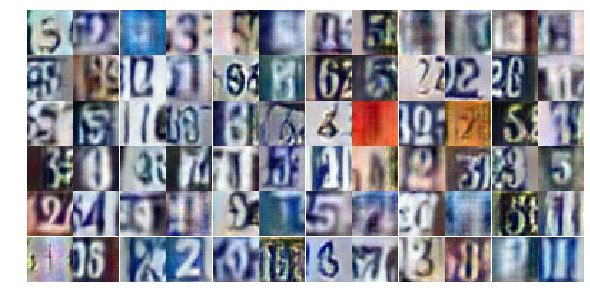

Epoch 15/25... Discriminator Loss: 0.7411... Generator Loss: 1.0232
Epoch 15/25... Discriminator Loss: 0.6521... Generator Loss: 1.3929
Epoch 15/25... Discriminator Loss: 0.7297... Generator Loss: 1.0621
Epoch 15/25... Discriminator Loss: 0.8657... Generator Loss: 0.7886
Epoch 15/25... Discriminator Loss: 0.9785... Generator Loss: 0.7121
Epoch 15/25... Discriminator Loss: 0.6577... Generator Loss: 1.1286
Epoch 15/25... Discriminator Loss: 1.0358... Generator Loss: 0.6051
Epoch 15/25... Discriminator Loss: 0.8130... Generator Loss: 0.8163
Epoch 15/25... Discriminator Loss: 0.6649... Generator Loss: 0.9283
Epoch 15/25... Discriminator Loss: 1.4905... Generator Loss: 0.3842


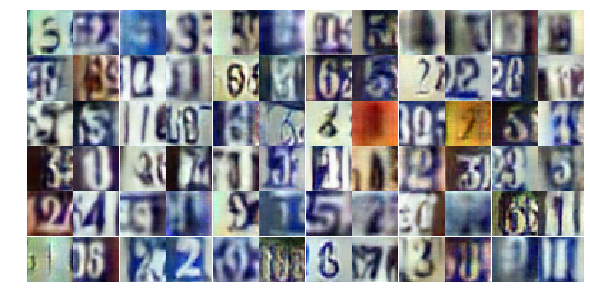

Epoch 15/25... Discriminator Loss: 0.9006... Generator Loss: 0.8189
Epoch 15/25... Discriminator Loss: 1.2851... Generator Loss: 0.5017
Epoch 15/25... Discriminator Loss: 0.4882... Generator Loss: 1.3095
Epoch 15/25... Discriminator Loss: 0.7524... Generator Loss: 0.9952
Epoch 15/25... Discriminator Loss: 0.5405... Generator Loss: 1.6707
Epoch 15/25... Discriminator Loss: 1.8662... Generator Loss: 3.2708
Epoch 15/25... Discriminator Loss: 0.5023... Generator Loss: 1.3906
Epoch 15/25... Discriminator Loss: 0.9197... Generator Loss: 1.0882
Epoch 15/25... Discriminator Loss: 0.7735... Generator Loss: 0.8771
Epoch 15/25... Discriminator Loss: 0.8404... Generator Loss: 1.0148


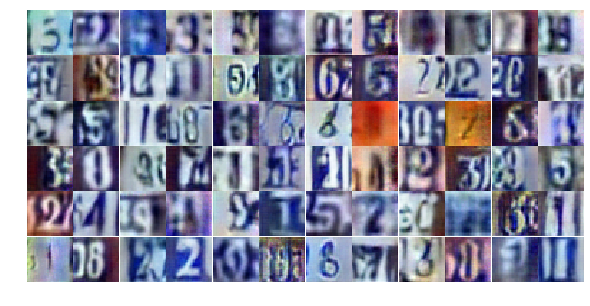

Epoch 15/25... Discriminator Loss: 0.7377... Generator Loss: 0.9574
Epoch 15/25... Discriminator Loss: 1.3993... Generator Loss: 0.3797
Epoch 15/25... Discriminator Loss: 0.8237... Generator Loss: 0.9098
Epoch 15/25... Discriminator Loss: 0.4938... Generator Loss: 1.3894
Epoch 15/25... Discriminator Loss: 0.7142... Generator Loss: 0.8979
Epoch 15/25... Discriminator Loss: 1.0528... Generator Loss: 0.6582
Epoch 15/25... Discriminator Loss: 0.4002... Generator Loss: 1.7268
Epoch 15/25... Discriminator Loss: 1.0435... Generator Loss: 1.3251
Epoch 15/25... Discriminator Loss: 1.0950... Generator Loss: 0.5653
Epoch 15/25... Discriminator Loss: 1.0103... Generator Loss: 0.6732


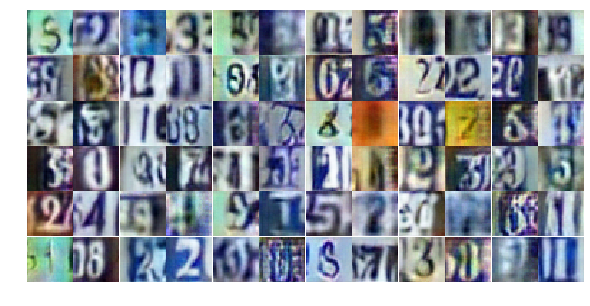

Epoch 15/25... Discriminator Loss: 3.7237... Generator Loss: 5.5714
Epoch 15/25... Discriminator Loss: 2.0770... Generator Loss: 0.6372
Epoch 15/25... Discriminator Loss: 1.1151... Generator Loss: 2.1242
Epoch 15/25... Discriminator Loss: 1.4317... Generator Loss: 0.4298
Epoch 15/25... Discriminator Loss: 0.9096... Generator Loss: 0.8632
Epoch 15/25... Discriminator Loss: 0.9573... Generator Loss: 0.7518
Epoch 15/25... Discriminator Loss: 0.9890... Generator Loss: 0.6546
Epoch 15/25... Discriminator Loss: 0.5970... Generator Loss: 1.3930
Epoch 15/25... Discriminator Loss: 1.6899... Generator Loss: 0.2761
Epoch 16/25... Discriminator Loss: 1.0791... Generator Loss: 0.6204


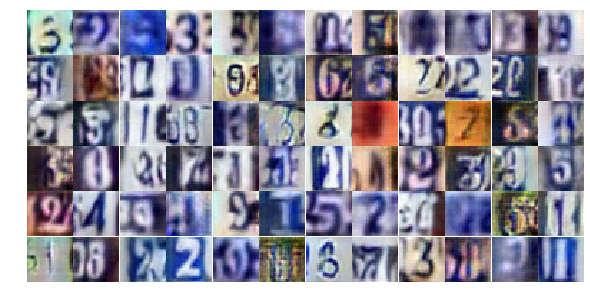

Epoch 16/25... Discriminator Loss: 0.7128... Generator Loss: 1.0691
Epoch 16/25... Discriminator Loss: 1.0012... Generator Loss: 0.6631
Epoch 16/25... Discriminator Loss: 0.9630... Generator Loss: 0.7471
Epoch 16/25... Discriminator Loss: 0.6594... Generator Loss: 1.3283
Epoch 16/25... Discriminator Loss: 0.6879... Generator Loss: 1.4159
Epoch 16/25... Discriminator Loss: 0.9476... Generator Loss: 0.7020
Epoch 16/25... Discriminator Loss: 1.6695... Generator Loss: 0.2991
Epoch 16/25... Discriminator Loss: 0.9499... Generator Loss: 0.7314
Epoch 16/25... Discriminator Loss: 0.6564... Generator Loss: 1.0579
Epoch 16/25... Discriminator Loss: 0.8779... Generator Loss: 0.7977


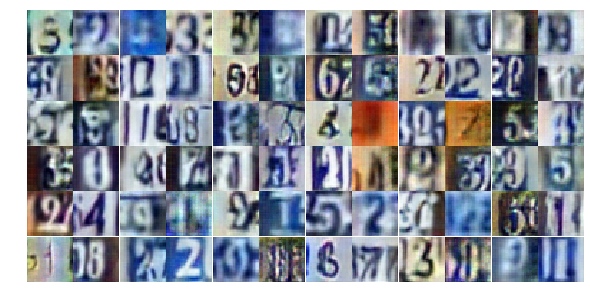

Epoch 16/25... Discriminator Loss: 1.7754... Generator Loss: 0.2888
Epoch 16/25... Discriminator Loss: 0.5485... Generator Loss: 1.3446
Epoch 16/25... Discriminator Loss: 0.6018... Generator Loss: 1.2072
Epoch 16/25... Discriminator Loss: 1.5849... Generator Loss: 0.3085
Epoch 16/25... Discriminator Loss: 0.6972... Generator Loss: 1.4633
Epoch 16/25... Discriminator Loss: 0.8640... Generator Loss: 1.0116
Epoch 16/25... Discriminator Loss: 0.8496... Generator Loss: 0.8489
Epoch 16/25... Discriminator Loss: 0.5009... Generator Loss: 1.4988
Epoch 16/25... Discriminator Loss: 0.6584... Generator Loss: 0.9878
Epoch 16/25... Discriminator Loss: 0.5648... Generator Loss: 1.5094


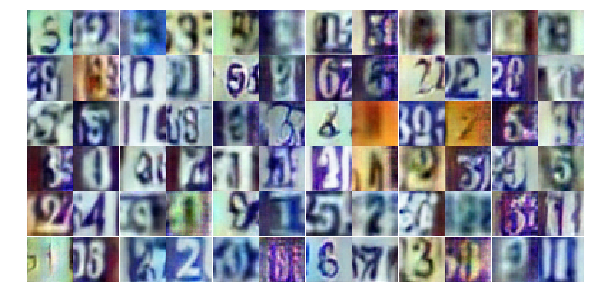

Epoch 16/25... Discriminator Loss: 0.8897... Generator Loss: 0.8691
Epoch 16/25... Discriminator Loss: 0.7290... Generator Loss: 1.0377
Epoch 16/25... Discriminator Loss: 0.9534... Generator Loss: 0.6852
Epoch 16/25... Discriminator Loss: 1.2043... Generator Loss: 0.4854
Epoch 16/25... Discriminator Loss: 0.6735... Generator Loss: 1.1831
Epoch 16/25... Discriminator Loss: 1.1045... Generator Loss: 0.5751
Epoch 16/25... Discriminator Loss: 1.0348... Generator Loss: 0.6303
Epoch 16/25... Discriminator Loss: 0.5908... Generator Loss: 1.1824
Epoch 16/25... Discriminator Loss: 0.7794... Generator Loss: 1.2766
Epoch 16/25... Discriminator Loss: 0.6281... Generator Loss: 1.0380


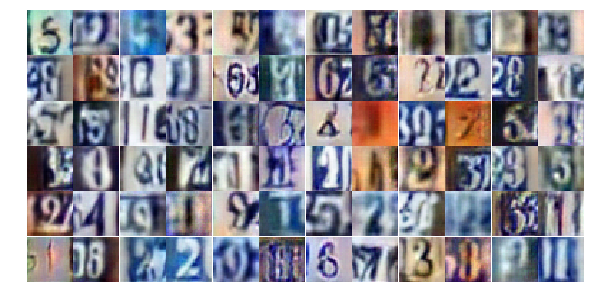

Epoch 16/25... Discriminator Loss: 0.7448... Generator Loss: 0.8347
Epoch 16/25... Discriminator Loss: 0.8915... Generator Loss: 0.7378
Epoch 16/25... Discriminator Loss: 0.7218... Generator Loss: 1.1496
Epoch 16/25... Discriminator Loss: 1.9513... Generator Loss: 1.6578
Epoch 16/25... Discriminator Loss: 1.2475... Generator Loss: 0.5451
Epoch 16/25... Discriminator Loss: 0.9046... Generator Loss: 0.7905
Epoch 16/25... Discriminator Loss: 0.8925... Generator Loss: 0.8887
Epoch 16/25... Discriminator Loss: 1.3750... Generator Loss: 0.4032
Epoch 16/25... Discriminator Loss: 1.3120... Generator Loss: 0.4559
Epoch 16/25... Discriminator Loss: 0.7051... Generator Loss: 0.9585


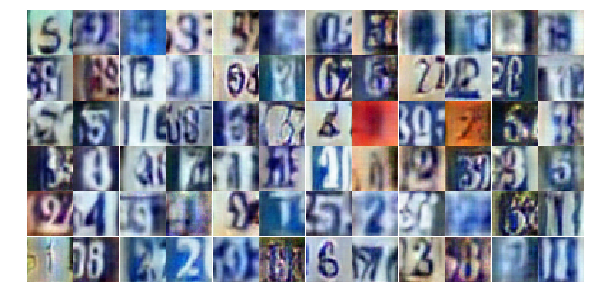

Epoch 16/25... Discriminator Loss: 0.6864... Generator Loss: 2.1430
Epoch 16/25... Discriminator Loss: 0.7516... Generator Loss: 0.9314
Epoch 16/25... Discriminator Loss: 1.0739... Generator Loss: 0.5840
Epoch 16/25... Discriminator Loss: 1.5334... Generator Loss: 0.4028
Epoch 16/25... Discriminator Loss: 0.9159... Generator Loss: 0.7377
Epoch 16/25... Discriminator Loss: 0.8943... Generator Loss: 0.8635
Epoch 16/25... Discriminator Loss: 0.4939... Generator Loss: 1.6800
Epoch 16/25... Discriminator Loss: 1.0244... Generator Loss: 0.6588
Epoch 16/25... Discriminator Loss: 0.6207... Generator Loss: 1.1558
Epoch 16/25... Discriminator Loss: 1.2434... Generator Loss: 0.6044


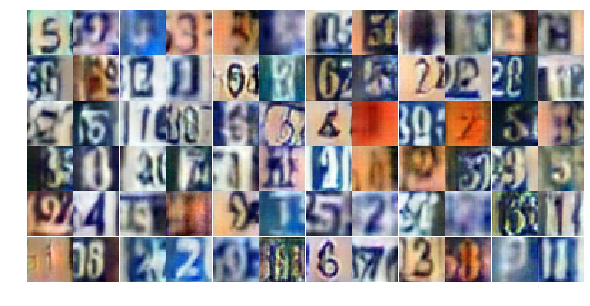

Epoch 16/25... Discriminator Loss: 1.0776... Generator Loss: 1.4758
Epoch 16/25... Discriminator Loss: 0.8181... Generator Loss: 0.8669
Epoch 16/25... Discriminator Loss: 1.1780... Generator Loss: 0.5653
Epoch 16/25... Discriminator Loss: 0.4694... Generator Loss: 1.6971
Epoch 16/25... Discriminator Loss: 0.6764... Generator Loss: 1.0663
Epoch 16/25... Discriminator Loss: 0.7473... Generator Loss: 1.0506
Epoch 17/25... Discriminator Loss: 0.7357... Generator Loss: 1.0157
Epoch 17/25... Discriminator Loss: 0.8420... Generator Loss: 0.8182
Epoch 17/25... Discriminator Loss: 0.8871... Generator Loss: 0.8710
Epoch 17/25... Discriminator Loss: 1.1395... Generator Loss: 0.5380


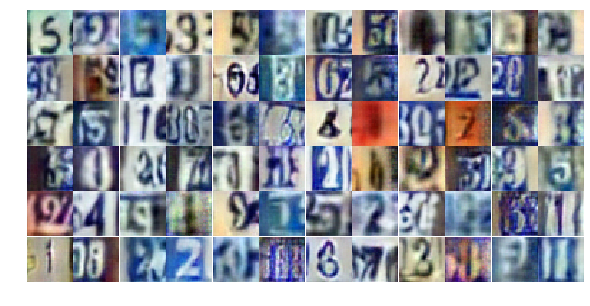

Epoch 17/25... Discriminator Loss: 0.7667... Generator Loss: 0.9400
Epoch 17/25... Discriminator Loss: 0.7574... Generator Loss: 0.9527
Epoch 17/25... Discriminator Loss: 0.9411... Generator Loss: 0.9065
Epoch 17/25... Discriminator Loss: 0.7433... Generator Loss: 0.9107
Epoch 17/25... Discriminator Loss: 1.1104... Generator Loss: 0.5362
Epoch 17/25... Discriminator Loss: 1.4842... Generator Loss: 0.4508
Epoch 17/25... Discriminator Loss: 1.3324... Generator Loss: 0.4521
Epoch 17/25... Discriminator Loss: 0.8026... Generator Loss: 0.9445
Epoch 17/25... Discriminator Loss: 0.8107... Generator Loss: 0.8492
Epoch 17/25... Discriminator Loss: 0.8133... Generator Loss: 0.8957


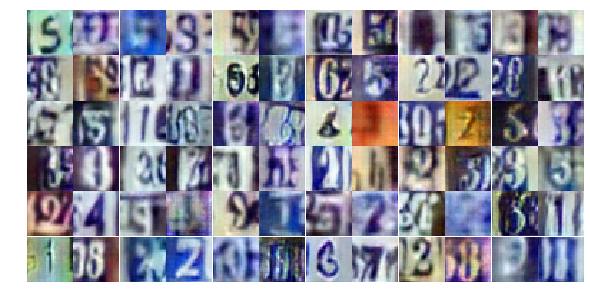

Epoch 17/25... Discriminator Loss: 0.8884... Generator Loss: 1.0522
Epoch 17/25... Discriminator Loss: 0.9564... Generator Loss: 0.6441
Epoch 17/25... Discriminator Loss: 0.7918... Generator Loss: 0.7907
Epoch 17/25... Discriminator Loss: 0.8090... Generator Loss: 0.9026
Epoch 17/25... Discriminator Loss: 0.7363... Generator Loss: 0.9525
Epoch 17/25... Discriminator Loss: 0.8379... Generator Loss: 0.8104
Epoch 17/25... Discriminator Loss: 0.6762... Generator Loss: 1.4625
Epoch 17/25... Discriminator Loss: 0.7319... Generator Loss: 1.0100
Epoch 17/25... Discriminator Loss: 1.0474... Generator Loss: 0.6195
Epoch 17/25... Discriminator Loss: 0.7475... Generator Loss: 0.8629


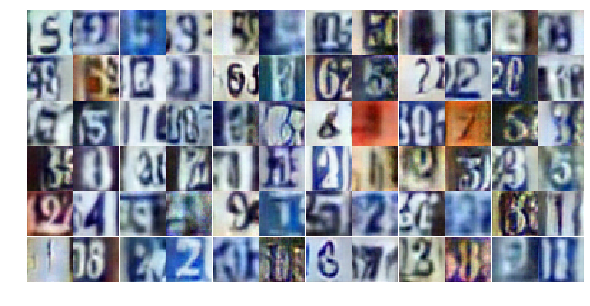

Epoch 17/25... Discriminator Loss: 1.7282... Generator Loss: 0.3225
Epoch 17/25... Discriminator Loss: 0.5826... Generator Loss: 1.4660
Epoch 17/25... Discriminator Loss: 0.5014... Generator Loss: 1.7499
Epoch 17/25... Discriminator Loss: 1.4481... Generator Loss: 0.4129
Epoch 17/25... Discriminator Loss: 1.9511... Generator Loss: 0.2333
Epoch 17/25... Discriminator Loss: 0.6891... Generator Loss: 1.2437
Epoch 17/25... Discriminator Loss: 0.6843... Generator Loss: 1.0328
Epoch 17/25... Discriminator Loss: 0.8438... Generator Loss: 0.8243
Epoch 17/25... Discriminator Loss: 1.3132... Generator Loss: 0.4793
Epoch 17/25... Discriminator Loss: 0.6170... Generator Loss: 1.3299


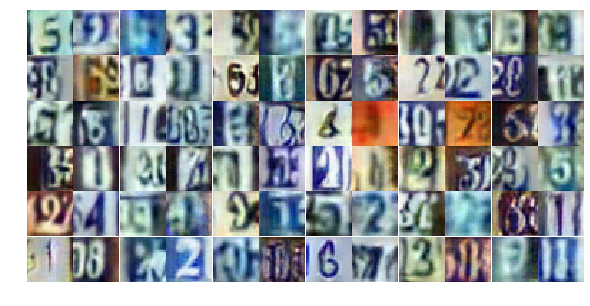

Epoch 17/25... Discriminator Loss: 0.6908... Generator Loss: 1.5743
Epoch 17/25... Discriminator Loss: 1.0486... Generator Loss: 0.6820
Epoch 17/25... Discriminator Loss: 0.8164... Generator Loss: 0.8579
Epoch 17/25... Discriminator Loss: 0.8948... Generator Loss: 1.1959
Epoch 17/25... Discriminator Loss: 0.9092... Generator Loss: 1.0213
Epoch 17/25... Discriminator Loss: 0.9105... Generator Loss: 0.7594
Epoch 17/25... Discriminator Loss: 1.1909... Generator Loss: 0.5546
Epoch 17/25... Discriminator Loss: 0.6175... Generator Loss: 2.4452
Epoch 17/25... Discriminator Loss: 0.5899... Generator Loss: 1.1761
Epoch 17/25... Discriminator Loss: 1.0115... Generator Loss: 0.6371


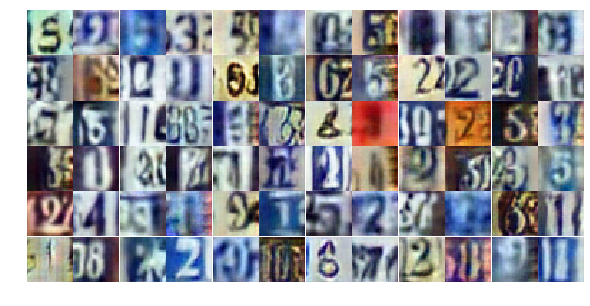

Epoch 17/25... Discriminator Loss: 1.0314... Generator Loss: 0.7744
Epoch 17/25... Discriminator Loss: 0.4681... Generator Loss: 3.2304
Epoch 17/25... Discriminator Loss: 0.7807... Generator Loss: 1.2053
Epoch 17/25... Discriminator Loss: 0.4908... Generator Loss: 1.4701
Epoch 17/25... Discriminator Loss: 1.0636... Generator Loss: 0.5889
Epoch 17/25... Discriminator Loss: 0.9052... Generator Loss: 1.0484
Epoch 17/25... Discriminator Loss: 1.2374... Generator Loss: 0.4819
Epoch 17/25... Discriminator Loss: 0.6281... Generator Loss: 1.2422
Epoch 17/25... Discriminator Loss: 0.6835... Generator Loss: 1.6159
Epoch 17/25... Discriminator Loss: 1.4514... Generator Loss: 0.3545


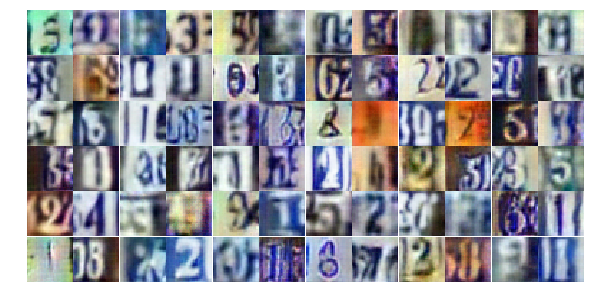

Epoch 17/25... Discriminator Loss: 0.7384... Generator Loss: 1.3503
Epoch 17/25... Discriminator Loss: 1.1635... Generator Loss: 0.5845
Epoch 17/25... Discriminator Loss: 0.4492... Generator Loss: 1.4324
Epoch 17/25... Discriminator Loss: 0.6873... Generator Loss: 1.2243
Epoch 18/25... Discriminator Loss: 0.9963... Generator Loss: 0.7706
Epoch 18/25... Discriminator Loss: 1.3640... Generator Loss: 0.3891
Epoch 18/25... Discriminator Loss: 0.9997... Generator Loss: 0.6384
Epoch 18/25... Discriminator Loss: 0.8389... Generator Loss: 0.7370
Epoch 18/25... Discriminator Loss: 0.9751... Generator Loss: 0.7751
Epoch 18/25... Discriminator Loss: 1.0228... Generator Loss: 1.6907


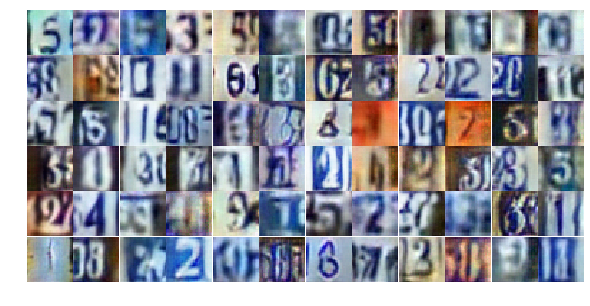

Epoch 18/25... Discriminator Loss: 0.9198... Generator Loss: 1.8292
Epoch 18/25... Discriminator Loss: 1.0671... Generator Loss: 0.6616
Epoch 18/25... Discriminator Loss: 1.1393... Generator Loss: 0.5463
Epoch 18/25... Discriminator Loss: 0.5285... Generator Loss: 1.6588
Epoch 18/25... Discriminator Loss: 0.8306... Generator Loss: 0.8394
Epoch 18/25... Discriminator Loss: 1.0959... Generator Loss: 0.6171
Epoch 18/25... Discriminator Loss: 0.6747... Generator Loss: 1.0300
Epoch 18/25... Discriminator Loss: 0.9474... Generator Loss: 0.6879
Epoch 18/25... Discriminator Loss: 0.6208... Generator Loss: 1.2415
Epoch 18/25... Discriminator Loss: 0.4549... Generator Loss: 1.5172


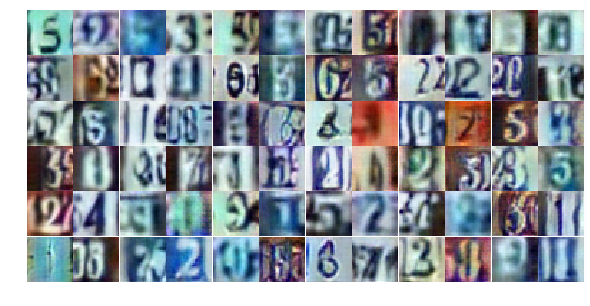

Epoch 18/25... Discriminator Loss: 0.5630... Generator Loss: 1.4084
Epoch 18/25... Discriminator Loss: 0.7180... Generator Loss: 0.9638
Epoch 18/25... Discriminator Loss: 1.1474... Generator Loss: 0.5802
Epoch 18/25... Discriminator Loss: 0.6567... Generator Loss: 1.0167
Epoch 18/25... Discriminator Loss: 0.8344... Generator Loss: 0.8681
Epoch 18/25... Discriminator Loss: 1.1060... Generator Loss: 0.5567
Epoch 18/25... Discriminator Loss: 0.7100... Generator Loss: 1.1354
Epoch 18/25... Discriminator Loss: 1.3110... Generator Loss: 0.4272
Epoch 18/25... Discriminator Loss: 3.1994... Generator Loss: 4.5596
Epoch 18/25... Discriminator Loss: 0.8975... Generator Loss: 2.3632


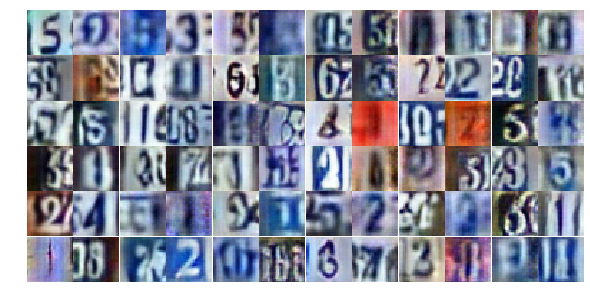

Epoch 18/25... Discriminator Loss: 0.6158... Generator Loss: 1.3937
Epoch 18/25... Discriminator Loss: 0.9299... Generator Loss: 0.8032
Epoch 18/25... Discriminator Loss: 1.0231... Generator Loss: 0.6376
Epoch 18/25... Discriminator Loss: 1.0184... Generator Loss: 0.7376
Epoch 18/25... Discriminator Loss: 0.9356... Generator Loss: 0.8081
Epoch 18/25... Discriminator Loss: 0.9668... Generator Loss: 0.6852
Epoch 18/25... Discriminator Loss: 0.9761... Generator Loss: 0.8591
Epoch 18/25... Discriminator Loss: 0.5125... Generator Loss: 1.3471
Epoch 18/25... Discriminator Loss: 0.8473... Generator Loss: 0.7418
Epoch 18/25... Discriminator Loss: 0.6327... Generator Loss: 1.1659


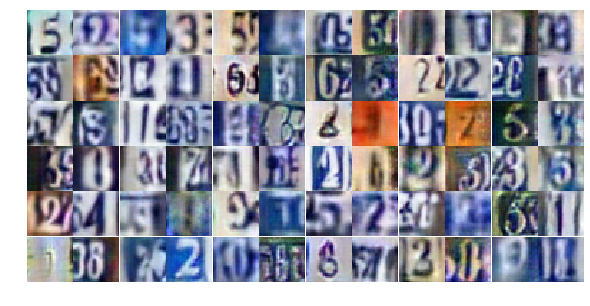

Epoch 18/25... Discriminator Loss: 0.8073... Generator Loss: 0.8691
Epoch 18/25... Discriminator Loss: 0.7818... Generator Loss: 0.8924
Epoch 18/25... Discriminator Loss: 0.6953... Generator Loss: 0.9557
Epoch 18/25... Discriminator Loss: 0.5958... Generator Loss: 1.3989
Epoch 18/25... Discriminator Loss: 0.8172... Generator Loss: 0.8214
Epoch 18/25... Discriminator Loss: 0.5382... Generator Loss: 1.2206
Epoch 18/25... Discriminator Loss: 1.2073... Generator Loss: 0.5342
Epoch 18/25... Discriminator Loss: 1.5208... Generator Loss: 2.2527
Epoch 18/25... Discriminator Loss: 1.0820... Generator Loss: 0.5867
Epoch 18/25... Discriminator Loss: 0.5631... Generator Loss: 1.2538


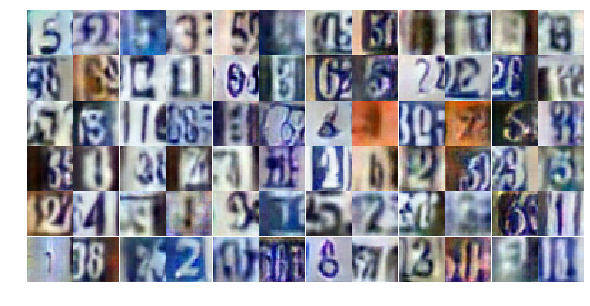

Epoch 18/25... Discriminator Loss: 0.7127... Generator Loss: 0.9932
Epoch 18/25... Discriminator Loss: 0.6784... Generator Loss: 1.1283
Epoch 18/25... Discriminator Loss: 1.0996... Generator Loss: 0.6544
Epoch 18/25... Discriminator Loss: 1.0895... Generator Loss: 0.6305
Epoch 18/25... Discriminator Loss: 0.7174... Generator Loss: 1.0896
Epoch 18/25... Discriminator Loss: 0.7017... Generator Loss: 1.7499
Epoch 18/25... Discriminator Loss: 0.5983... Generator Loss: 1.2756
Epoch 18/25... Discriminator Loss: 0.5780... Generator Loss: 1.1250
Epoch 18/25... Discriminator Loss: 0.8606... Generator Loss: 0.8702
Epoch 18/25... Discriminator Loss: 1.5016... Generator Loss: 0.3308


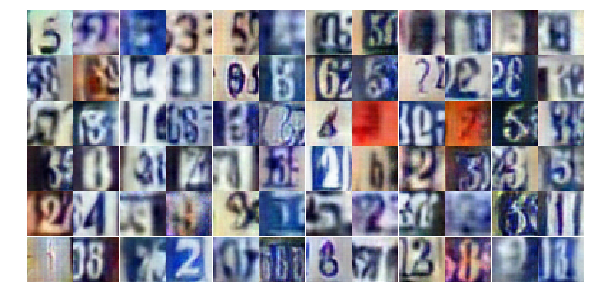

Epoch 18/25... Discriminator Loss: 0.6911... Generator Loss: 1.4823
Epoch 19/25... Discriminator Loss: 0.9004... Generator Loss: 0.9431
Epoch 19/25... Discriminator Loss: 1.2405... Generator Loss: 0.4727
Epoch 19/25... Discriminator Loss: 1.0858... Generator Loss: 0.5872
Epoch 19/25... Discriminator Loss: 0.7768... Generator Loss: 0.9048
Epoch 19/25... Discriminator Loss: 0.7790... Generator Loss: 1.0018
Epoch 19/25... Discriminator Loss: 0.6619... Generator Loss: 1.1240
Epoch 19/25... Discriminator Loss: 1.1269... Generator Loss: 0.5624
Epoch 19/25... Discriminator Loss: 0.5325... Generator Loss: 1.5993
Epoch 19/25... Discriminator Loss: 1.0447... Generator Loss: 0.6221


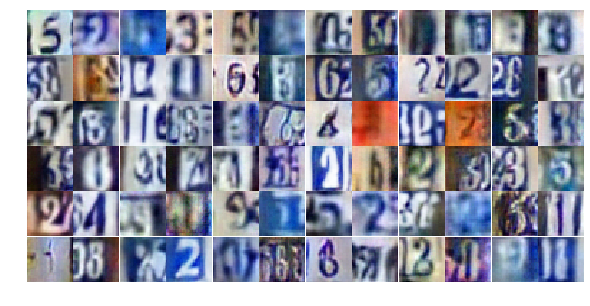

Epoch 19/25... Discriminator Loss: 0.6556... Generator Loss: 1.0260
Epoch 19/25... Discriminator Loss: 1.2754... Generator Loss: 0.4778
Epoch 19/25... Discriminator Loss: 0.7744... Generator Loss: 0.9739
Epoch 19/25... Discriminator Loss: 1.1618... Generator Loss: 0.5371
Epoch 19/25... Discriminator Loss: 0.8235... Generator Loss: 1.2065
Epoch 19/25... Discriminator Loss: 0.6706... Generator Loss: 1.2565
Epoch 19/25... Discriminator Loss: 1.0983... Generator Loss: 0.5967
Epoch 19/25... Discriminator Loss: 0.8649... Generator Loss: 0.7484
Epoch 19/25... Discriminator Loss: 0.6972... Generator Loss: 0.9975
Epoch 19/25... Discriminator Loss: 1.5772... Generator Loss: 0.3712


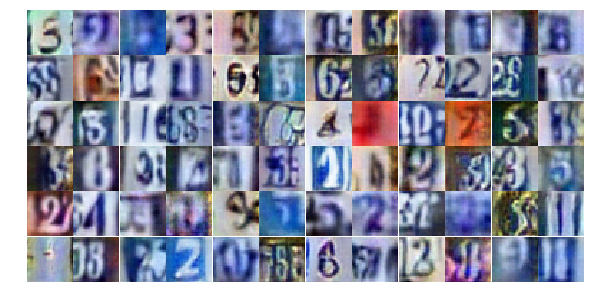

Epoch 19/25... Discriminator Loss: 0.6948... Generator Loss: 0.9209
Epoch 19/25... Discriminator Loss: 2.1606... Generator Loss: 0.1957
Epoch 19/25... Discriminator Loss: 1.2672... Generator Loss: 0.5294
Epoch 19/25... Discriminator Loss: 0.9588... Generator Loss: 0.7895
Epoch 19/25... Discriminator Loss: 1.3783... Generator Loss: 0.4432
Epoch 19/25... Discriminator Loss: 0.5586... Generator Loss: 1.9311
Epoch 19/25... Discriminator Loss: 0.7378... Generator Loss: 0.9841
Epoch 19/25... Discriminator Loss: 0.6623... Generator Loss: 1.0521
Epoch 19/25... Discriminator Loss: 0.9219... Generator Loss: 0.7035
Epoch 19/25... Discriminator Loss: 0.8132... Generator Loss: 0.9317


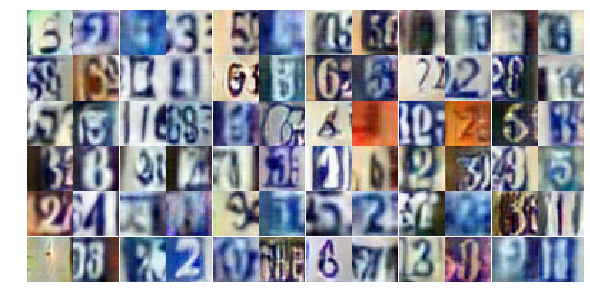

Epoch 19/25... Discriminator Loss: 1.4457... Generator Loss: 0.3804
Epoch 19/25... Discriminator Loss: 0.6405... Generator Loss: 1.1216
Epoch 19/25... Discriminator Loss: 0.9148... Generator Loss: 0.7161
Epoch 19/25... Discriminator Loss: 0.5305... Generator Loss: 1.1970
Epoch 19/25... Discriminator Loss: 0.4854... Generator Loss: 1.5425
Epoch 19/25... Discriminator Loss: 1.1123... Generator Loss: 0.6336
Epoch 19/25... Discriminator Loss: 0.6055... Generator Loss: 1.5636
Epoch 19/25... Discriminator Loss: 0.5795... Generator Loss: 1.4741
Epoch 19/25... Discriminator Loss: 0.8536... Generator Loss: 0.8198
Epoch 19/25... Discriminator Loss: 0.6580... Generator Loss: 1.0106


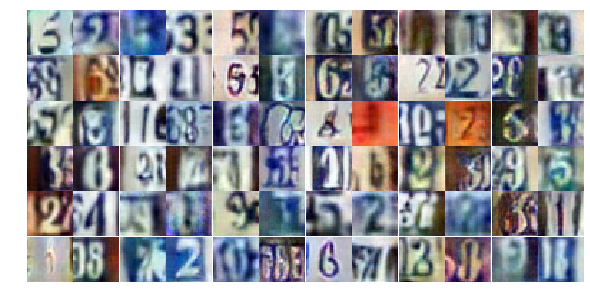

Epoch 19/25... Discriminator Loss: 0.5555... Generator Loss: 1.2034
Epoch 19/25... Discriminator Loss: 0.8298... Generator Loss: 0.8567
Epoch 19/25... Discriminator Loss: 0.7787... Generator Loss: 0.9458
Epoch 19/25... Discriminator Loss: 1.0720... Generator Loss: 0.6607
Epoch 19/25... Discriminator Loss: 0.9790... Generator Loss: 0.6745
Epoch 19/25... Discriminator Loss: 0.8787... Generator Loss: 1.0755
Epoch 19/25... Discriminator Loss: 0.6466... Generator Loss: 1.1926
Epoch 19/25... Discriminator Loss: 0.4803... Generator Loss: 1.6633
Epoch 19/25... Discriminator Loss: 0.5614... Generator Loss: 1.5134
Epoch 19/25... Discriminator Loss: 0.6397... Generator Loss: 1.1769


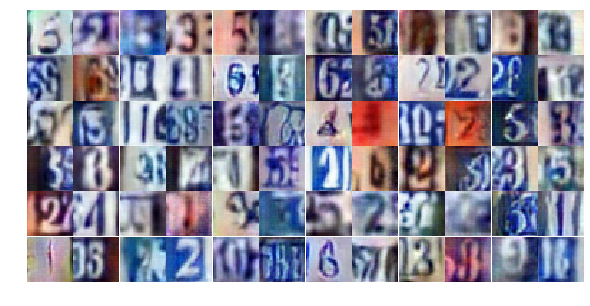

Epoch 19/25... Discriminator Loss: 0.6688... Generator Loss: 1.0643
Epoch 19/25... Discriminator Loss: 0.7981... Generator Loss: 1.2177
Epoch 19/25... Discriminator Loss: 0.9495... Generator Loss: 2.2492
Epoch 19/25... Discriminator Loss: 0.9481... Generator Loss: 0.8363
Epoch 19/25... Discriminator Loss: 0.7544... Generator Loss: 1.4760
Epoch 19/25... Discriminator Loss: 0.6347... Generator Loss: 1.2572
Epoch 19/25... Discriminator Loss: 1.0815... Generator Loss: 0.6490
Epoch 19/25... Discriminator Loss: 0.6917... Generator Loss: 1.0409
Epoch 20/25... Discriminator Loss: 1.1135... Generator Loss: 0.6217
Epoch 20/25... Discriminator Loss: 0.7405... Generator Loss: 0.9102


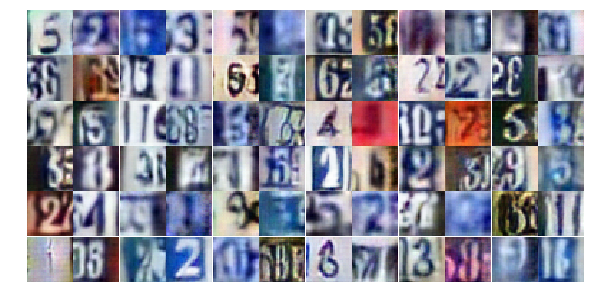

Epoch 20/25... Discriminator Loss: 0.8403... Generator Loss: 0.7825
Epoch 20/25... Discriminator Loss: 0.7825... Generator Loss: 0.8896
Epoch 20/25... Discriminator Loss: 1.5981... Generator Loss: 0.3354
Epoch 20/25... Discriminator Loss: 1.0660... Generator Loss: 0.6005
Epoch 20/25... Discriminator Loss: 0.6094... Generator Loss: 1.2481
Epoch 20/25... Discriminator Loss: 0.5697... Generator Loss: 1.4950
Epoch 20/25... Discriminator Loss: 0.8365... Generator Loss: 1.0399
Epoch 20/25... Discriminator Loss: 0.9910... Generator Loss: 0.7497
Epoch 20/25... Discriminator Loss: 1.3761... Generator Loss: 0.4045
Epoch 20/25... Discriminator Loss: 1.2298... Generator Loss: 0.4837


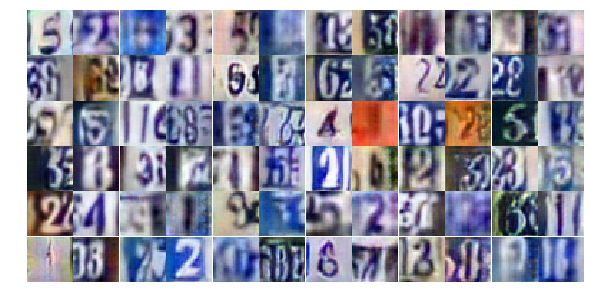

Epoch 20/25... Discriminator Loss: 1.0950... Generator Loss: 0.5865
Epoch 20/25... Discriminator Loss: 1.1181... Generator Loss: 0.6065
Epoch 20/25... Discriminator Loss: 0.7363... Generator Loss: 1.2004
Epoch 20/25... Discriminator Loss: 0.8609... Generator Loss: 1.1505
Epoch 20/25... Discriminator Loss: 0.8072... Generator Loss: 0.8604
Epoch 20/25... Discriminator Loss: 0.8953... Generator Loss: 0.8041
Epoch 20/25... Discriminator Loss: 1.0775... Generator Loss: 0.6098
Epoch 20/25... Discriminator Loss: 0.7453... Generator Loss: 0.9146
Epoch 20/25... Discriminator Loss: 0.8148... Generator Loss: 0.8797
Epoch 20/25... Discriminator Loss: 1.1075... Generator Loss: 0.5636


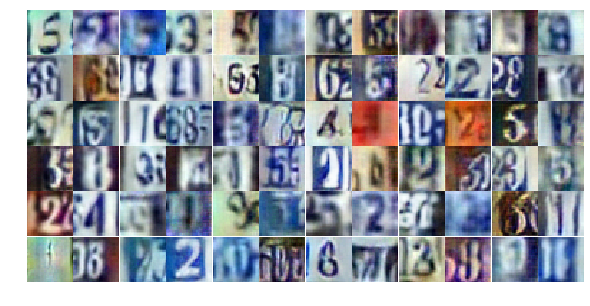

Epoch 20/25... Discriminator Loss: 0.5793... Generator Loss: 1.2639
Epoch 20/25... Discriminator Loss: 0.7142... Generator Loss: 0.9764
Epoch 20/25... Discriminator Loss: 0.3321... Generator Loss: 2.2084
Epoch 20/25... Discriminator Loss: 1.4387... Generator Loss: 0.4007
Epoch 20/25... Discriminator Loss: 1.1237... Generator Loss: 0.6009
Epoch 20/25... Discriminator Loss: 0.6728... Generator Loss: 1.1181
Epoch 20/25... Discriminator Loss: 0.6121... Generator Loss: 1.2366
Epoch 20/25... Discriminator Loss: 1.9121... Generator Loss: 0.2218
Epoch 20/25... Discriminator Loss: 1.1223... Generator Loss: 2.6320
Epoch 20/25... Discriminator Loss: 0.4996... Generator Loss: 1.5928


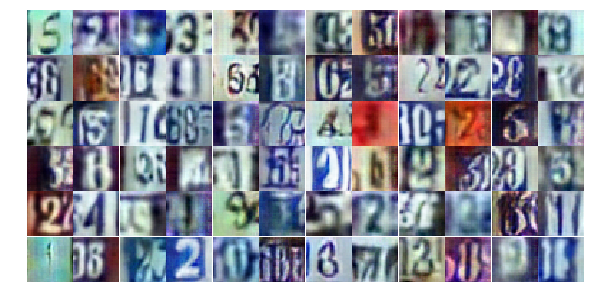

Epoch 20/25... Discriminator Loss: 0.6253... Generator Loss: 1.3983
Epoch 20/25... Discriminator Loss: 0.7308... Generator Loss: 0.9875
Epoch 20/25... Discriminator Loss: 1.7083... Generator Loss: 0.2951
Epoch 20/25... Discriminator Loss: 0.6336... Generator Loss: 1.3442
Epoch 20/25... Discriminator Loss: 1.0556... Generator Loss: 0.7475
Epoch 20/25... Discriminator Loss: 0.7161... Generator Loss: 0.9678
Epoch 20/25... Discriminator Loss: 0.8037... Generator Loss: 1.0477
Epoch 20/25... Discriminator Loss: 1.0121... Generator Loss: 0.6576
Epoch 20/25... Discriminator Loss: 0.8385... Generator Loss: 0.9084
Epoch 20/25... Discriminator Loss: 1.5794... Generator Loss: 0.3178


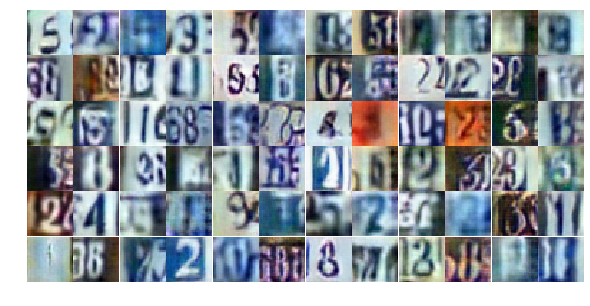

Epoch 20/25... Discriminator Loss: 2.3039... Generator Loss: 0.2022
Epoch 20/25... Discriminator Loss: 1.3857... Generator Loss: 0.4472
Epoch 20/25... Discriminator Loss: 1.0456... Generator Loss: 2.7367
Epoch 20/25... Discriminator Loss: 1.4938... Generator Loss: 0.5331
Epoch 20/25... Discriminator Loss: 1.5011... Generator Loss: 0.4084
Epoch 20/25... Discriminator Loss: 1.0663... Generator Loss: 0.6654
Epoch 20/25... Discriminator Loss: 1.0226... Generator Loss: 0.6644
Epoch 20/25... Discriminator Loss: 0.6175... Generator Loss: 1.3006
Epoch 20/25... Discriminator Loss: 0.7845... Generator Loss: 1.1989
Epoch 20/25... Discriminator Loss: 0.9897... Generator Loss: 0.6660


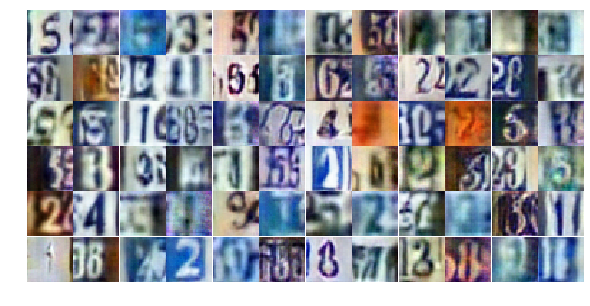

Epoch 20/25... Discriminator Loss: 0.5769... Generator Loss: 1.3357
Epoch 20/25... Discriminator Loss: 0.9410... Generator Loss: 0.7135
Epoch 20/25... Discriminator Loss: 0.5294... Generator Loss: 1.5885
Epoch 20/25... Discriminator Loss: 0.8956... Generator Loss: 0.8935
Epoch 20/25... Discriminator Loss: 0.6700... Generator Loss: 1.0442
Epoch 20/25... Discriminator Loss: 0.6719... Generator Loss: 1.0523
Epoch 21/25... Discriminator Loss: 0.9075... Generator Loss: 0.8661
Epoch 21/25... Discriminator Loss: 1.1351... Generator Loss: 0.5390
Epoch 21/25... Discriminator Loss: 1.6340... Generator Loss: 0.3172
Epoch 21/25... Discriminator Loss: 1.0856... Generator Loss: 0.6522


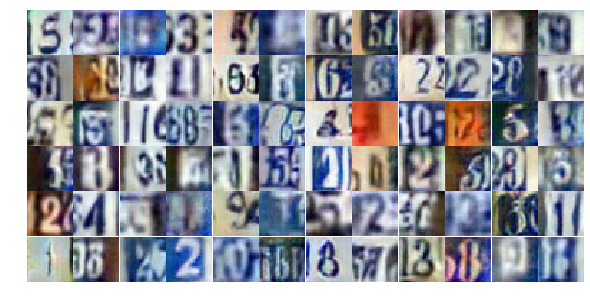

Epoch 21/25... Discriminator Loss: 0.6810... Generator Loss: 1.1111
Epoch 21/25... Discriminator Loss: 1.4380... Generator Loss: 0.4159
Epoch 21/25... Discriminator Loss: 0.4824... Generator Loss: 1.4570
Epoch 21/25... Discriminator Loss: 0.3668... Generator Loss: 1.6904
Epoch 21/25... Discriminator Loss: 0.7906... Generator Loss: 1.0694
Epoch 21/25... Discriminator Loss: 0.5020... Generator Loss: 1.3679
Epoch 21/25... Discriminator Loss: 0.7748... Generator Loss: 0.9745
Epoch 21/25... Discriminator Loss: 0.8968... Generator Loss: 1.8615
Epoch 21/25... Discriminator Loss: 0.5786... Generator Loss: 1.2111
Epoch 21/25... Discriminator Loss: 1.5129... Generator Loss: 0.3574


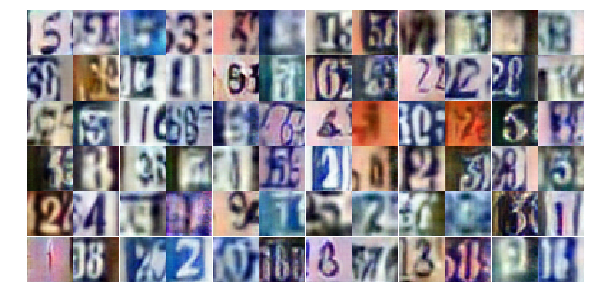

Epoch 21/25... Discriminator Loss: 0.6372... Generator Loss: 1.0526
Epoch 21/25... Discriminator Loss: 1.3061... Generator Loss: 0.4809
Epoch 21/25... Discriminator Loss: 2.2631... Generator Loss: 0.1689
Epoch 21/25... Discriminator Loss: 2.0097... Generator Loss: 0.7834
Epoch 21/25... Discriminator Loss: 0.7148... Generator Loss: 1.2983
Epoch 21/25... Discriminator Loss: 1.2346... Generator Loss: 0.5427
Epoch 21/25... Discriminator Loss: 0.8046... Generator Loss: 0.9010
Epoch 21/25... Discriminator Loss: 0.6711... Generator Loss: 1.0094
Epoch 21/25... Discriminator Loss: 0.5981... Generator Loss: 1.1268
Epoch 21/25... Discriminator Loss: 0.8299... Generator Loss: 0.8231


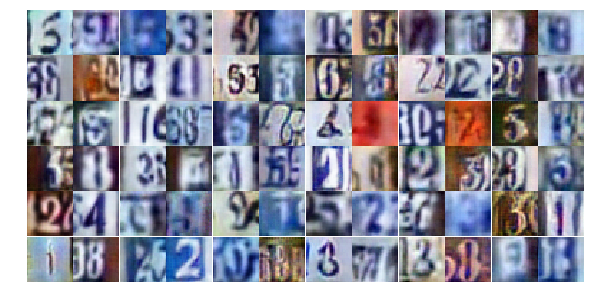

Epoch 21/25... Discriminator Loss: 1.5948... Generator Loss: 0.4013
Epoch 21/25... Discriminator Loss: 0.4913... Generator Loss: 1.3977
Epoch 21/25... Discriminator Loss: 0.9609... Generator Loss: 0.7394
Epoch 21/25... Discriminator Loss: 0.6491... Generator Loss: 1.4484
Epoch 21/25... Discriminator Loss: 0.9052... Generator Loss: 0.8031
Epoch 21/25... Discriminator Loss: 1.3046... Generator Loss: 0.4685
Epoch 21/25... Discriminator Loss: 0.6811... Generator Loss: 1.0296
Epoch 21/25... Discriminator Loss: 1.0896... Generator Loss: 0.5974
Epoch 21/25... Discriminator Loss: 1.5615... Generator Loss: 0.3597
Epoch 21/25... Discriminator Loss: 1.9013... Generator Loss: 0.2661


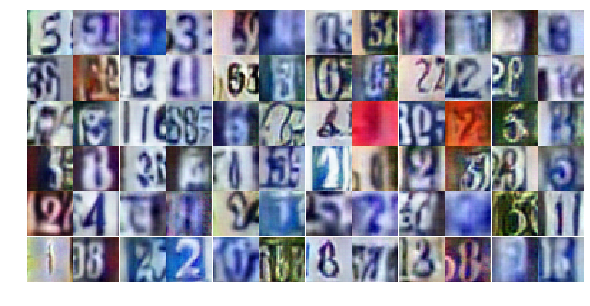

Epoch 21/25... Discriminator Loss: 1.1414... Generator Loss: 0.5204
Epoch 21/25... Discriminator Loss: 0.7542... Generator Loss: 1.0256
Epoch 21/25... Discriminator Loss: 1.4336... Generator Loss: 0.3956
Epoch 21/25... Discriminator Loss: 0.5349... Generator Loss: 1.5810
Epoch 21/25... Discriminator Loss: 0.5166... Generator Loss: 1.4562
Epoch 21/25... Discriminator Loss: 1.0070... Generator Loss: 0.6464
Epoch 21/25... Discriminator Loss: 1.1994... Generator Loss: 0.4821
Epoch 21/25... Discriminator Loss: 1.3228... Generator Loss: 0.5239
Epoch 21/25... Discriminator Loss: 1.0608... Generator Loss: 0.5636
Epoch 21/25... Discriminator Loss: 0.4311... Generator Loss: 2.3473


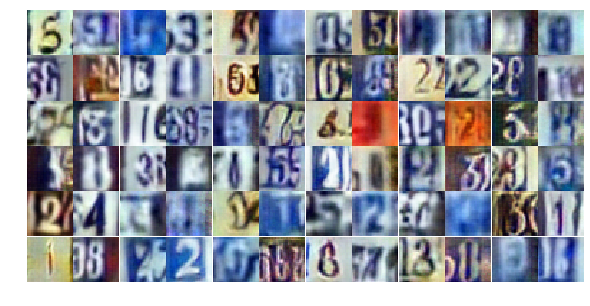

Epoch 21/25... Discriminator Loss: 1.2432... Generator Loss: 0.4703
Epoch 21/25... Discriminator Loss: 0.8915... Generator Loss: 0.7999
Epoch 21/25... Discriminator Loss: 0.7613... Generator Loss: 1.0194
Epoch 21/25... Discriminator Loss: 1.0436... Generator Loss: 0.6919
Epoch 21/25... Discriminator Loss: 0.4700... Generator Loss: 1.5320
Epoch 21/25... Discriminator Loss: 0.6309... Generator Loss: 1.2002
Epoch 21/25... Discriminator Loss: 1.2579... Generator Loss: 0.4777
Epoch 21/25... Discriminator Loss: 1.1188... Generator Loss: 0.6404
Epoch 21/25... Discriminator Loss: 1.1038... Generator Loss: 0.5620
Epoch 21/25... Discriminator Loss: 0.7999... Generator Loss: 0.8476


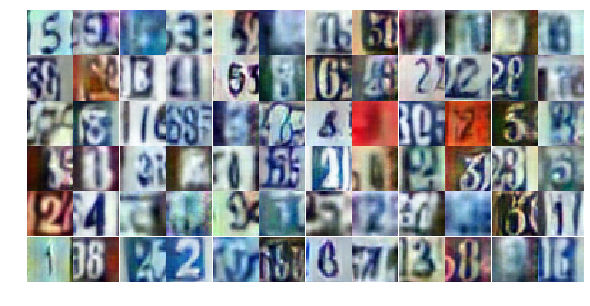

Epoch 21/25... Discriminator Loss: 0.5689... Generator Loss: 1.2432
Epoch 21/25... Discriminator Loss: 0.8752... Generator Loss: 1.0296
Epoch 21/25... Discriminator Loss: 0.5757... Generator Loss: 1.4512
Epoch 22/25... Discriminator Loss: 0.7947... Generator Loss: 1.0144
Epoch 22/25... Discriminator Loss: 0.8873... Generator Loss: 1.0302
Epoch 22/25... Discriminator Loss: 1.3064... Generator Loss: 0.4388
Epoch 22/25... Discriminator Loss: 0.6625... Generator Loss: 1.2577
Epoch 22/25... Discriminator Loss: 0.7590... Generator Loss: 0.8234
Epoch 22/25... Discriminator Loss: 1.2212... Generator Loss: 0.5469
Epoch 22/25... Discriminator Loss: 1.0132... Generator Loss: 0.9201


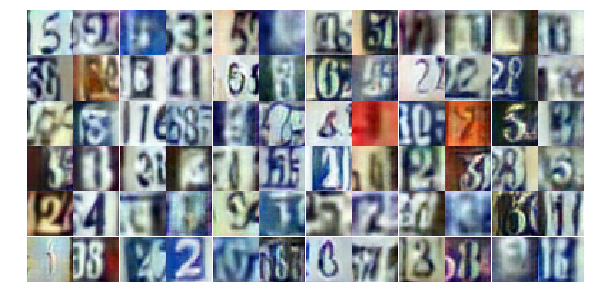

Epoch 22/25... Discriminator Loss: 0.6084... Generator Loss: 1.6766
Epoch 22/25... Discriminator Loss: 0.7450... Generator Loss: 1.1895
Epoch 22/25... Discriminator Loss: 1.7889... Generator Loss: 0.3251
Epoch 22/25... Discriminator Loss: 0.9916... Generator Loss: 0.6739
Epoch 22/25... Discriminator Loss: 0.8822... Generator Loss: 0.8699
Epoch 22/25... Discriminator Loss: 0.9016... Generator Loss: 2.6461
Epoch 22/25... Discriminator Loss: 0.9229... Generator Loss: 0.7222
Epoch 22/25... Discriminator Loss: 1.1289... Generator Loss: 0.6037
Epoch 22/25... Discriminator Loss: 1.9037... Generator Loss: 0.2570
Epoch 22/25... Discriminator Loss: 2.0916... Generator Loss: 0.2291


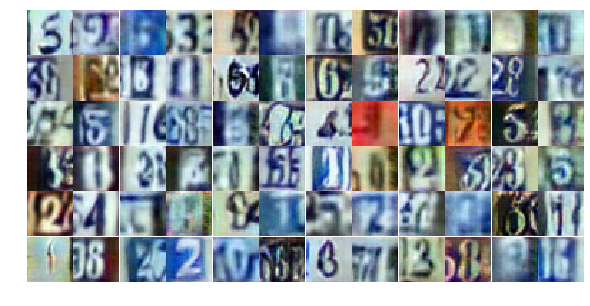

Epoch 22/25... Discriminator Loss: 0.5548... Generator Loss: 1.5302
Epoch 22/25... Discriminator Loss: 0.8124... Generator Loss: 0.8703
Epoch 22/25... Discriminator Loss: 0.7947... Generator Loss: 0.8721
Epoch 22/25... Discriminator Loss: 0.4619... Generator Loss: 1.5777
Epoch 22/25... Discriminator Loss: 0.5142... Generator Loss: 1.5193
Epoch 22/25... Discriminator Loss: 0.9254... Generator Loss: 0.7865
Epoch 22/25... Discriminator Loss: 0.5686... Generator Loss: 1.3698
Epoch 22/25... Discriminator Loss: 0.4550... Generator Loss: 1.5659
Epoch 22/25... Discriminator Loss: 0.5702... Generator Loss: 1.5223
Epoch 22/25... Discriminator Loss: 1.5504... Generator Loss: 0.3541


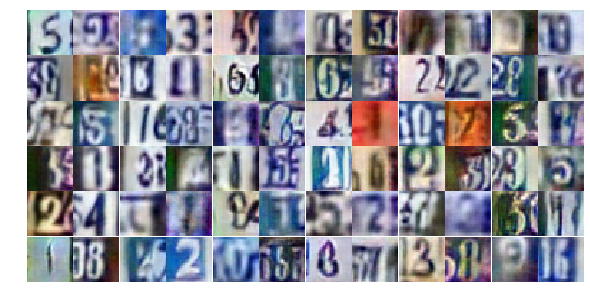

Epoch 22/25... Discriminator Loss: 0.5048... Generator Loss: 1.3786
Epoch 22/25... Discriminator Loss: 0.5873... Generator Loss: 1.2410
Epoch 22/25... Discriminator Loss: 0.8945... Generator Loss: 0.7913
Epoch 22/25... Discriminator Loss: 1.1410... Generator Loss: 0.5965
Epoch 22/25... Discriminator Loss: 0.9429... Generator Loss: 0.8583
Epoch 22/25... Discriminator Loss: 0.7661... Generator Loss: 0.9329
Epoch 22/25... Discriminator Loss: 1.6535... Generator Loss: 0.3113
Epoch 22/25... Discriminator Loss: 0.6985... Generator Loss: 1.6150
Epoch 22/25... Discriminator Loss: 1.0757... Generator Loss: 0.6276
Epoch 22/25... Discriminator Loss: 1.6571... Generator Loss: 0.3786


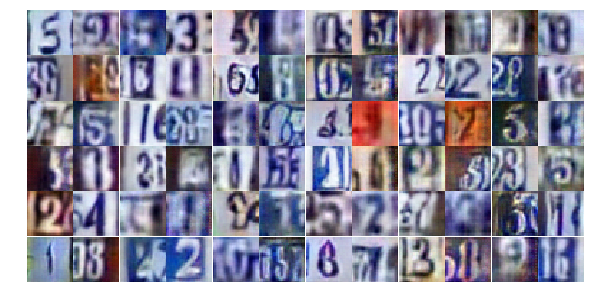

Epoch 22/25... Discriminator Loss: 0.7078... Generator Loss: 1.1658
Epoch 22/25... Discriminator Loss: 0.7016... Generator Loss: 1.0719
Epoch 22/25... Discriminator Loss: 0.4235... Generator Loss: 1.5074
Epoch 22/25... Discriminator Loss: 0.9662... Generator Loss: 0.7432
Epoch 22/25... Discriminator Loss: 0.6309... Generator Loss: 1.0273
Epoch 22/25... Discriminator Loss: 0.4408... Generator Loss: 1.5491
Epoch 22/25... Discriminator Loss: 0.7102... Generator Loss: 1.0180
Epoch 22/25... Discriminator Loss: 1.5316... Generator Loss: 0.3846
Epoch 22/25... Discriminator Loss: 0.9332... Generator Loss: 0.8403
Epoch 22/25... Discriminator Loss: 0.7149... Generator Loss: 1.0881


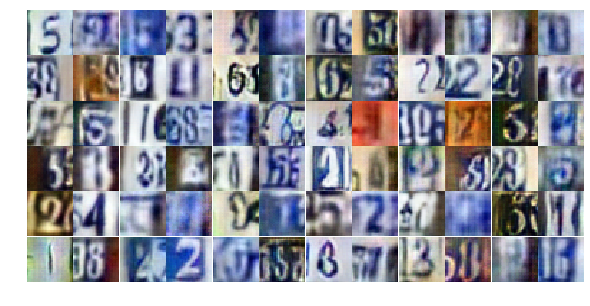

Epoch 22/25... Discriminator Loss: 1.4358... Generator Loss: 0.3890
Epoch 22/25... Discriminator Loss: 0.6244... Generator Loss: 1.1303
Epoch 22/25... Discriminator Loss: 1.0366... Generator Loss: 0.6022
Epoch 22/25... Discriminator Loss: 0.7566... Generator Loss: 1.0991
Epoch 22/25... Discriminator Loss: 1.3478... Generator Loss: 0.4532
Epoch 22/25... Discriminator Loss: 0.9574... Generator Loss: 0.7919
Epoch 22/25... Discriminator Loss: 1.0750... Generator Loss: 0.6791
Epoch 22/25... Discriminator Loss: 0.8170... Generator Loss: 0.7931
Epoch 22/25... Discriminator Loss: 1.1164... Generator Loss: 0.7238
Epoch 22/25... Discriminator Loss: 0.6065... Generator Loss: 1.1020


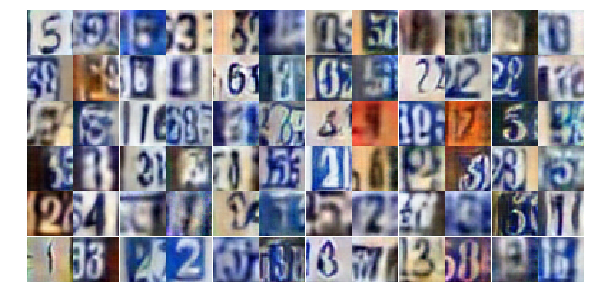

Epoch 23/25... Discriminator Loss: 0.6449... Generator Loss: 1.3899
Epoch 23/25... Discriminator Loss: 0.4333... Generator Loss: 1.6853
Epoch 23/25... Discriminator Loss: 1.7529... Generator Loss: 0.2723
Epoch 23/25... Discriminator Loss: 0.7364... Generator Loss: 0.9866
Epoch 23/25... Discriminator Loss: 0.8550... Generator Loss: 0.8145
Epoch 23/25... Discriminator Loss: 1.2173... Generator Loss: 0.6052
Epoch 23/25... Discriminator Loss: 0.9932... Generator Loss: 0.7978
Epoch 23/25... Discriminator Loss: 0.8535... Generator Loss: 0.8139
Epoch 23/25... Discriminator Loss: 0.9136... Generator Loss: 0.7673
Epoch 23/25... Discriminator Loss: 0.4185... Generator Loss: 1.5767


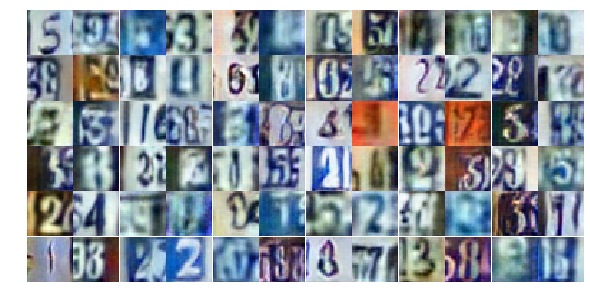

Epoch 23/25... Discriminator Loss: 0.7403... Generator Loss: 0.9545
Epoch 23/25... Discriminator Loss: 0.5629... Generator Loss: 1.3034
Epoch 23/25... Discriminator Loss: 0.9061... Generator Loss: 0.7069
Epoch 23/25... Discriminator Loss: 0.7208... Generator Loss: 1.0658
Epoch 23/25... Discriminator Loss: 0.4816... Generator Loss: 1.4729
Epoch 23/25... Discriminator Loss: 1.0402... Generator Loss: 0.7640
Epoch 23/25... Discriminator Loss: 0.7853... Generator Loss: 1.1731
Epoch 23/25... Discriminator Loss: 0.7595... Generator Loss: 1.9830
Epoch 23/25... Discriminator Loss: 0.7518... Generator Loss: 1.0373
Epoch 23/25... Discriminator Loss: 0.7887... Generator Loss: 0.8726


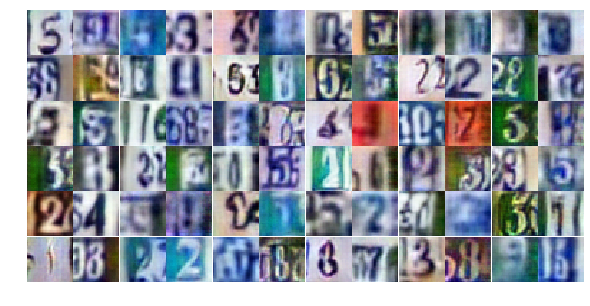

Epoch 23/25... Discriminator Loss: 1.6204... Generator Loss: 0.3578
Epoch 23/25... Discriminator Loss: 0.6526... Generator Loss: 1.3066
Epoch 23/25... Discriminator Loss: 1.1594... Generator Loss: 0.5296
Epoch 23/25... Discriminator Loss: 0.7768... Generator Loss: 0.8845
Epoch 23/25... Discriminator Loss: 0.5519... Generator Loss: 1.5614
Epoch 23/25... Discriminator Loss: 0.4582... Generator Loss: 1.9371
Epoch 23/25... Discriminator Loss: 0.8995... Generator Loss: 0.7357
Epoch 23/25... Discriminator Loss: 1.5188... Generator Loss: 0.3551
Epoch 23/25... Discriminator Loss: 0.5993... Generator Loss: 1.1931
Epoch 23/25... Discriminator Loss: 0.7850... Generator Loss: 1.2923


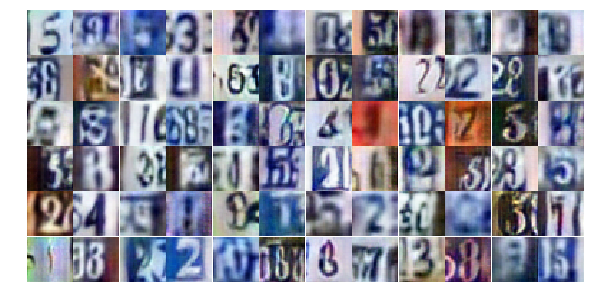

Epoch 23/25... Discriminator Loss: 0.5388... Generator Loss: 2.7649
Epoch 23/25... Discriminator Loss: 0.6828... Generator Loss: 1.0547
Epoch 23/25... Discriminator Loss: 0.8050... Generator Loss: 0.8870
Epoch 23/25... Discriminator Loss: 1.0565... Generator Loss: 0.6554
Epoch 23/25... Discriminator Loss: 1.3556... Generator Loss: 2.9020
Epoch 23/25... Discriminator Loss: 1.1431... Generator Loss: 0.5795
Epoch 23/25... Discriminator Loss: 0.9085... Generator Loss: 0.7875
Epoch 23/25... Discriminator Loss: 0.8934... Generator Loss: 0.7290
Epoch 23/25... Discriminator Loss: 0.5789... Generator Loss: 1.2216
Epoch 23/25... Discriminator Loss: 0.5409... Generator Loss: 1.2432


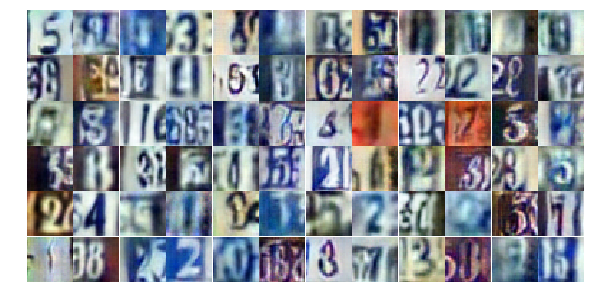

Epoch 23/25... Discriminator Loss: 1.3180... Generator Loss: 0.5036
Epoch 23/25... Discriminator Loss: 0.5734... Generator Loss: 1.3069
Epoch 23/25... Discriminator Loss: 0.7053... Generator Loss: 2.1991
Epoch 23/25... Discriminator Loss: 0.9200... Generator Loss: 0.8636
Epoch 23/25... Discriminator Loss: 1.4884... Generator Loss: 0.3756
Epoch 23/25... Discriminator Loss: 0.8070... Generator Loss: 0.8503
Epoch 23/25... Discriminator Loss: 0.6155... Generator Loss: 1.0996
Epoch 23/25... Discriminator Loss: 1.1574... Generator Loss: 0.5792
Epoch 23/25... Discriminator Loss: 0.7944... Generator Loss: 0.9246
Epoch 23/25... Discriminator Loss: 1.2092... Generator Loss: 0.5713


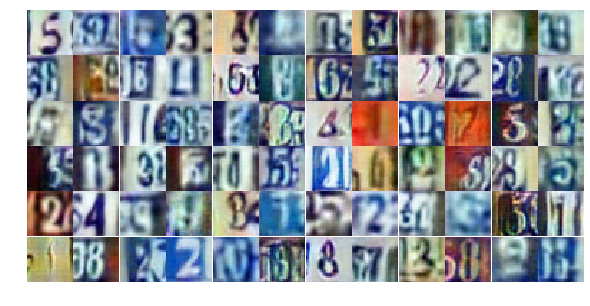

Epoch 23/25... Discriminator Loss: 0.9457... Generator Loss: 0.7569
Epoch 23/25... Discriminator Loss: 1.0858... Generator Loss: 0.5610
Epoch 23/25... Discriminator Loss: 2.9503... Generator Loss: 0.9064
Epoch 23/25... Discriminator Loss: 0.4576... Generator Loss: 1.4144
Epoch 23/25... Discriminator Loss: 1.7238... Generator Loss: 0.3289
Epoch 23/25... Discriminator Loss: 1.2191... Generator Loss: 0.5619
Epoch 23/25... Discriminator Loss: 1.0410... Generator Loss: 0.5934
Epoch 24/25... Discriminator Loss: 0.9292... Generator Loss: 0.7908
Epoch 24/25... Discriminator Loss: 1.1134... Generator Loss: 0.5584
Epoch 24/25... Discriminator Loss: 0.9230... Generator Loss: 0.8309


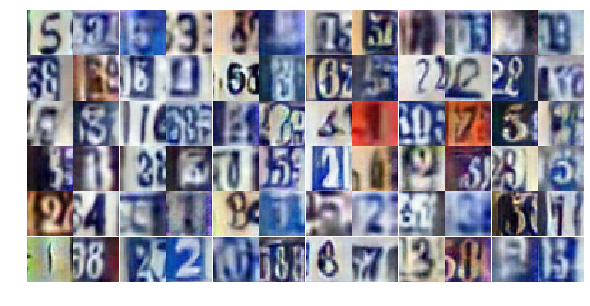

Epoch 24/25... Discriminator Loss: 0.7919... Generator Loss: 1.8360
Epoch 24/25... Discriminator Loss: 0.5927... Generator Loss: 1.0800
Epoch 24/25... Discriminator Loss: 0.7189... Generator Loss: 1.0192
Epoch 24/25... Discriminator Loss: 0.8877... Generator Loss: 1.0571
Epoch 24/25... Discriminator Loss: 0.8839... Generator Loss: 0.7478
Epoch 24/25... Discriminator Loss: 0.8386... Generator Loss: 0.9013
Epoch 24/25... Discriminator Loss: 0.5746... Generator Loss: 1.7588
Epoch 24/25... Discriminator Loss: 1.3272... Generator Loss: 0.4194
Epoch 24/25... Discriminator Loss: 0.6868... Generator Loss: 0.9439
Epoch 24/25... Discriminator Loss: 0.3520... Generator Loss: 1.8579


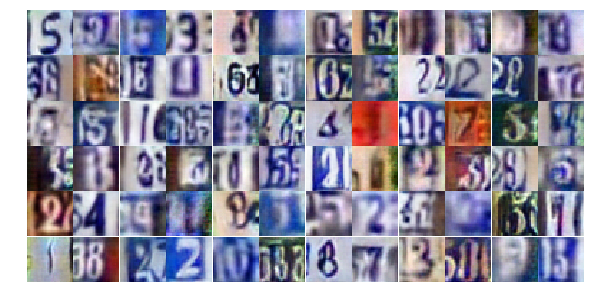

Epoch 24/25... Discriminator Loss: 1.1633... Generator Loss: 0.5080
Epoch 24/25... Discriminator Loss: 1.3106... Generator Loss: 0.4721
Epoch 24/25... Discriminator Loss: 1.6464... Generator Loss: 0.3280
Epoch 24/25... Discriminator Loss: 0.6347... Generator Loss: 1.0136
Epoch 24/25... Discriminator Loss: 0.9638... Generator Loss: 2.8917
Epoch 24/25... Discriminator Loss: 0.9050... Generator Loss: 0.7572
Epoch 24/25... Discriminator Loss: 0.8506... Generator Loss: 0.7723
Epoch 24/25... Discriminator Loss: 0.8215... Generator Loss: 1.2913
Epoch 24/25... Discriminator Loss: 1.6566... Generator Loss: 0.3178
Epoch 24/25... Discriminator Loss: 0.9429... Generator Loss: 0.6917


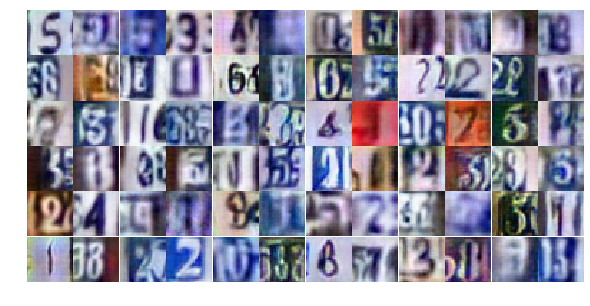

Epoch 24/25... Discriminator Loss: 0.9118... Generator Loss: 0.7711
Epoch 24/25... Discriminator Loss: 0.5669... Generator Loss: 1.3861
Epoch 24/25... Discriminator Loss: 0.7584... Generator Loss: 0.8414
Epoch 24/25... Discriminator Loss: 1.4725... Generator Loss: 0.4289
Epoch 24/25... Discriminator Loss: 0.7331... Generator Loss: 0.8642
Epoch 24/25... Discriminator Loss: 0.5529... Generator Loss: 1.3560
Epoch 24/25... Discriminator Loss: 0.5300... Generator Loss: 1.2356
Epoch 24/25... Discriminator Loss: 0.6071... Generator Loss: 1.2424
Epoch 24/25... Discriminator Loss: 0.9554... Generator Loss: 0.9143
Epoch 24/25... Discriminator Loss: 1.1154... Generator Loss: 0.6398


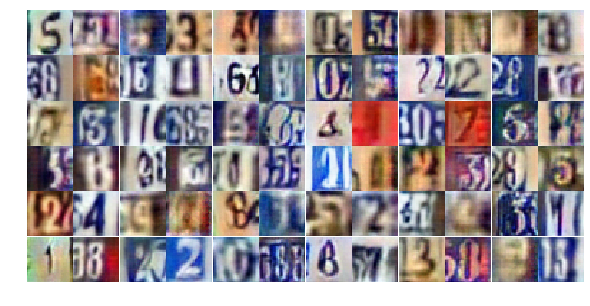

Epoch 24/25... Discriminator Loss: 0.9414... Generator Loss: 0.6738
Epoch 24/25... Discriminator Loss: 0.7903... Generator Loss: 0.9010
Epoch 24/25... Discriminator Loss: 1.5817... Generator Loss: 0.7835
Epoch 24/25... Discriminator Loss: 1.0159... Generator Loss: 0.6540
Epoch 24/25... Discriminator Loss: 0.8934... Generator Loss: 1.8187
Epoch 24/25... Discriminator Loss: 0.7240... Generator Loss: 1.0597
Epoch 24/25... Discriminator Loss: 0.9507... Generator Loss: 0.6671
Epoch 24/25... Discriminator Loss: 0.7907... Generator Loss: 0.9732
Epoch 24/25... Discriminator Loss: 0.8480... Generator Loss: 0.8264
Epoch 24/25... Discriminator Loss: 0.8313... Generator Loss: 2.4834


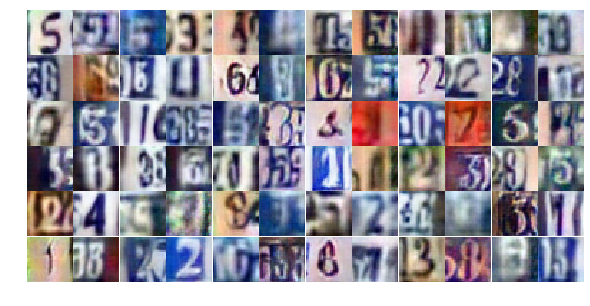

Epoch 24/25... Discriminator Loss: 0.8595... Generator Loss: 0.8146
Epoch 24/25... Discriminator Loss: 1.6333... Generator Loss: 0.3764
Epoch 24/25... Discriminator Loss: 1.3137... Generator Loss: 0.4429
Epoch 24/25... Discriminator Loss: 1.2402... Generator Loss: 0.4864
Epoch 24/25... Discriminator Loss: 2.1137... Generator Loss: 0.2245
Epoch 24/25... Discriminator Loss: 0.7337... Generator Loss: 1.0102
Epoch 24/25... Discriminator Loss: 0.9281... Generator Loss: 0.7138
Epoch 24/25... Discriminator Loss: 0.6148... Generator Loss: 1.1538
Epoch 24/25... Discriminator Loss: 0.9702... Generator Loss: 0.7442
Epoch 24/25... Discriminator Loss: 1.0693... Generator Loss: 2.2435


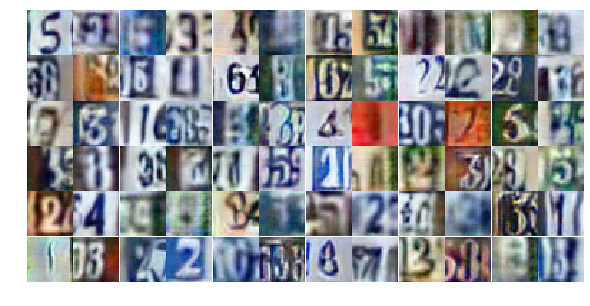

Epoch 24/25... Discriminator Loss: 0.8845... Generator Loss: 1.4714
Epoch 24/25... Discriminator Loss: 1.1363... Generator Loss: 0.6048
Epoch 24/25... Discriminator Loss: 1.0394... Generator Loss: 0.6546
Epoch 24/25... Discriminator Loss: 0.9910... Generator Loss: 0.7179
Epoch 24/25... Discriminator Loss: 1.2708... Generator Loss: 0.4920
Epoch 25/25... Discriminator Loss: 0.9394... Generator Loss: 0.7278
Epoch 25/25... Discriminator Loss: 0.5376... Generator Loss: 1.3345
Epoch 25/25... Discriminator Loss: 0.7112... Generator Loss: 0.9803
Epoch 25/25... Discriminator Loss: 1.2245... Generator Loss: 0.5125
Epoch 25/25... Discriminator Loss: 0.6988... Generator Loss: 1.0724


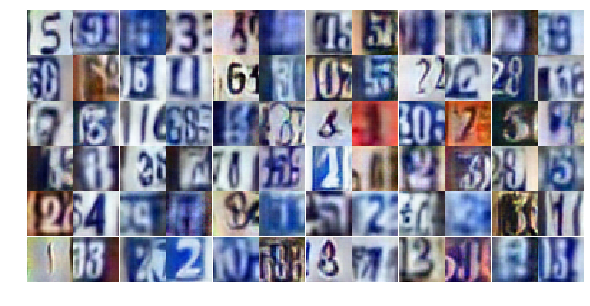

Epoch 25/25... Discriminator Loss: 0.9928... Generator Loss: 0.6769
Epoch 25/25... Discriminator Loss: 0.8528... Generator Loss: 0.9023
Epoch 25/25... Discriminator Loss: 0.9182... Generator Loss: 0.7830
Epoch 25/25... Discriminator Loss: 1.7682... Generator Loss: 0.3394
Epoch 25/25... Discriminator Loss: 1.1516... Generator Loss: 2.2362
Epoch 25/25... Discriminator Loss: 1.5257... Generator Loss: 0.3870
Epoch 25/25... Discriminator Loss: 0.5770... Generator Loss: 1.1924
Epoch 25/25... Discriminator Loss: 0.6984... Generator Loss: 1.1335
Epoch 25/25... Discriminator Loss: 0.4522... Generator Loss: 1.4998
Epoch 25/25... Discriminator Loss: 1.1528... Generator Loss: 0.6208


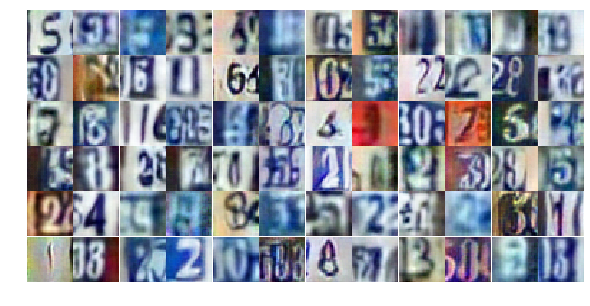

Epoch 25/25... Discriminator Loss: 1.0896... Generator Loss: 0.7142
Epoch 25/25... Discriminator Loss: 0.7381... Generator Loss: 2.8123
Epoch 25/25... Discriminator Loss: 1.5435... Generator Loss: 0.3959
Epoch 25/25... Discriminator Loss: 1.0052... Generator Loss: 0.6776
Epoch 25/25... Discriminator Loss: 0.8605... Generator Loss: 0.8975
Epoch 25/25... Discriminator Loss: 0.8419... Generator Loss: 0.8612
Epoch 25/25... Discriminator Loss: 1.2203... Generator Loss: 0.5630
Epoch 25/25... Discriminator Loss: 0.8725... Generator Loss: 1.3342
Epoch 25/25... Discriminator Loss: 0.9608... Generator Loss: 0.6973
Epoch 25/25... Discriminator Loss: 0.9282... Generator Loss: 0.7547


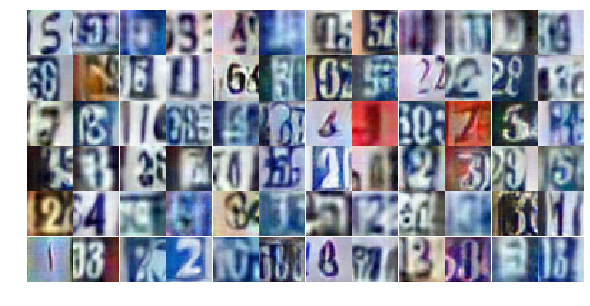

Epoch 25/25... Discriminator Loss: 0.8251... Generator Loss: 0.8090
Epoch 25/25... Discriminator Loss: 0.7701... Generator Loss: 0.8755
Epoch 25/25... Discriminator Loss: 1.3239... Generator Loss: 0.5569
Epoch 25/25... Discriminator Loss: 0.5341... Generator Loss: 1.5639
Epoch 25/25... Discriminator Loss: 1.1744... Generator Loss: 0.5729
Epoch 25/25... Discriminator Loss: 0.5114... Generator Loss: 1.3219
Epoch 25/25... Discriminator Loss: 0.8786... Generator Loss: 0.8660
Epoch 25/25... Discriminator Loss: 0.9082... Generator Loss: 0.7677
Epoch 25/25... Discriminator Loss: 0.6951... Generator Loss: 2.0922
Epoch 25/25... Discriminator Loss: 0.8335... Generator Loss: 0.8901


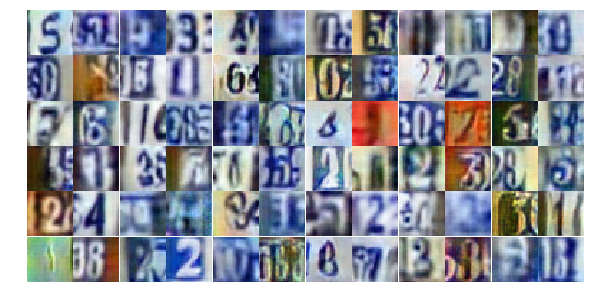

Epoch 25/25... Discriminator Loss: 0.6830... Generator Loss: 1.4791
Epoch 25/25... Discriminator Loss: 0.6419... Generator Loss: 1.1356
Epoch 25/25... Discriminator Loss: 1.0486... Generator Loss: 0.7108
Epoch 25/25... Discriminator Loss: 0.6074... Generator Loss: 1.0542
Epoch 25/25... Discriminator Loss: 1.0393... Generator Loss: 0.7238
Epoch 25/25... Discriminator Loss: 1.0875... Generator Loss: 0.6422
Epoch 25/25... Discriminator Loss: 0.5679... Generator Loss: 1.1797
Epoch 25/25... Discriminator Loss: 0.9004... Generator Loss: 0.7845
Epoch 25/25... Discriminator Loss: 1.6975... Generator Loss: 0.4022
Epoch 25/25... Discriminator Loss: 0.5533... Generator Loss: 1.7036


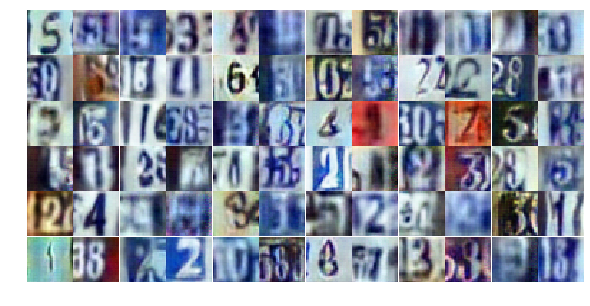

Epoch 25/25... Discriminator Loss: 0.7481... Generator Loss: 1.0320
Epoch 25/25... Discriminator Loss: 1.0036... Generator Loss: 0.7370
Epoch 25/25... Discriminator Loss: 0.9702... Generator Loss: 2.3892
Epoch 25/25... Discriminator Loss: 1.2266... Generator Loss: 0.5483
Epoch 25/25... Discriminator Loss: 1.3055... Generator Loss: 0.4652
Epoch 25/25... Discriminator Loss: 0.6981... Generator Loss: 0.9808
Epoch 25/25... Discriminator Loss: 1.8173... Generator Loss: 0.2567
Epoch 25/25... Discriminator Loss: 1.0711... Generator Loss: 0.6650
Epoch 25/25... Discriminator Loss: 1.0181... Generator Loss: 0.6700
Epoch 25/25... Discriminator Loss: 1.4577... Generator Loss: 0.4284


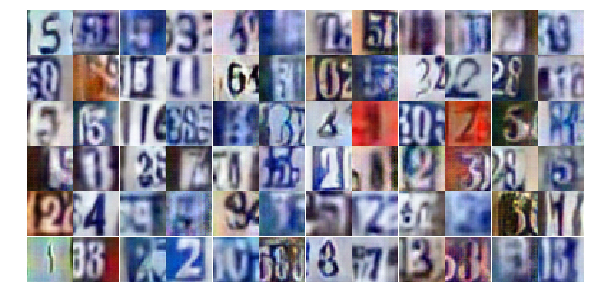

Epoch 25/25... Discriminator Loss: 0.5867... Generator Loss: 1.4424
Epoch 25/25... Discriminator Loss: 1.4100... Generator Loss: 0.5714


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

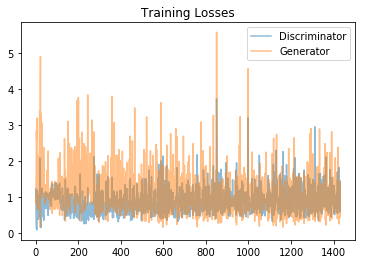

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/home/skywalker/.virtualenvs/py3ml/lib/python3.6/site-packages/matplotlib/axes/_base.py:1324: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


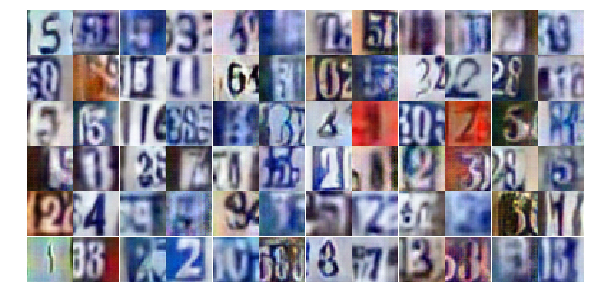

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))